In [2]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from warnings import filterwarnings
filterwarnings('ignore')

In [3]:
print('Numpy Version',np.__version__)
print('Pandas Version',pd.__version__)
print('Seaborn Version',sns.__version__)
print('Matplotlib Version',matplotlib.__version__)

Numpy Version 1.24.4
Pandas Version 1.4.4
Seaborn Version 0.13.0
Matplotlib Version 3.5.2


## Reading dataset - Preliminary info

In [4]:
inscost=pd.read_csv('Data.csv')

In [5]:
pd.options.display.max_columns = None

In [6]:
inscost.head()

,applicant_id,years_of_insurance_with_us,regular_checkup_lasy_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Year_last_admitted,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,5000,3,1,1,Salried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,NaN,Chennai,67,N,Rare,Moderate,1,25,20978
1,5001,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,NaN,Jaipur,58,N,Rare,Moderate,3,27,6170
2,5002,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,NaN,Jaipur,73,N,Daily,Extreme,0,32,28382
3,5003,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,NaN,Chennai,71,Y,Rare,No,3,37,27148
4,5004,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,2004.0,Bangalore,74,N,No,Extreme,0,34,29616


In [7]:
inscost.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 24 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   applicant_id                    25000 non-null  int64  
 1   years_of_insurance_with_us      25000 non-null  int64  
 2   regular_checkup_lasy_year       25000 non-null  int64  
 3   adventure_sports                25000 non-null  int64  
 4   Occupation                      25000 non-null  object 
 5   visited_doctor_last_1_year      25000 non-null  int64  
 6   cholesterol_level               25000 non-null  object 
 7   daily_avg_steps                 25000 non-null  int64  
 8   age                             25000 non-null  int64  
 9   heart_decs_history              25000 non-null  int64  
 10  other_major_decs_history        25000 non-null  int64  
 11  Gender                          25000 non-null  object 
 12  avg_glucose_level               

In [8]:
inscost.rename(columns={'regular_checkup_lasy_year':'regular_checkup_last_year'},inplace=True)

In [9]:
inscost.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
applicant_id,25000.0,17499.50,7217.02,5000.0,11249.75,17499.5,23749.25,29999.0
years_of_insurance_with_us,25000.0,4.09,2.61,0.0,2.00,4.0,6.00,8.0
regular_checkup_last_year,25000.0,0.77,1.20,0.0,0.00,0.0,1.00,5.0
adventure_sports,25000.0,0.08,0.27,0.0,0.00,0.0,0.00,1.0
visited_doctor_last_1_year,25000.0,3.10,1.14,0.0,2.00,3.0,4.00,12.0
daily_avg_steps,25000.0,5215.89,1053.18,2034.0,4543.00,5089.0,5730.00,11255.0
age,25000.0,44.92,16.11,16.0,31.00,45.0,59.00,74.0
heart_decs_history,25000.0,0.05,0.23,0.0,0.00,0.0,0.00,1.0
other_major_decs_history,25000.0,0.10,0.30,0.0,0.00,0.0,0.00,1.0
avg_glucose_level,25000.0,167.53,62.73,57.0,113.00,168.0,222.00,277.0


In [429]:
inscost.describe(include='object').T

,count,unique,top,freq
Occupation,25000,3,Student,10169
cholesterol_level,25000,5,150 to 175,8763
Gender,25000,2,Male,16422
smoking_status,25000,4,never smoked,9249
Location,25000,15,Bangalore,1742
covered_by_any_other_company,25000,2,N,17418
Alcohol,25000,3,Rare,13752
exercise,25000,3,Moderate,14638


In [11]:
inscost.shape

(25000, 24)

In [12]:
inscost.skew()

applicant_id                      0.000000
years_of_insurance_with_us       -0.075217
regular_checkup_last_year         1.610907
adventure_sports                  3.054017
visited_doctor_last_1_year        0.978456
daily_avg_steps                   0.908867
age                               0.013860
heart_decs_history                3.919343
other_major_decs_history          2.701327
avg_glucose_level                -0.006389
bmi                               1.056428
Year_last_admitted                0.013532
weight                            0.109077
weight_change_in_last_one_year    0.068026
fat_percentage                   -0.363262
insurance_cost                    0.331650
dtype: float64

In [13]:
inscost.duplicated().value_counts()

False    25000
dtype: int64

## Missing Value Treatment

### Identification and significance evaluation

In [14]:
## Missing Value Check
inscost.isna().sum()

applicant_id                          0
years_of_insurance_with_us            0
regular_checkup_last_year             0
adventure_sports                      0
Occupation                            0
visited_doctor_last_1_year            0
cholesterol_level                     0
daily_avg_steps                       0
age                                   0
heart_decs_history                    0
other_major_decs_history              0
Gender                                0
avg_glucose_level                     0
bmi                                 990
smoking_status                        0
Year_last_admitted                11881
Location                              0
weight                                0
covered_by_any_other_company          0
Alcohol                               0
exercise                              0
weight_change_in_last_one_year        0
fat_percentage                        0
insurance_cost                        0
dtype: int64

In [15]:
# Identifying fields with missing values
inscost_null=inscost.isna().sum()
inscost_null[inscost_null.values > 0].sort_values(ascending=False)

Year_last_admitted    11881
bmi                     990
dtype: int64

In [16]:
#Determining the percentage of missing values
(11881/25000)*100

47.524

In [17]:
(990/25000)*100

3.9600000000000004

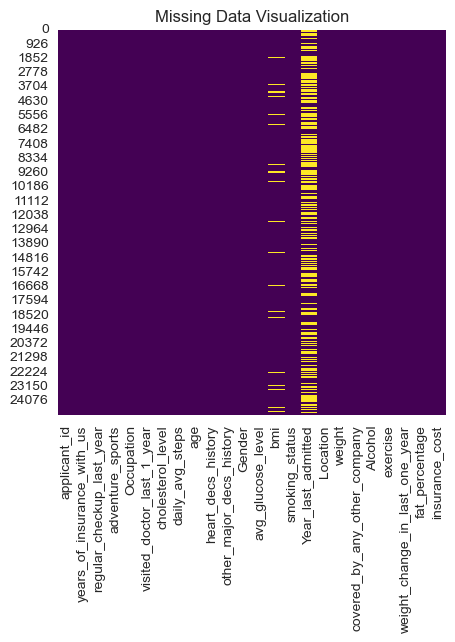

In [322]:
plt.figure(figsize=(5,5))
sns.heatmap(inscost.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Data Visualization')
plt.show()

Observations:
- bmi and Year_last_admitted field have missing values
- Year_last_has about 47.5% missing values
- bmi has 3.96% missing values

In [19]:
# Data description before handling missing values
inscost.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
applicant_id,25000.0,17499.50,7217.02,5000.0,11249.75,17499.5,23749.25,29999.0
years_of_insurance_with_us,25000.0,4.09,2.61,0.0,2.00,4.0,6.00,8.0
regular_checkup_last_year,25000.0,0.77,1.20,0.0,0.00,0.0,1.00,5.0
adventure_sports,25000.0,0.08,0.27,0.0,0.00,0.0,0.00,1.0
visited_doctor_last_1_year,25000.0,3.10,1.14,0.0,2.00,3.0,4.00,12.0
daily_avg_steps,25000.0,5215.89,1053.18,2034.0,4543.00,5089.0,5730.00,11255.0
age,25000.0,44.92,16.11,16.0,31.00,45.0,59.00,74.0
heart_decs_history,25000.0,0.05,0.23,0.0,0.00,0.0,0.00,1.0
other_major_decs_history,25000.0,0.10,0.30,0.0,0.00,0.0,0.00,1.0
avg_glucose_level,25000.0,167.53,62.73,57.0,113.00,168.0,222.00,277.0


In [20]:
inscost.describe(include='object').T

,count,unique,top,freq
Occupation,25000,3,Student,10169
cholesterol_level,25000,5,150 to 175,8763
Gender,25000,2,Male,16422
smoking_status,25000,4,never smoked,9249
Location,25000,15,Bangalore,1742
covered_by_any_other_company,25000,2,N,17418
Alcohol,25000,3,Rare,13752
exercise,25000,3,Moderate,14638


In [21]:
inscost.shape

(25000, 24)

In [325]:
inscost.insurance_cost.nunique()

54

In [22]:
# Analyzing target variable
inscost.insurance_cost.describe()

count    25000.000000
mean     27147.407680
std      14323.691832
min       2468.000000
25%      16042.000000
50%      27148.000000
75%      37020.000000
max      67870.000000
Name: insurance_cost, dtype: float64

<AxesSubplot:xlabel='insurance_cost'>

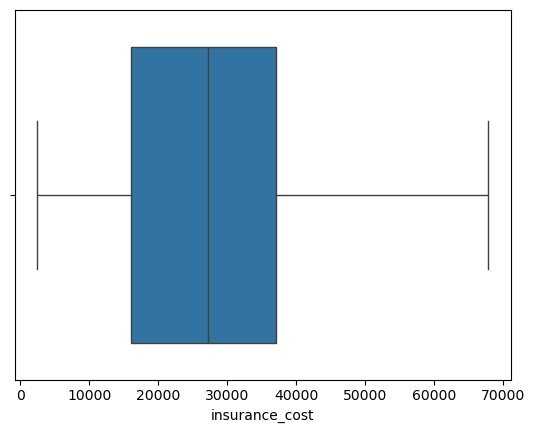

In [23]:
sns.boxplot(x=inscost.insurance_cost)

<AxesSubplot:ylabel='Density'>

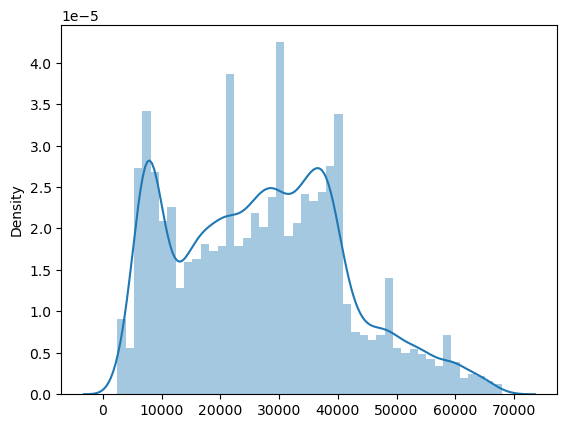

In [24]:
sns.distplot(x=inscost.insurance_cost)

Observations:
- The target variable here is insurance_cost
- It has 54 unique values, ranging from 2468 to 67870 with a median value of 27140

Text(0.5, 1.0, 'Boxplot of insurance cost where Year_last_admitted is not null')

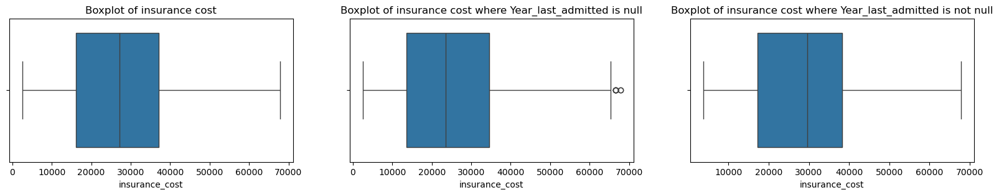

In [25]:
#Comparing target variable with and without 
fig,axes=plt.subplots(ncols=3,figsize=(20,3))
sns.boxplot(x=inscost['insurance_cost'],ax=axes[0])
axes[0].set_title('Boxplot of insurance cost')
sns.boxplot(x=inscost[inscost['Year_last_admitted'].isnull()==True].insurance_cost,ax=axes[1])
axes[1].set_title('Boxplot of insurance cost where Year_last_admitted is null')
sns.boxplot(x=inscost[inscost['Year_last_admitted'].isnull()==False].insurance_cost,ax=axes[2])
axes[2].set_title('Boxplot of insurance cost where Year_last_admitted is not null')

In [26]:
inscost[inscost['Year_last_admitted'].isnull()==True].insurance_cost.describe().round(2).T

count    11881.00
mean     24677.20
std      13622.31
min       2468.00
25%      13574.00
50%      23446.00
75%      34552.00
max      67870.00
Name: insurance_cost, dtype: float64

In [27]:
inscost[inscost['Year_last_admitted'].isnull()==False].insurance_cost.describe().round(2).T

count    13119.00
mean     29384.51
std      14574.06
min       3702.00
25%      17276.00
50%      29616.00
75%      38254.00
max      67870.00
Name: insurance_cost, dtype: float64

In [28]:
inscost['insurance_cost'].describe().round(2).T

count    25000.00
mean     27147.41
std      14323.69
min       2468.00
25%      16042.00
50%      27148.00
75%      37020.00
max      67870.00
Name: insurance_cost, dtype: float64

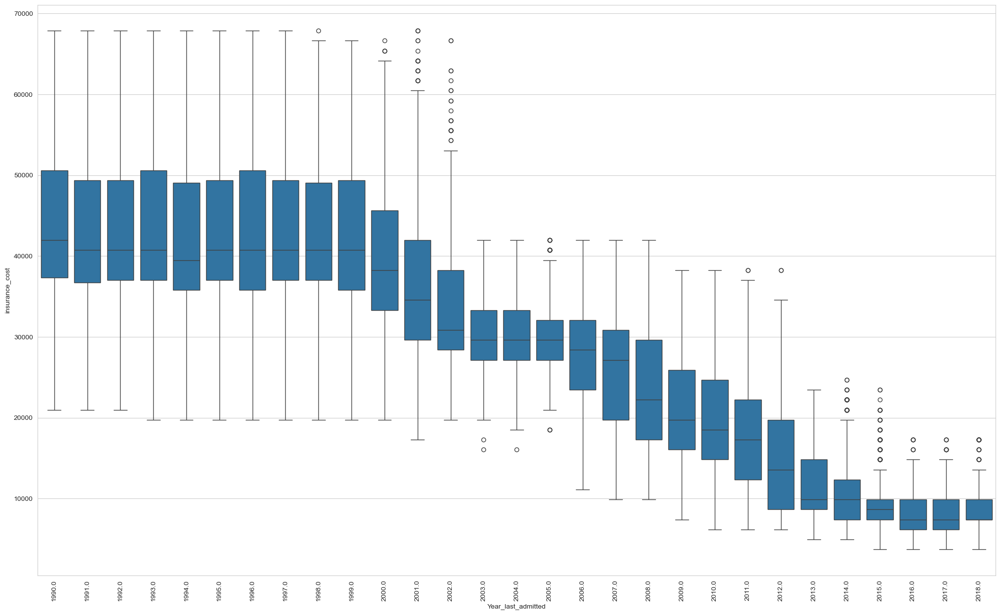

In [29]:
plt.figure(figsize=(25,15))
sns.set_style('whitegrid')
sns.boxplot(x=inscost['Year_last_admitted'],y=inscost['insurance_cost'])
plt.xticks(rotation=90);

<AxesSubplot:xlabel='Year_last_admitted', ylabel='insurance_cost'>

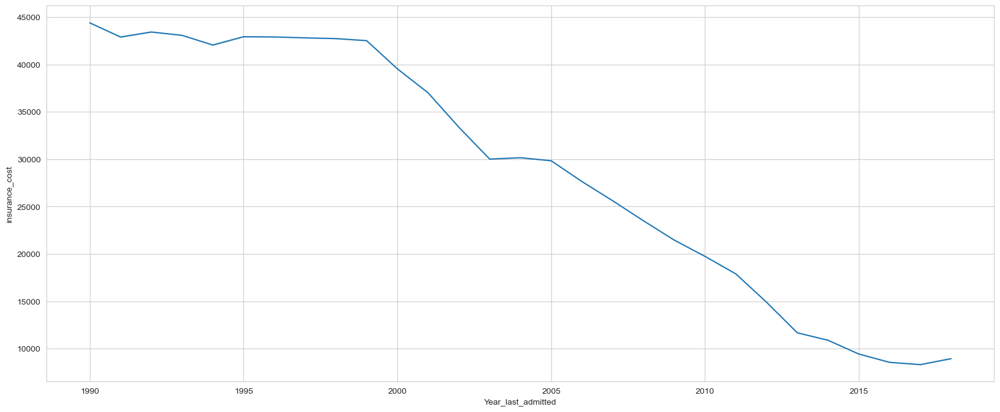

In [30]:
plt.figure(figsize=(20,8))
sns.lineplot(x=inscost['Year_last_admitted'],y=inscost['insurance_cost'],ci=False)

In [31]:
#test to determine the significance of Year_last_admitted field
from scipy.stats import ttest_ind

target_column = 'insurance_cost'

missing_rows = inscost[inscost['Year_last_admitted'].isnull()][target_column]
non_missing_rows = inscost[inscost['Year_last_admitted'].notnull()][target_column]

# t-test to compare the means of the target variable
t_stat, p_value = ttest_ind(missing_rows, non_missing_rows, nan_policy='omit')

# Output the results
print(f'T-statistic: {t_stat}\nP-value: {p_value}')


T-statistic: -26.305462082418646
P-value: 1.85496086049429e-150


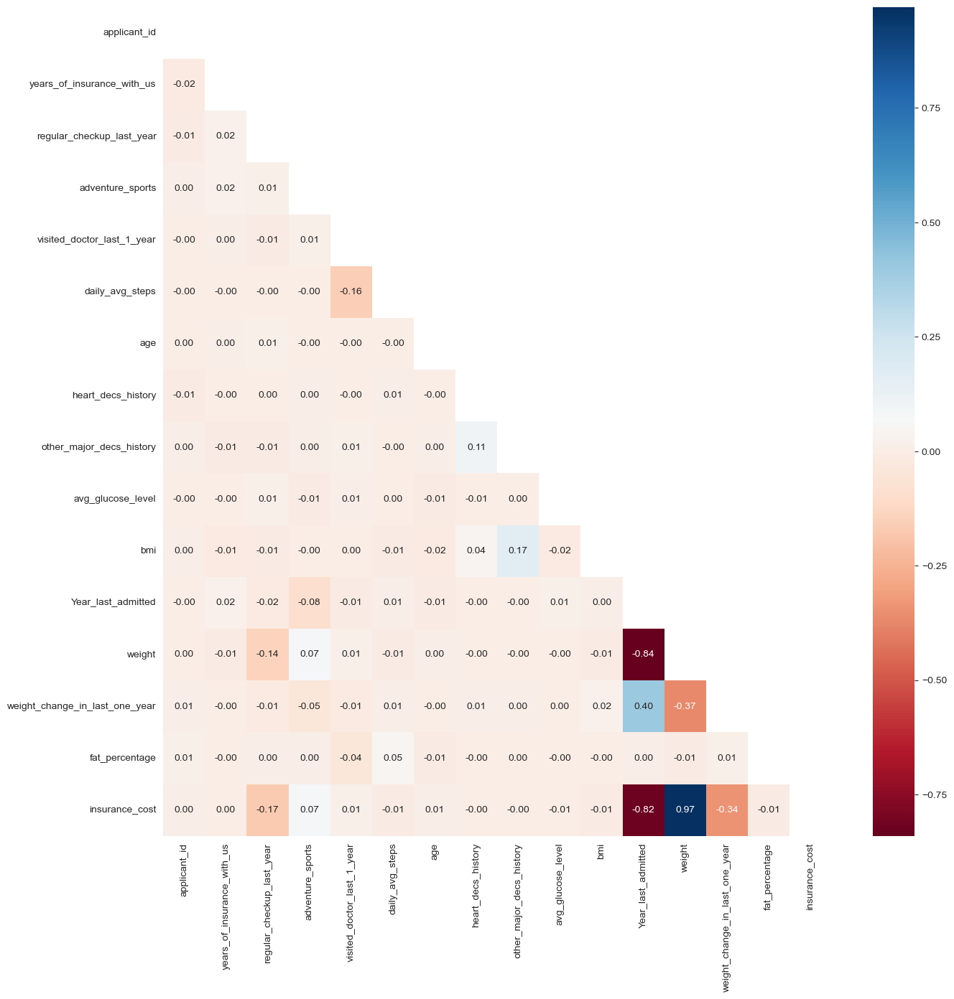

In [32]:
#Examining the correlation of Year_last_admitted with the other predictors and target variable
corr=inscost.corr()
plt.figure(figsize=(15,15))
mask=np.triu(np.ones_like(corr))
sns.heatmap(data=corr, annot=True, fmt='.2f',cmap='RdBu',mask=mask)
plt.show()

Observations:
- The field 'Year_last_admitted' has about 47.5% missing values
- This is a very high percentage, and in a business scenario, efforts have to be made to obtain the actual data
- However, in this case, a decision has to be made whether to drop this variable or impute missing values
- The field in general has a high correlation with the target variable and a couple of predictor variable
- A t-test was done to ascertain the significance, and resulted in a p-value<0.05, which indicated that the variable is significant
- Hence, instead of making the data entirely synthetic, a better option would be to drop the column entirely
- Also, the bmi field has very few missing values. Hence, dropping rows with null values in this field will not result in much data loss

### Missing Value Treatment

In [33]:
inscost_i=pd.DataFrame(inscost.copy(),columns=inscost.columns)

In [34]:
inscost_i.drop('applicant_id',axis=1,inplace=True)

In [35]:
inscost_i.drop('Year_last_admitted',axis=1,inplace=True)

In [36]:
inscost_i[inscost_i['bmi'].isnull()==True].count()

years_of_insurance_with_us        990
regular_checkup_last_year         990
adventure_sports                  990
Occupation                        990
visited_doctor_last_1_year        990
cholesterol_level                 990
daily_avg_steps                   990
age                               990
heart_decs_history                990
other_major_decs_history          990
Gender                            990
avg_glucose_level                 990
bmi                                 0
smoking_status                    990
Location                          990
weight                            990
covered_by_any_other_company      990
Alcohol                           990
exercise                          990
weight_change_in_last_one_year    990
fat_percentage                    990
insurance_cost                    990
dtype: int64

In [37]:
inscost_i.dropna(inplace=True)

In [38]:
inscost_i.shape

(24010, 22)

In [323]:
(((25000*23)-(24010*22))/(25000*23))*100

8.135652173913044

Observations:
- The year_last_admitted columns was dropped, and the 990 rows that has null values in bmi were dropped
- After the missing value treatment, the shape of the dataset is (24010,22)
- The overall data loss due to missing value treatment is 8.13%

## Bad Value Correction

In [39]:
inscost_i['Occupation']=np.where(inscost_i['Occupation']=='Salried','Salaried',inscost_i['Occupation'])

In [40]:
inscost_i['Occupation'].value_counts()

Student     9748
Business    9649
Salaried    4613
Name: Occupation, dtype: int64

In [41]:
inscost_i

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,5494,43,0,0,Female,73,27.4,Unknown,Mumbai,61,N,Rare,Moderate,5,36,13574
24995,3,0,0,Salaried,4,225 to 250,5614,22,0,0,Male,145,36.1,smokes,Kanpur,79,Y,Rare,Moderate,4,40,39488
24996,6,0,0,Business,4,200 to 225,4719,58,0,0,Male,134,31.3,never smoked,Kanpur,66,N,Rare,Moderate,2,28,14808
24998,1,0,0,Salaried,2,225 to 250,10777,27,0,0,Male,66,26.6,Unknown,Surat,74,N,Rare,Moderate,0,40,30850


Observations:
- 'regular_checkup_lasy_year' was renamed as 'regular_checkup_last_year'
- One of the values in the 'Occupation' field was 'Salried'. It was changed to 'Salaried'

## Feature Engineering

In [42]:
inscost_i.head()

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616


In [43]:
num_cols=[ 'daily_avg_steps', 'age',  'avg_glucose_level', 'weight',
       'fat_percentage', 'insurance_cost']
cat_cols=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level',  'heart_decs_history',
       'other_major_decs_history', 'Gender', 
       'smoking_status', 'Location', 
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'fat_percentage']

In [44]:
for i in inscost_i[cat_cols]:
    print('\n',i,'\n', inscost_i[i].value_counts().sort_index())


 years_of_insurance_with_us 
 0    2801
1    2760
2    1741
3    2871
4    2707
5    2827
6    2693
7    2771
8    2839
Name: years_of_insurance_with_us, dtype: int64

 regular_checkup_last_year 
 0    14621
1     4454
2     2104
3     1745
4      750
5      336
Name: regular_checkup_last_year, dtype: int64

 adventure_sports 
 0    22043
1     1967
Name: adventure_sports, dtype: int64

 Occupation 
 Business    9649
Salaried    4613
Student     9748
Name: Occupation, dtype: int64

 visited_doctor_last_1_year 
 0        1
1      412
2     8322
3     6823
4     6426
5     1220
6      531
7      183
8       72
9       13
10       6
12       1
Name: visited_doctor_last_1_year, dtype: int64

 cholesterol_level 
 125 to 150    8001
150 to 175    8396
175 to 200    2778
200 to 225    2862
225 to 250    1973
Name: cholesterol_level, dtype: int64

 heart_decs_history 
 0    22804
1     1206
Name: heart_decs_history, dtype: int64

 other_major_decs_history 
 0    21788
1     2222
Name: other_m

### Value transformation- Category aggregation

In [45]:
inscost_ieda=pd.DataFrame(inscost_i.copy(),columns=inscost_i.columns)

In [46]:
inscost_ieda

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,5494,43,0,0,Female,73,27.4,Unknown,Mumbai,61,N,Rare,Moderate,5,36,13574
24995,3,0,0,Salaried,4,225 to 250,5614,22,0,0,Male,145,36.1,smokes,Kanpur,79,Y,Rare,Moderate,4,40,39488
24996,6,0,0,Business,4,200 to 225,4719,58,0,0,Male,134,31.3,never smoked,Kanpur,66,N,Rare,Moderate,2,28,14808
24998,1,0,0,Salaried,2,225 to 250,10777,27,0,0,Male,66,26.6,Unknown,Surat,74,N,Rare,Moderate,0,40,30850


In [47]:
inscost_ieda['visited_doctor_last_1_year']=np.where(inscost_ieda['visited_doctor_last_1_year']>=5,5,inscost_ieda['visited_doctor_last_1_year'])
inscost_ieda['visited_doctor_last_1_year']=np.where(inscost_ieda['visited_doctor_last_1_year']<=1,1,inscost_ieda['visited_doctor_last_1_year'])

In [48]:
inscost_ieda['visited_doctor_last_1_year'].value_counts().sort_index()

1     413
2    8322
3    6823
4    6426
5    2026
Name: visited_doctor_last_1_year, dtype: int64

Observations:
- 'visited_doctor_last_year' had very little values for 0 visits and over 5 visits. These were aggregated into 1 visit and 5 visits for the purpose of EDA

### New feature creation

In [49]:
inscost_ieda['daily_avg_steps'].describe()

count    24010.000000
mean      5215.863265
std       1053.556213
min       2034.000000
25%       4543.000000
50%       5089.000000
75%       5730.750000
max      11255.000000
Name: daily_avg_steps, dtype: float64

In [50]:
inscost_ieda['avg_step_cat']=np.where(
    (inscost_ieda['daily_avg_steps']<=4500),
        'Sedentary',
        np.where(
            (inscost_ieda['daily_avg_steps'] > 4500) &  (inscost_ieda['daily_avg_steps']<=6000),
            'Lightly Active',
                np.where(
                    (inscost_ieda['daily_avg_steps'] > 6000) &  (inscost_ieda['daily_avg_steps'] <= 10000),
                        'Active','Very Active')))

In [51]:
inscost_ieda['weight'].value_counts().sort_index()

52    162
53    115
54    139
55    152
56    346
57    556
58    545
59    678
60    697
61    781
62    760
63    689
64    614
65    657
66    754
67    722
68    830
69    725
70    876
71    907
72    901
73    890
74    856
75    954
76    930
77    999
78    925
79    888
80    862
81    715
82    582
83    380
84    331
85    297
86    299
87    262
88    228
89    228
90    198
91    190
92    122
93    109
94     82
95     61
96     16
Name: weight, dtype: int64

In [52]:
inscost_ieda['weight_cat']=np.where(
    (inscost_ieda['weight']<=60),
        'Underweight',
        np.where(
            (inscost_ieda['weight'] > 60) &  (inscost_ieda['weight']<=70),
            'Normal Weight',
                np.where(
                    (inscost_ieda['weight'] > 70) &  (inscost_ieda['weight'] <= 80),
                        'Overweight',
                        np.where(
                            (inscost_ieda['weight'] > 80) &  (inscost_ieda['weight'] <= 90), 
                                'Obese', 'Very Obese'))))

In [53]:
inscost_ieda['fat_percentage'].value_counts().sort_index()

11     534
12     413
13     422
14      94
15     235
16    1178
17      63
18     258
19     888
20     859
21    1107
22     914
23     416
24    1366
25     665
26     192
27     482
28     210
29    1543
30     103
31     623
32     295
33    1753
34     601
35     844
36    2799
37    1235
38    1410
39     863
40     391
41     345
42     909
Name: fat_percentage, dtype: int64

In [54]:
inscost_ieda['fat_percentage_cat']=np.where(
    (inscost_ieda['fat_percentage']<=20),
        'Low body fat',
        np.where(
            (inscost_ieda['fat_percentage'] > 20) &  (inscost_ieda['fat_percentage']<=30),
            'Moderate body fat',
                np.where(
                    (inscost_ieda['fat_percentage'] > 30) &  (inscost_ieda['fat_percentage'] <= 40),
                        'High body fat', 'Very High body fat')))

In [55]:
inscost_ieda['insurance_cost'].value_counts().sort_index()

2468       12
3702      300
4936      190
6170      927
7404     1152
8638      918
9872      710
11106     412
12340     360
13574     439
14808     548
16042     556
17276     621
18510     598
19744     612
20978     696
22212     625
23446     611
24680     640
25914     752
27148     688
28382     814
29616     735
30850     713
32084     645
33318     705
34552     825
35786     783
37020     832
38254     936
39488     705
40722     457
41956     370
43190     254
44424     248
45658     226
46892     241
48126     247
49360     232
50594     185
51828     170
53062     185
54296     168
55530     144
56764     119
57998     111
59232     139
60466     131
61700      70
62934      81
64168      74
65402      55
66636      27
67870      16
Name: insurance_cost, dtype: int64

In [56]:
inscost_ieda['insurance_cost_cat']=np.where(
    (inscost_ieda['insurance_cost']<=10000),
        '1st Tier',
        np.where(
            (inscost_ieda['insurance_cost'] > 10000) &  (inscost_ieda['insurance_cost']<=20000),
            '2nd Tier',
                np.where(
                    (inscost_ieda['insurance_cost'] > 20000) &  (inscost_ieda['insurance_cost'] <= 30000),
                        '3rd Tier',
                        np.where(
                            (inscost_ieda['insurance_cost'] > 30000) &  (inscost_ieda['insurance_cost'] <= 40000), 
                                '4th  Tier', 
                                np.where(
                                    (inscost_ieda['insurance_cost'] > 40000) &  (inscost_ieda['insurance_cost'] <= 50000), 
                                        '5th Tier', '6th Tier')))))

Observations:
- For some of the numerical fields like daily_avg_steps, fat_percentage,weight and insurance_cost, corresponding categorical fields were created by creating buckets for numerical values for the purpose of EDA

In [57]:
inscost_ieda

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost,avg_step_cat,weight_cat,fat_percentage_cat,insurance_cost_cat
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978,Lightly Active,Normal Weight,Moderate body fat,3rd Tier
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170,Active,Underweight,Moderate body fat,1st Tier
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382,Lightly Active,Overweight,High body fat,3rd Tier
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148,Active,Overweight,High body fat,3rd Tier
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616,Lightly Active,Overweight,High body fat,3rd Tier
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,5494,43,0,0,Female,73,27.4,Unknown,Mumbai,61,N,Rare,Moderate,5,36,13574,Lightly Active,Normal Weight,High body fat,2nd Tier
24995,3,0,0,Salaried,4,225 to 250,5614,22,0,0,Male,145,36.1,smokes,Kanpur,79,Y,Rare,Moderate,4,40,39488,Lightly Active,Overweight,High body fat,4th Tier
24996,6,0,0,Business,4,200 to 225,4719,58,0,0,Male,134,31.3,never smoked,Kanpur,66,N,Rare,Moderate,2,28,14808,Lightly Active,Normal Weight,Moderate body fat,2nd Tier
24998,1,0,0,Salaried,2,225 to 250,10777,27,0,0,Male,66,26.6,Unknown,Surat,74,N,Rare,Moderate,0,40,30850,Very Active,Overweight,High body fat,4th Tier


In [58]:
inscost_ieda.columns

Index(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history', 'Gender', 'avg_glucose_level', 'bmi',
       'smoking_status', 'Location', 'weight', 'covered_by_any_other_company',
       'Alcohol', 'exercise', 'weight_change_in_last_one_year',
       'fat_percentage', 'insurance_cost', 'avg_step_cat', 'weight_cat',
       'fat_percentage_cat', 'insurance_cost_cat'],
      dtype='object')

In [59]:
eda_col_order=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history', 'Gender', 'avg_glucose_level',
       'smoking_status', 'Location', 'weight',
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'fat_percentage', 
       'avg_step_cat', 'weight_cat', 'fat_percentage_cat',
       'insurance_cost_cat','insurance_cost']

In [60]:
inscost_ieda=inscost_ieda[eda_col_order]

In [61]:
inscost_ieda.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24010 entries, 0 to 24999
Data columns (total 25 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   years_of_insurance_with_us      24010 non-null  int64 
 1   regular_checkup_last_year       24010 non-null  int64 
 2   adventure_sports                24010 non-null  int64 
 3   Occupation                      24010 non-null  object
 4   visited_doctor_last_1_year      24010 non-null  int64 
 5   cholesterol_level               24010 non-null  object
 6   daily_avg_steps                 24010 non-null  int64 
 7   age                             24010 non-null  int64 
 8   heart_decs_history              24010 non-null  int64 
 9   other_major_decs_history        24010 non-null  int64 
 10  Gender                          24010 non-null  object
 11  avg_glucose_level               24010 non-null  int64 
 12  smoking_status                  24010 non-null

In [62]:
num=[ 'daily_avg_steps', 'age',  'avg_glucose_level',  'weight',
       'fat_percentage', 'insurance_cost']
cat=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level',  'heart_decs_history',
       'other_major_decs_history', 'Gender', 
       'smoking_status',  'Location', 
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'avg_step_cat','weight_cat','fat_percentage_cat','insurance_cost_cat']
binry=['adventure_sports','covered_by_any_other_company','heart_decs_history',
       'other_major_decs_history', 'Gender']

## EDA

### Univariate Analysis

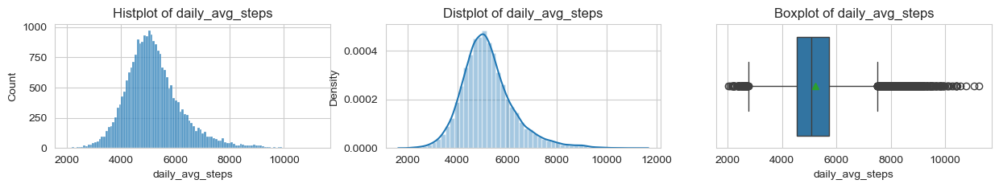

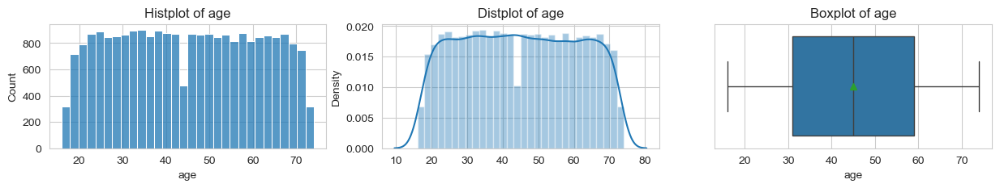

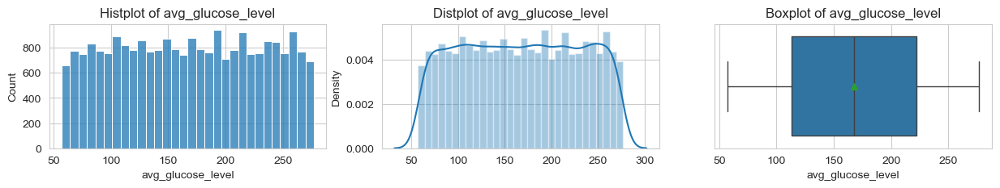

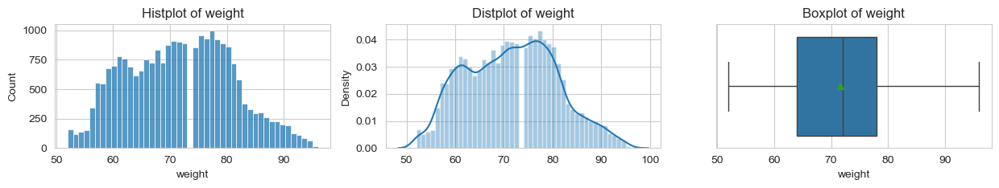

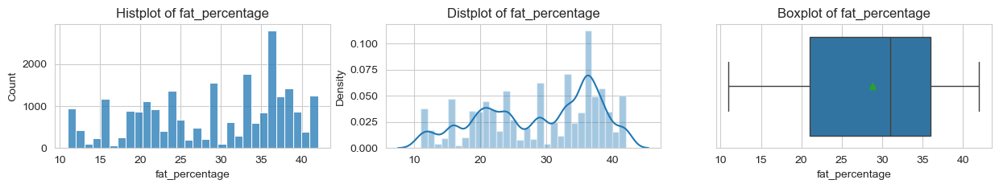

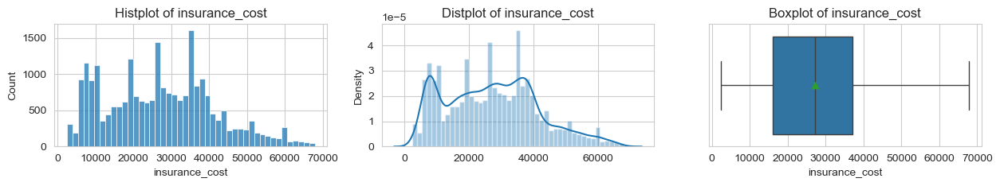

In [63]:
for i in inscost_ieda[num]:
    fig,axes= plt.subplots(ncols=3,figsize=(15,2))
    sns.histplot(x=inscost_ieda[i],ax=axes[0])
    axes[0].set_title('Histplot of {}'.format(i))
    sns.distplot(x=inscost_ieda[i],ax=axes[1])
    axes[1].set_title('Distplot of {}'.format(i))
    sns.boxplot(data=inscost_ieda,x=i,showmeans=True,ax=axes[2])
    axes[2].set_title('Boxplot of {}'.format(i))
    plt.show()

In [330]:
inscost['fat_percentage'].nunique()

32

Observations:
- Columns with outliers: daily_avg_steps
- age,avg_glucose_level have a uniform distribution
- weight variable has a multimodal distribution
- fat_percentage has 32 unique values ranging from 11-42. Hence the distribution is multimodal

In [64]:
non_bin_cat=[x for x in cat if x not in binry]

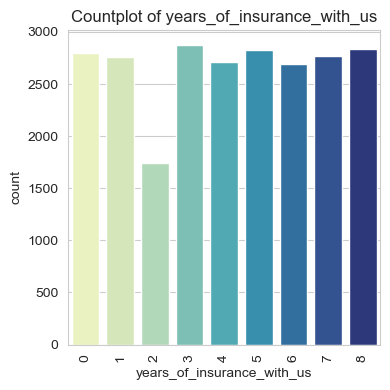

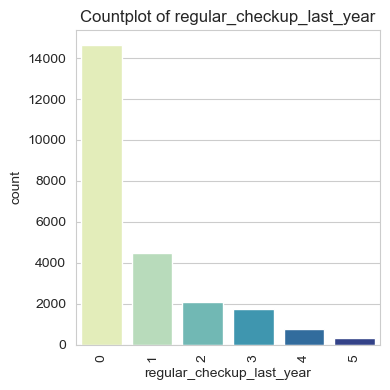

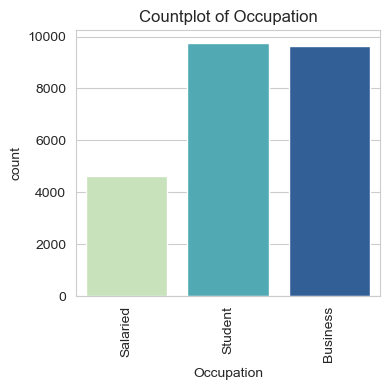

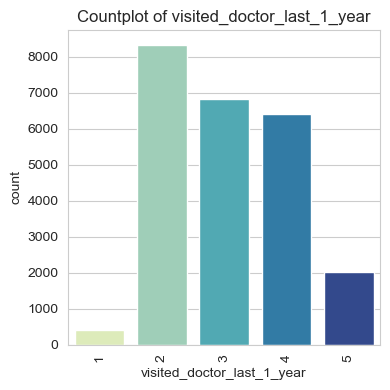

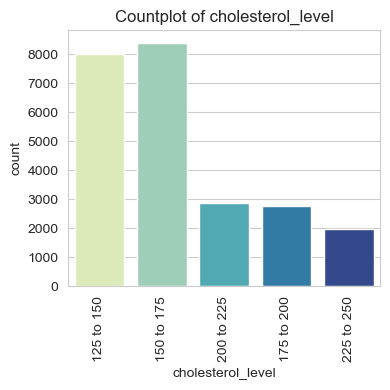

...

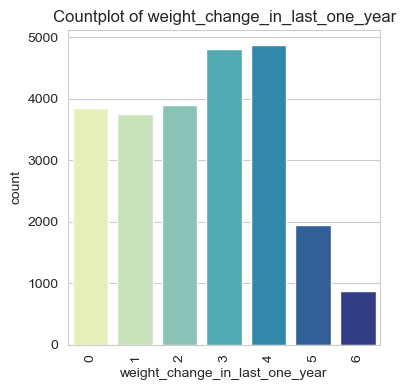

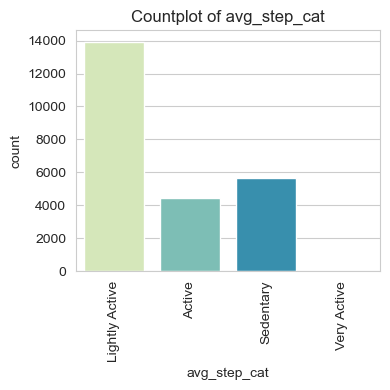

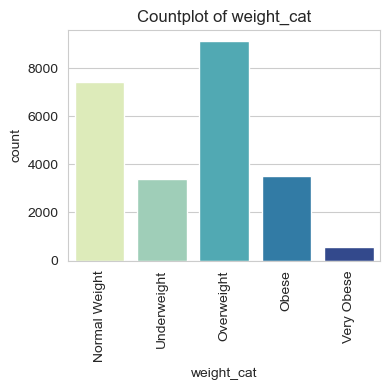

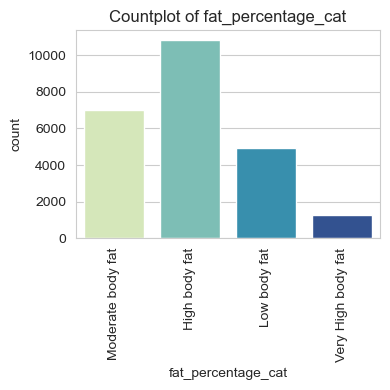

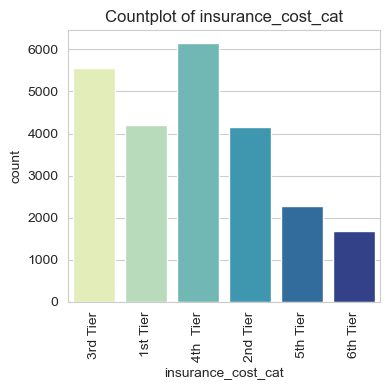

In [342]:
for i in inscost_ieda[non_bin_cat]:
    plt.figure(figsize=(4,4))
    sns.countplot(data=inscost_ieda,x=i,palette='YlGnBu')
    plt.title('Countplot of {}'.format(i))
    plt.xticks(rotation=90)
    plt.tight_layout();
    plt.show();

Observations:
- The count of customers having 2 years of insurance with us is lower than the rest
- Most of the people have not had any regular checkup last year
- There is almost an equal number of Students and Business professionals in the dataset. However, the count of Salaried professionals is almost half than that of the other two categories in Occupation field
- Most of the people seem to have visited the doctor 2-4 times last year 
- Most of the people have either 125-150 or 150-175 cholestrol level. Those of them who have higher cholestrol levels are very low in count
- Most of the people in the dataset have reported to have never smoked. However, there is an Unknown category in the smoking_status field. For the purpose of this project,it is treated as Unknown. However, if there is a way to get this information, it  would help in analysis
- There are 15 unique locations in the dataset, where people are from, and they are almost equally distributed amonst these locations.
- Most of the people have reported Rare or no alcohol consumption. Very few have reported daily alcohol consumption
- Most of the people have reported moderate excercise
- Most of the customers have reported a weight change of 3-4 in the past year
- Most of the customers are classified as lightly active, i.e. they take 4500-6000 steps everyday
- Most of the people are overweight, ie. have weight ranging from 70-80 . Very few are classified as very obese i.e. >90.
- Most of the people have High body fat.ie, body fat_percentage ranging from 30-40
- Based of the classification of insurance cost, most of the people belon to the 4th tier, ie., 30000-40000

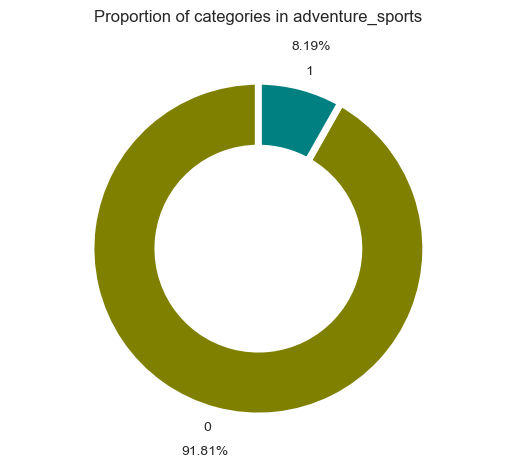

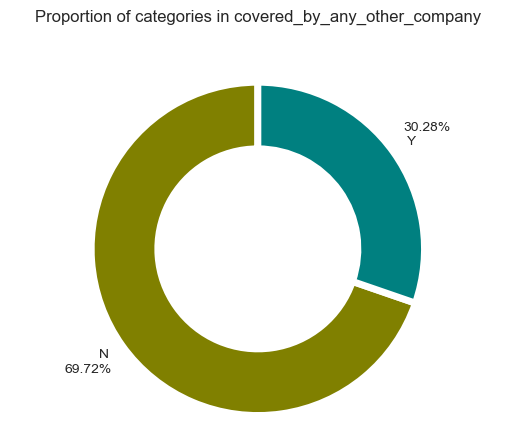

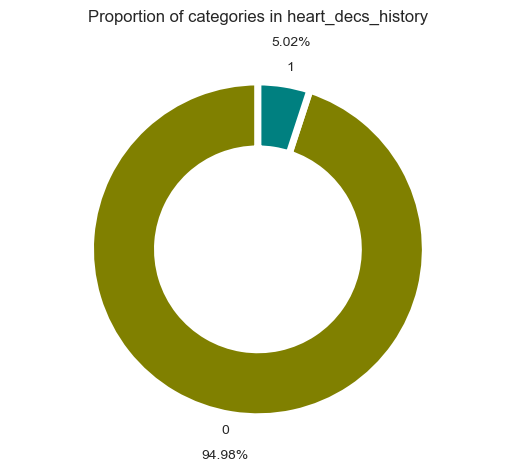

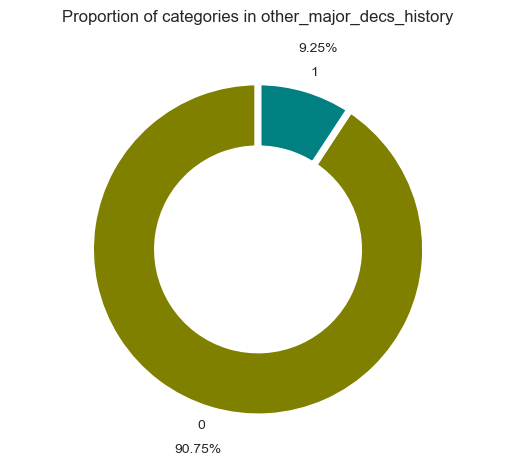

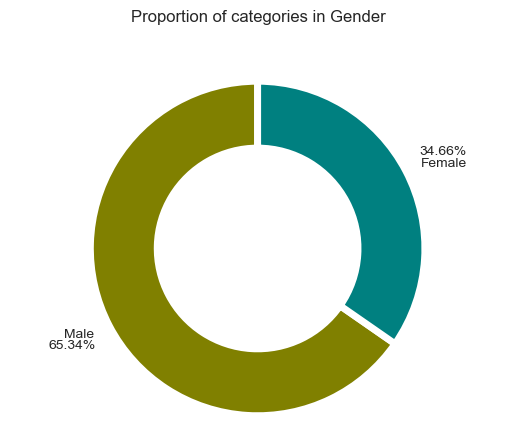

In [66]:
for i in inscost_ieda[binry]:
    plt.pie(x=inscost_ieda[i].value_counts(),labels=inscost_ieda[i].value_counts().index,autopct='%0.2f%%',colors=['olive','teal'],
       wedgeprops=dict(width=0.4,linewidth=5),pctdistance=1.25,startangle=90)
    plt.title('Proportion of categories in {}\n\n'.format(i))
    plt.Circle((0,0),0.6,color='white')
    plt.axis('equal')
    plt.show();

Observations:
- Among the categorical variables, Gender, adventure_sports, covered_by_other_company, heart_dec_history, other_decs_historyare all binary in nature
- About 2/3rd of the people are males
- Less than 10% have had other major diseased, adn less than 5% have had heart diseases
- Aboout 8% of the people engage in adventure sports
- And about 30% are covered by other insurance companies

### Bivariate Analysis

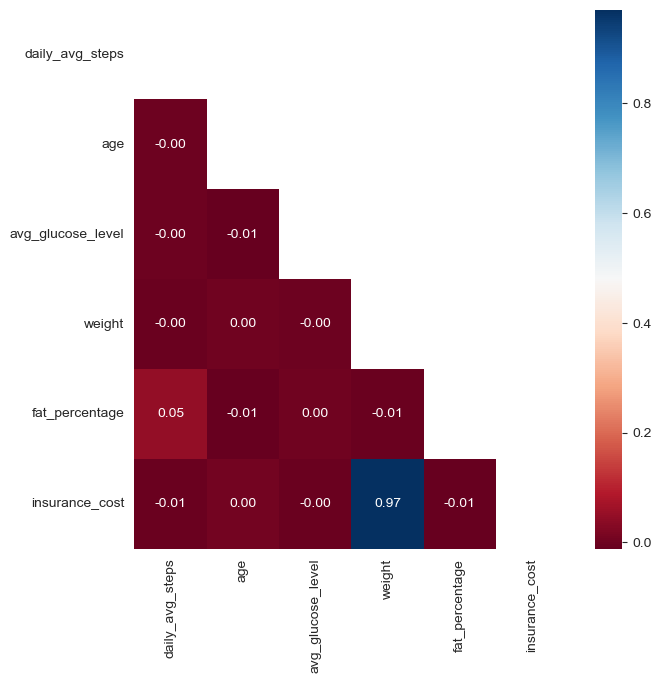

In [67]:
corl=inscost_ieda[num].corr()
plt.figure(figsize=(7,7))
mask=np.triu(np.ones_like(corl))
sns.heatmap(data=corl,annot=True, fmt='.2f',cmap='RdBu',mask=mask)
plt.show()

Observations:
- Of all the numerical variables, only the weight variable seems to have a high positive correlation with the target variable

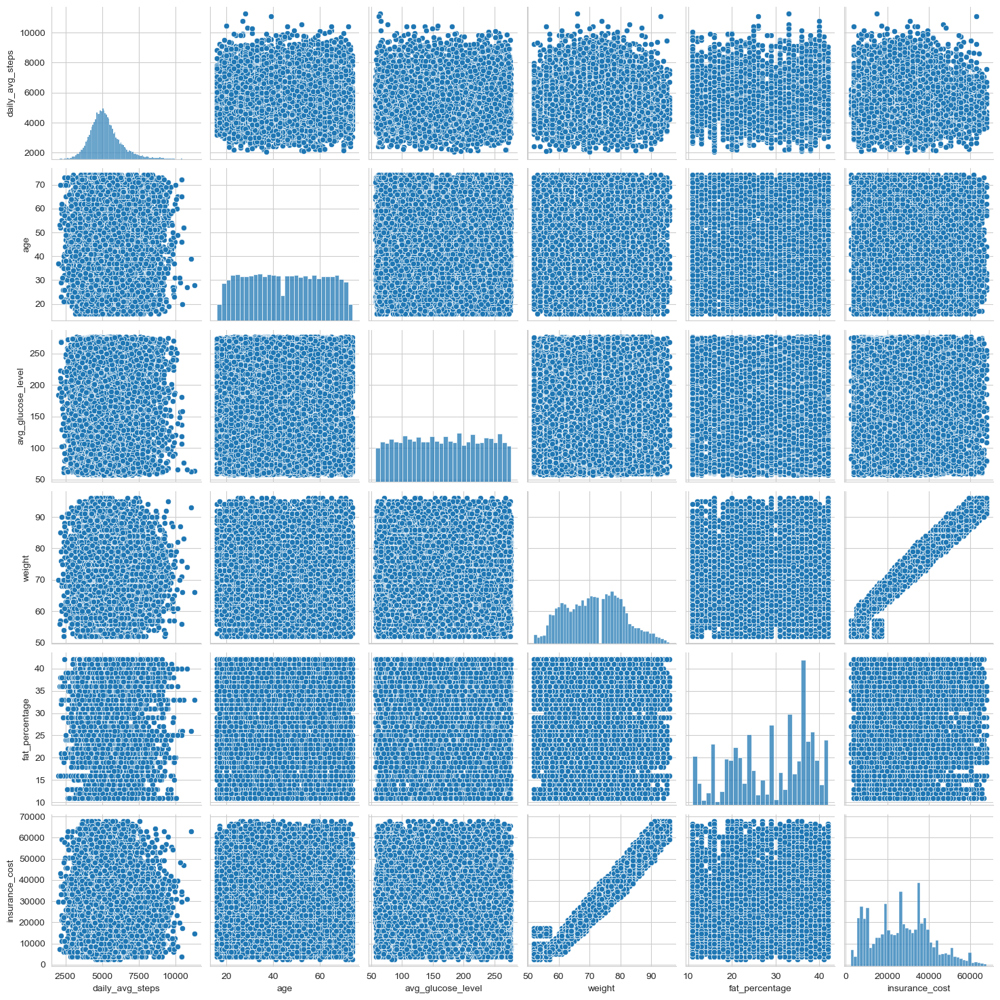

In [68]:
sns.pairplot(inscost_ieda[num])

Observations:
- From the pairplots above, a linear relation can be observed only between weight and insurance cost
- No other relation between any of the variables in discernable

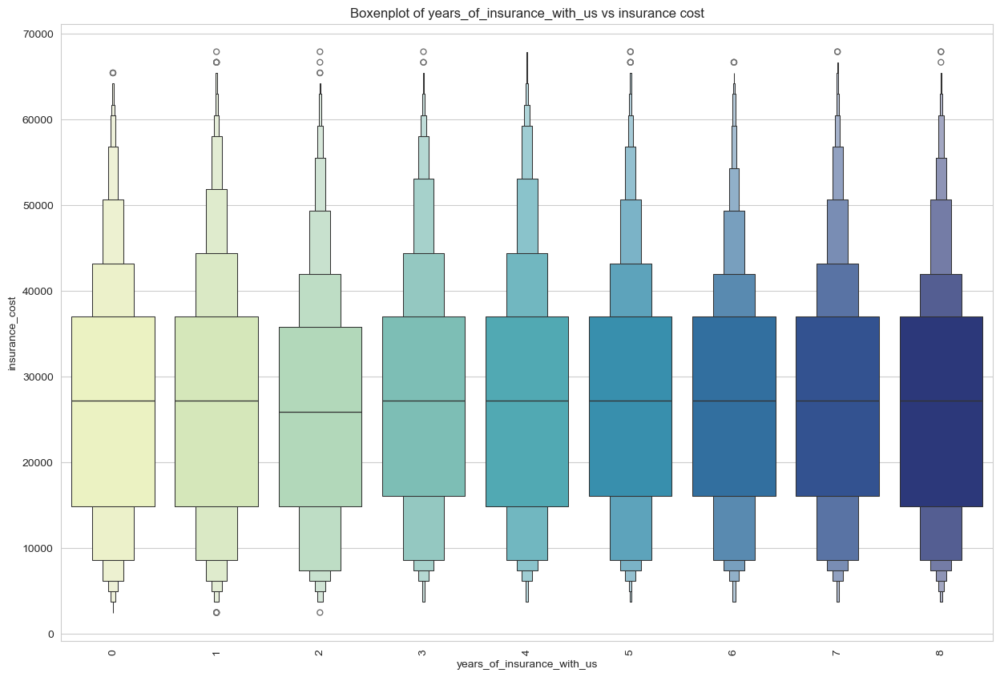

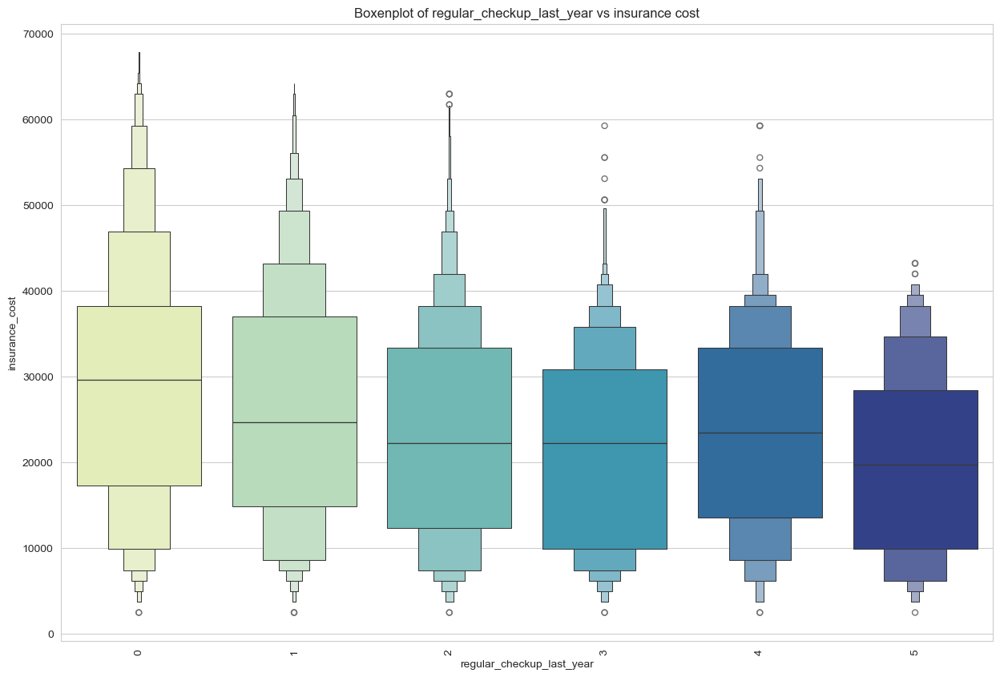

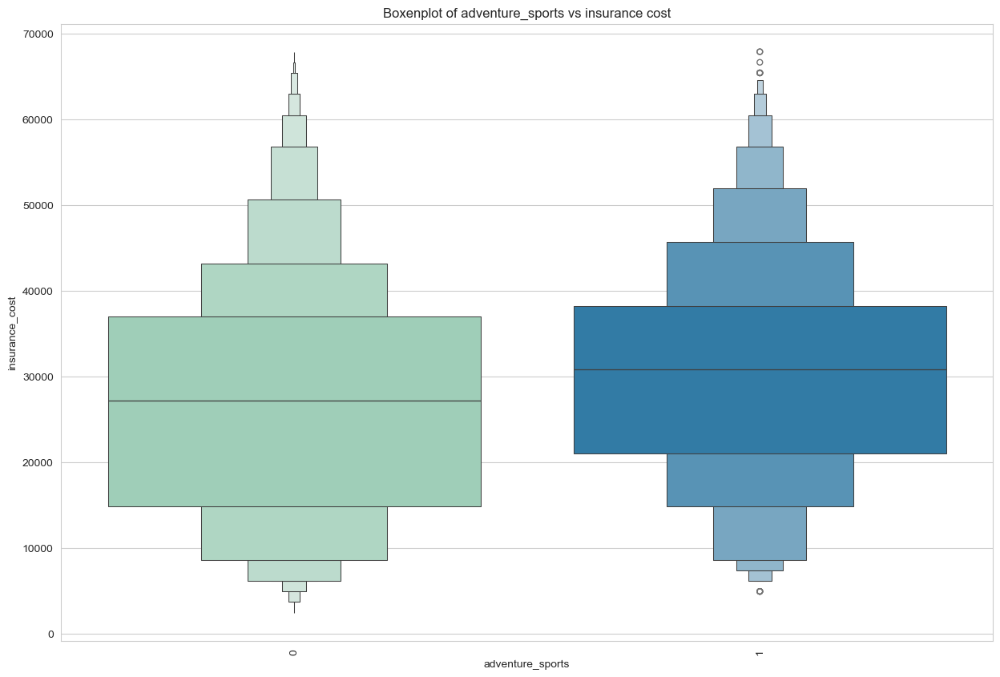

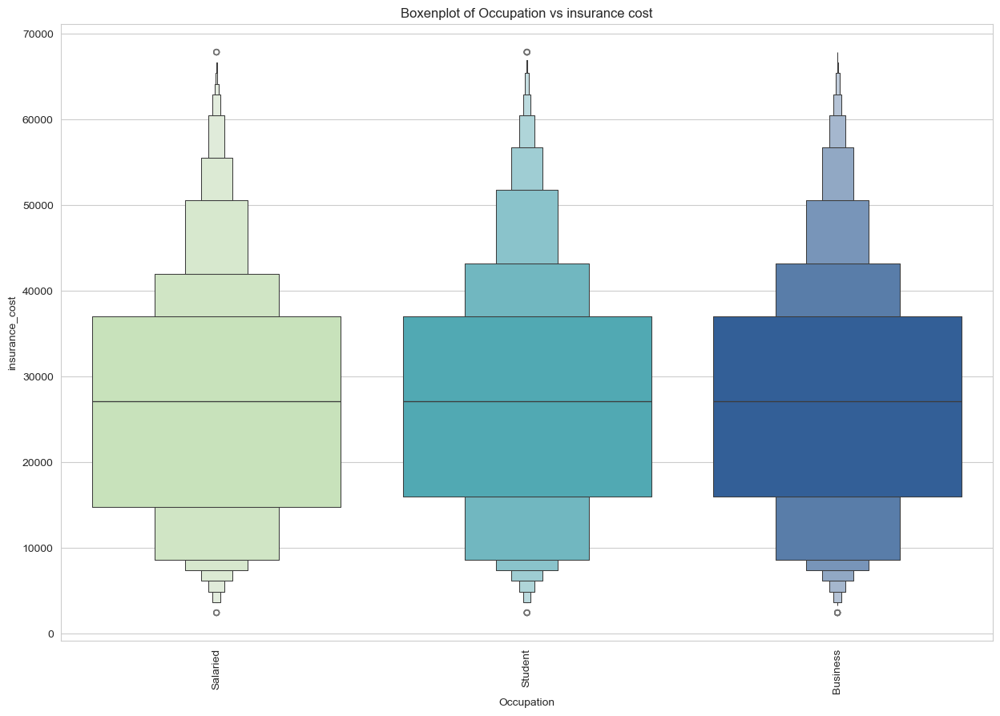

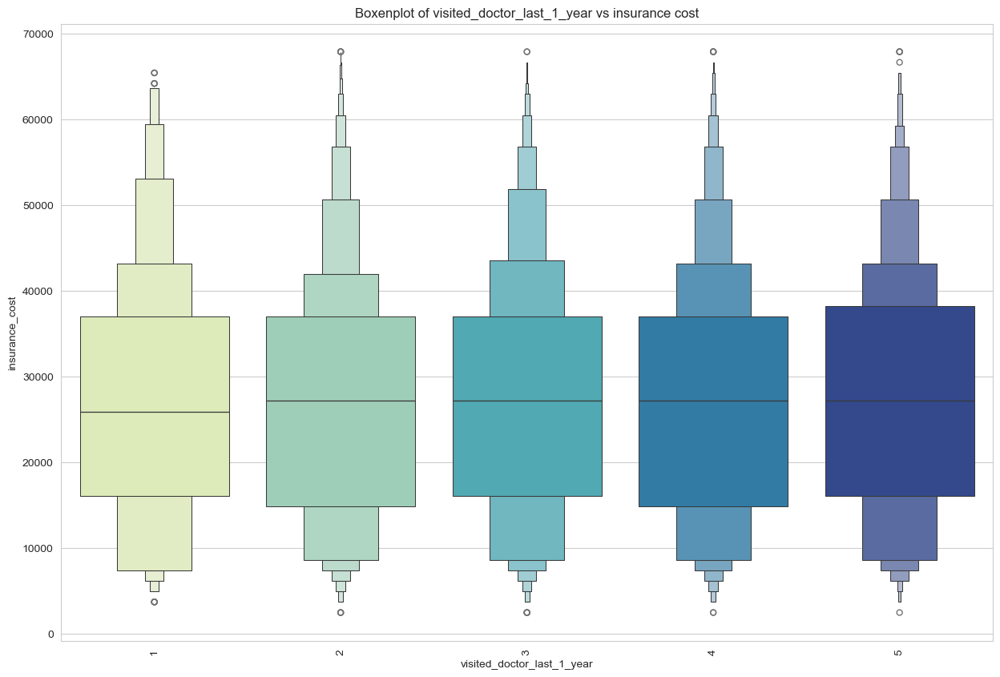

...

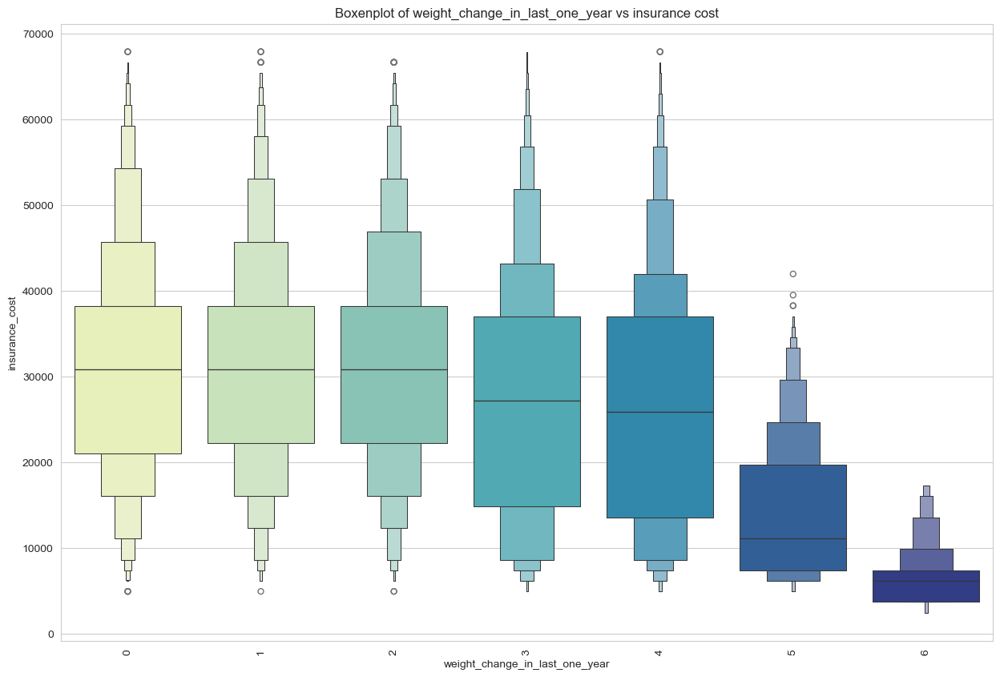

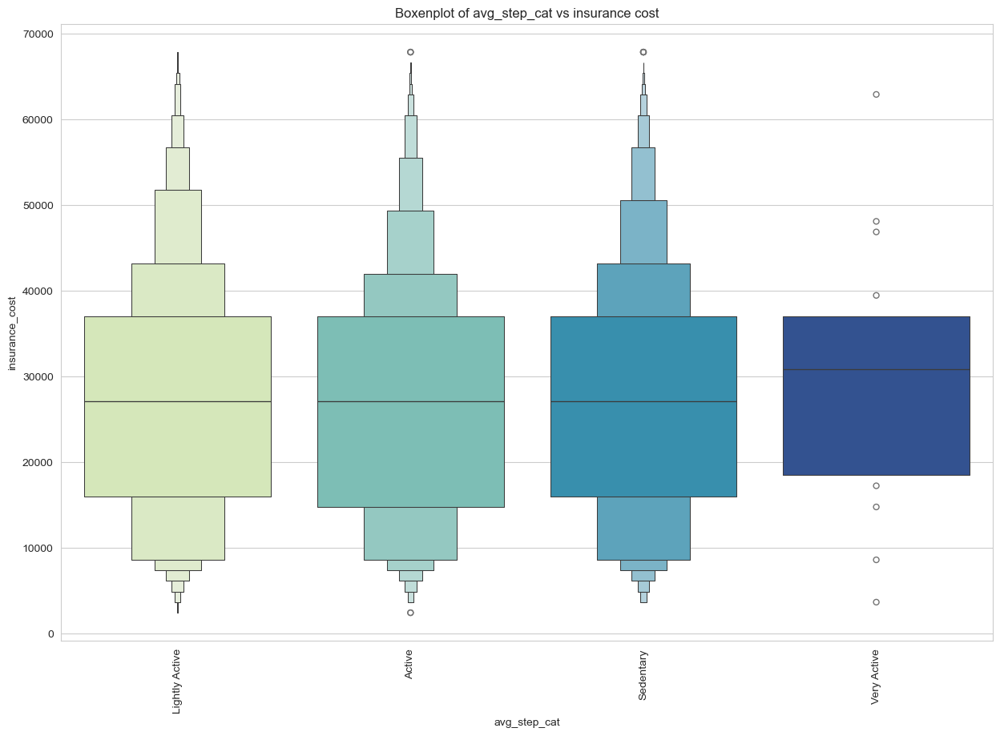

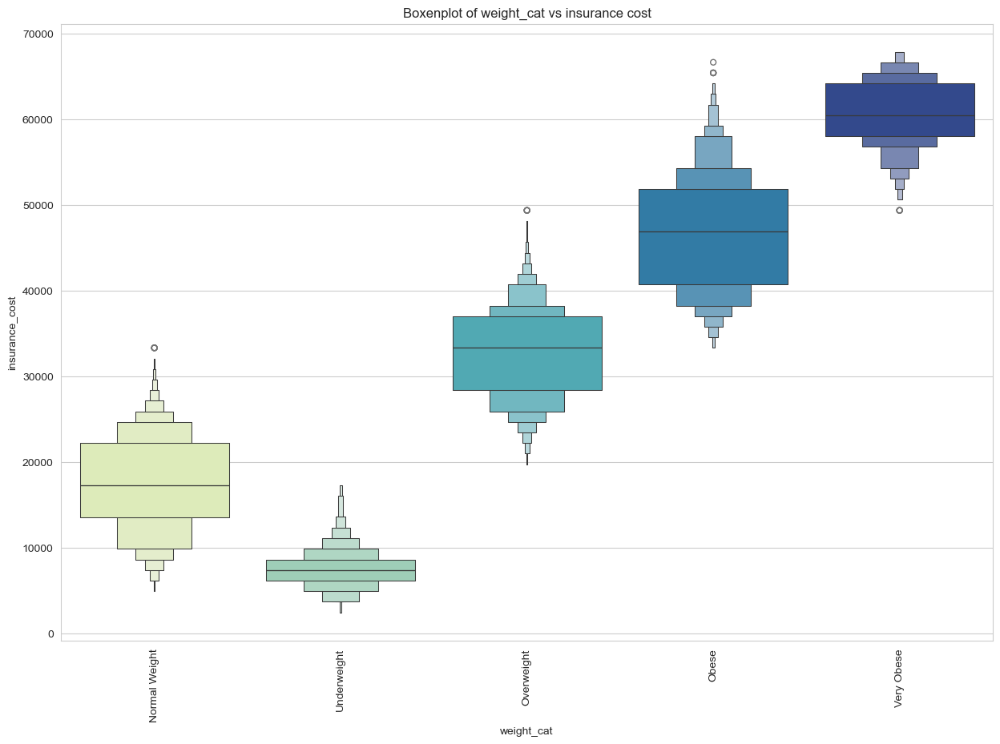

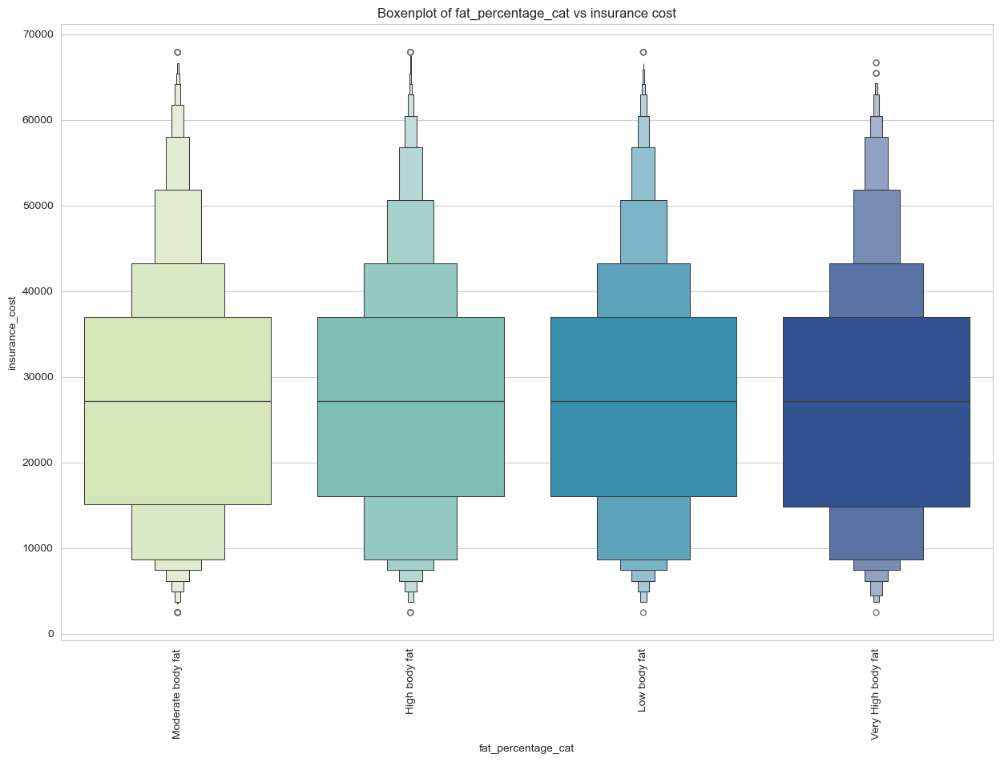

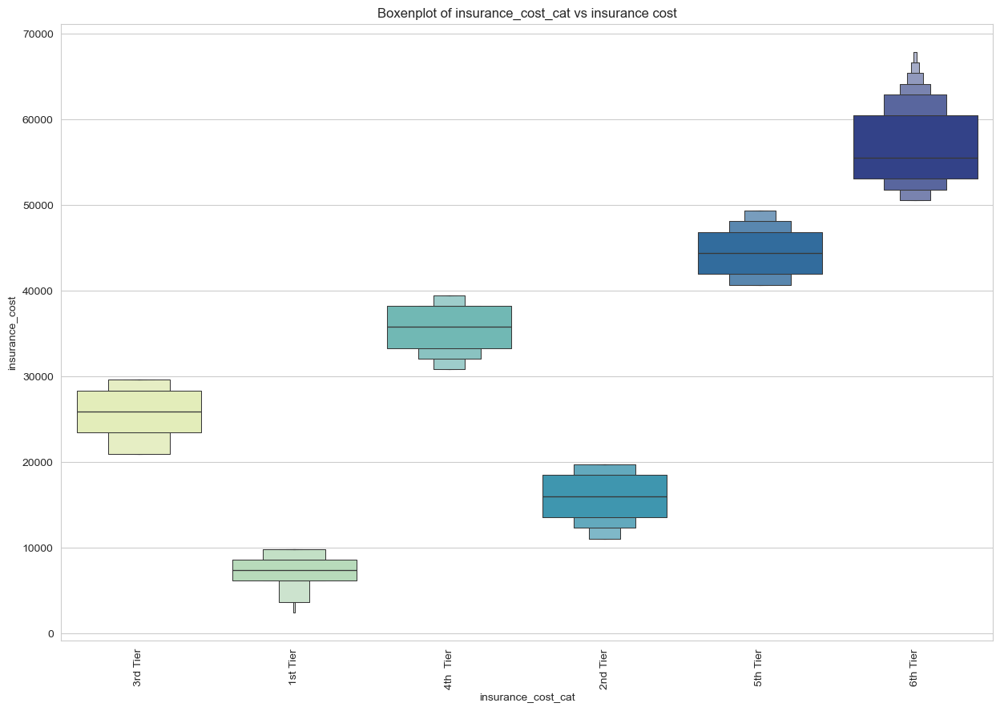

In [345]:
for i in inscost_ieda[cat]:
    plt.figure(figsize=(15,10))
    sns.boxenplot(data=inscost_ieda,x=i,y='insurance_cost',palette='YlGnBu',showfliers=True)
    plt.title('Boxenplot of {} vs insurance cost'.format(i))
    plt.xticks(rotation=90)
    plt.show();

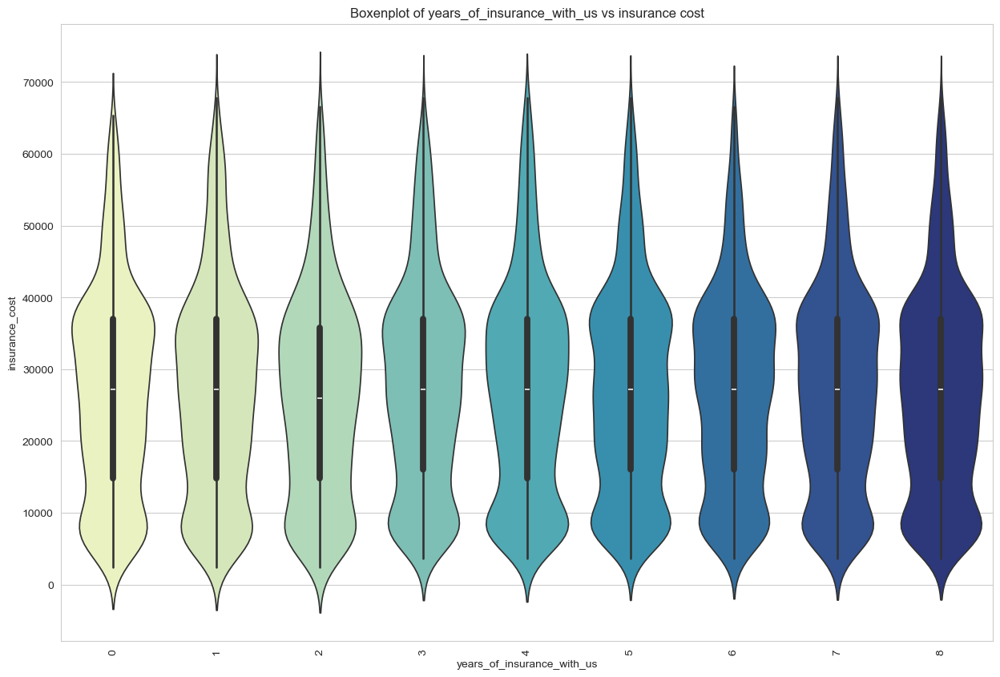

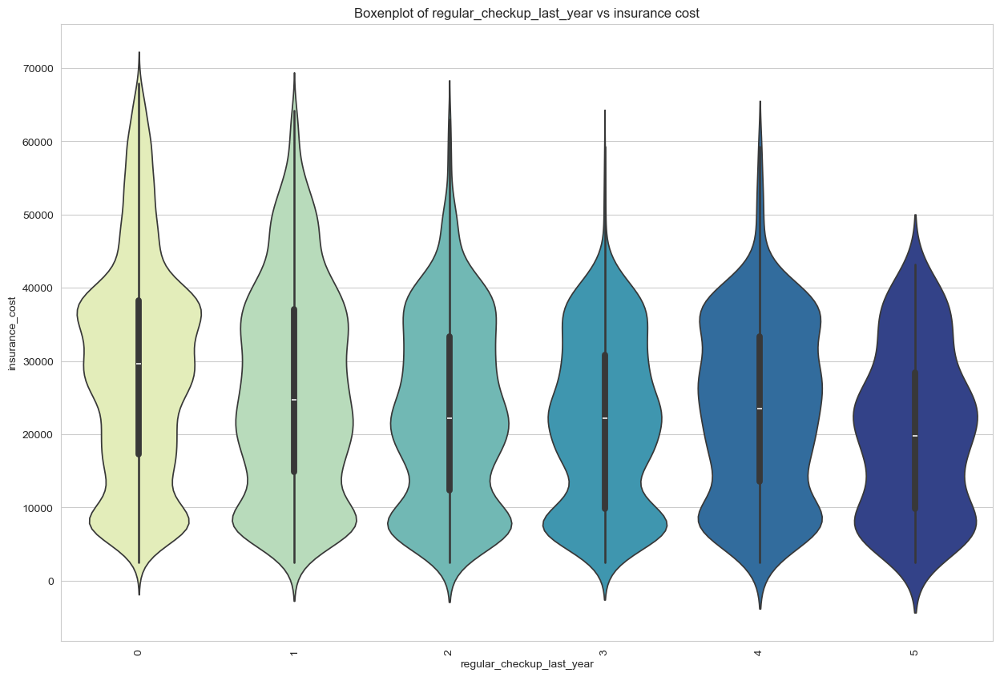

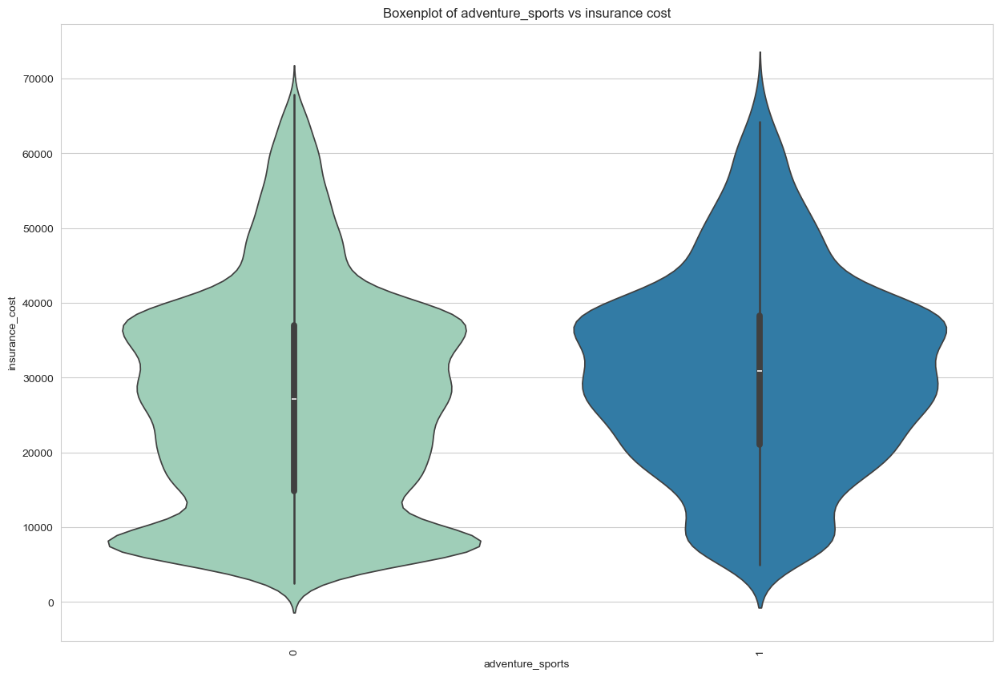

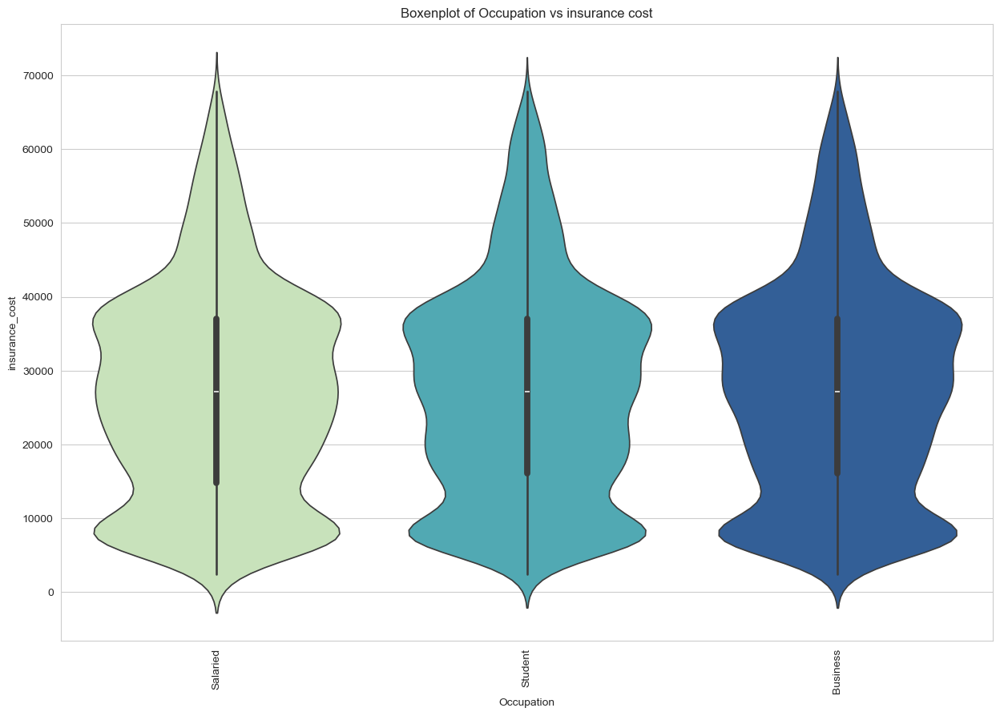

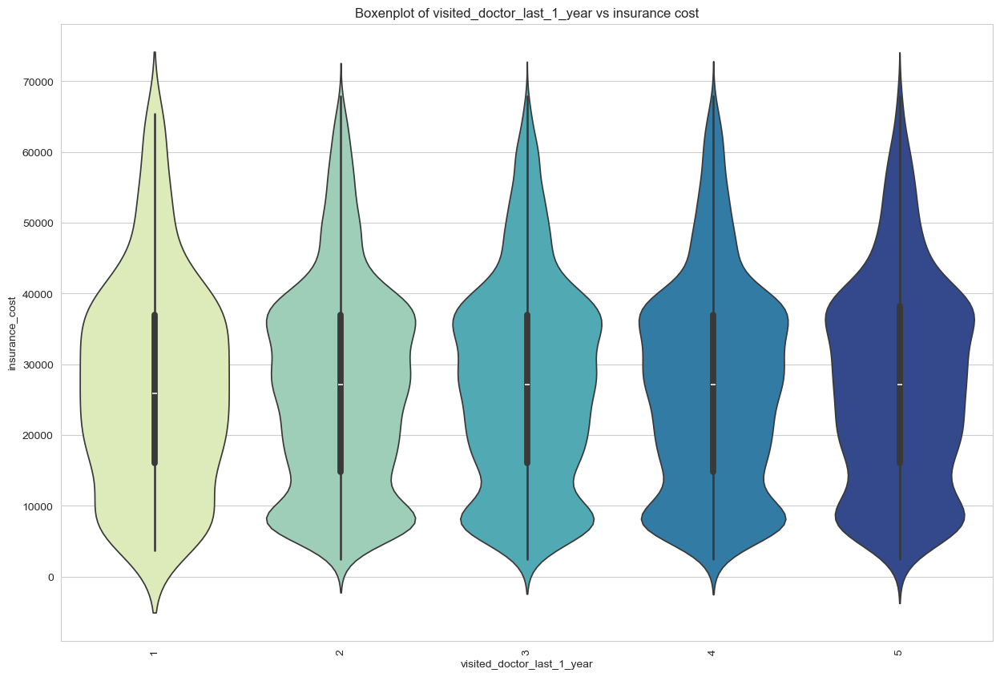

...

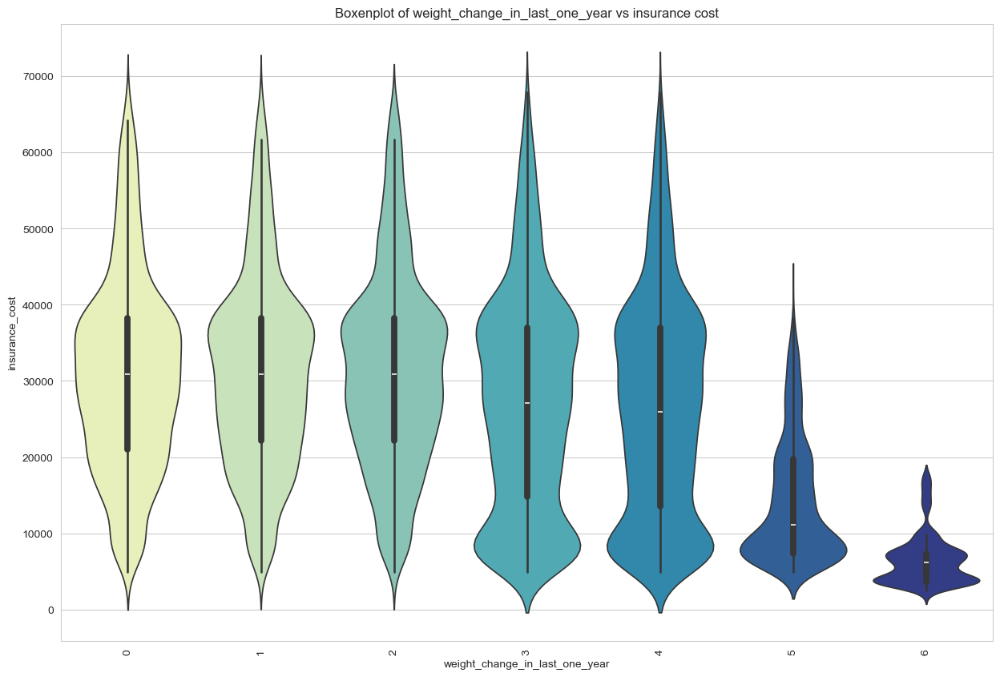

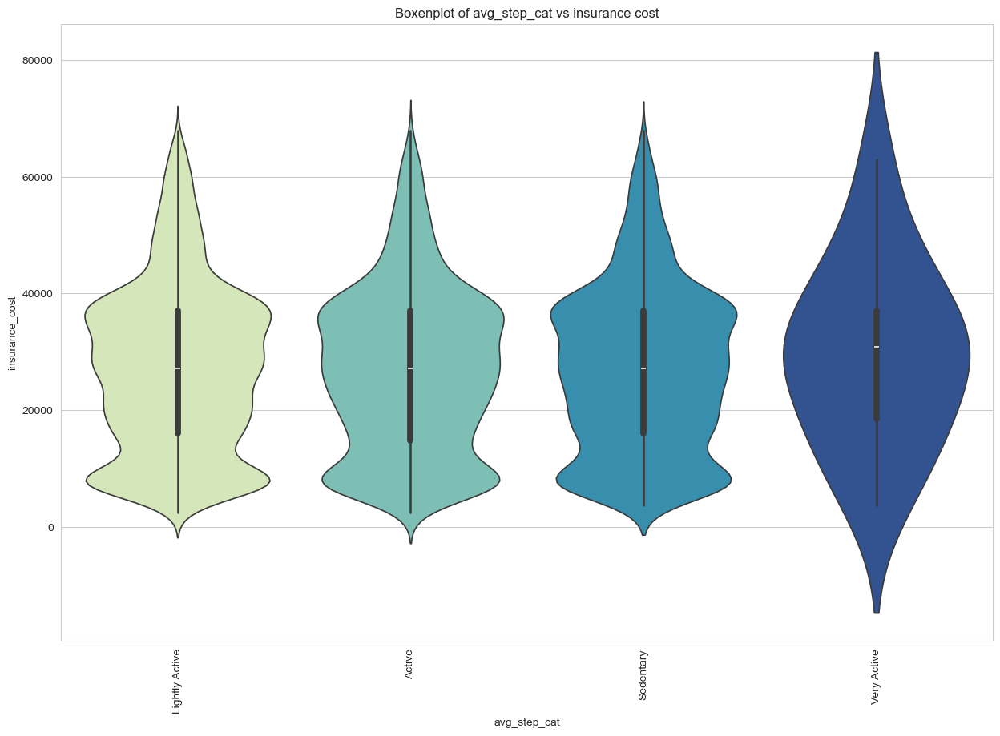

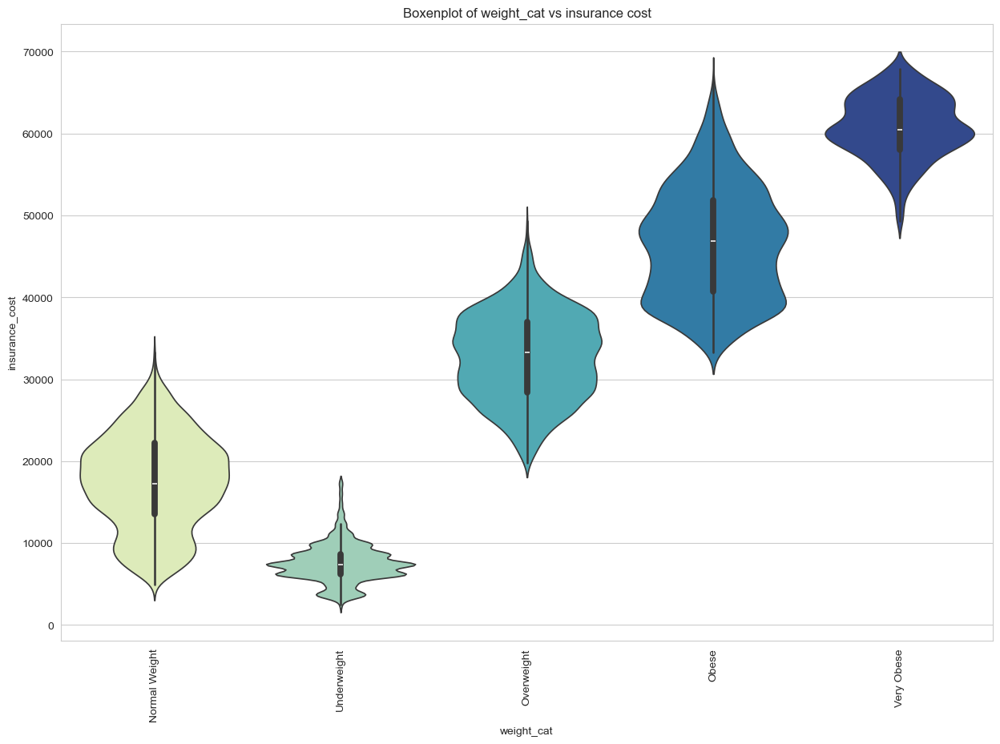

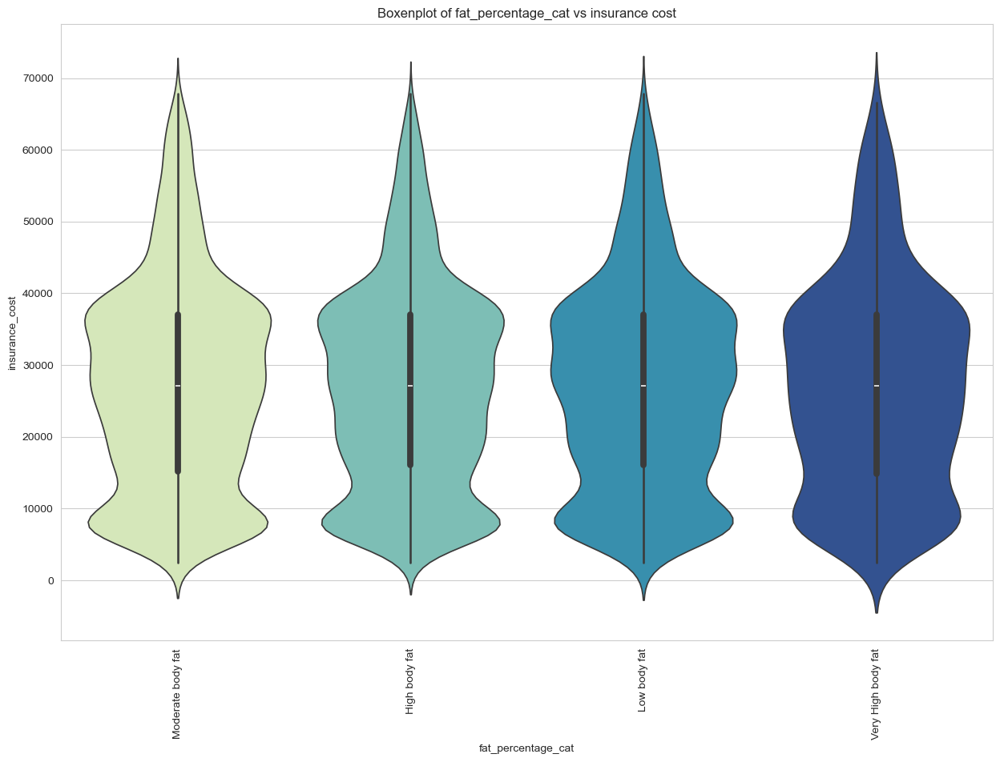

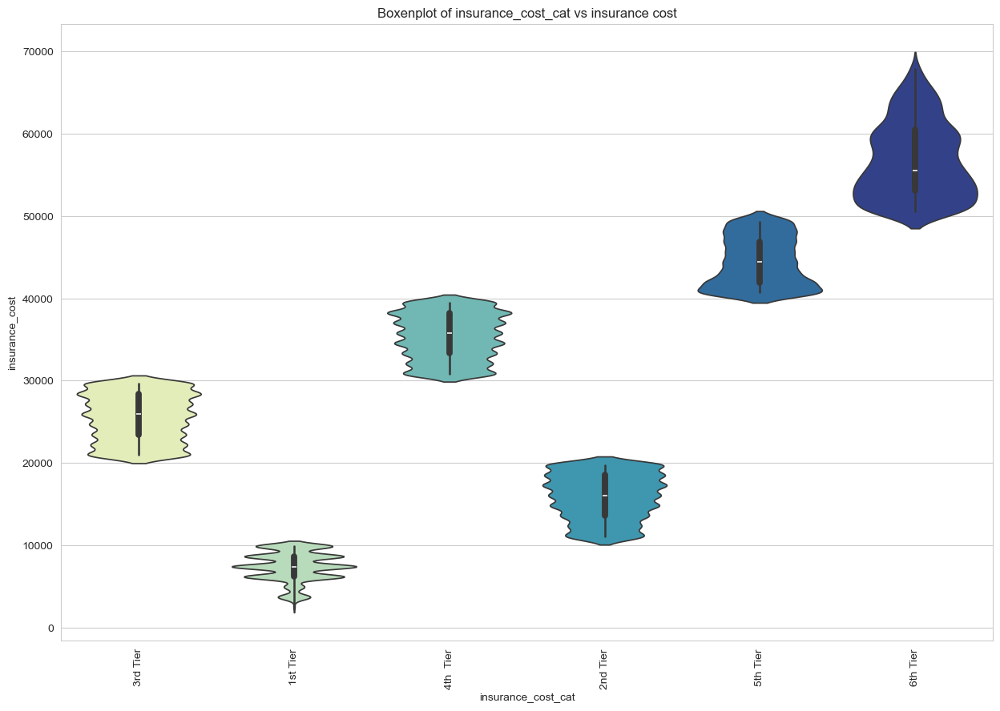

In [349]:
for i in inscost_ieda[cat]:
    plt.figure(figsize=(15,10))
    sns.violinplot(data=inscost_ieda,x=i,y='insurance_cost',palette='YlGnBu',width=0.8)
    plt.title('Boxenplot of {} vs insurance cost'.format(i))
    plt.xticks(rotation=90)
    plt.show();

Observations:

From the bivariate analysis of the target variable,i.e., insurance_cost, with the other categorical variables, the following are the observations:
- Those who have had 0 regular checkups last year have the highest median insurance cost
- Those who have had 5 or more than 5 regular checkups have the lowest insurance cost
- Those who engage in adventure sports have higher insurance cost than those who don't
- The median insurance cost is slightly lower in Ahmedabad and Bangalore when compared to that in other cities
- Those who have coverage from other insurance companies tend to have a higher insurance cost than those who don't
- As the weight change in the past year increases, the insurance cost decreases
- As the weight category increases, insurance cost also increases

In [390]:
import itertools

In [391]:
cat_pairs=list(itertools.combinations(cat,2))

In [392]:
num_pairs=list(itertools.combinations(num,2))

In [394]:
from statsmodels.graphics.mosaicplot import mosaic

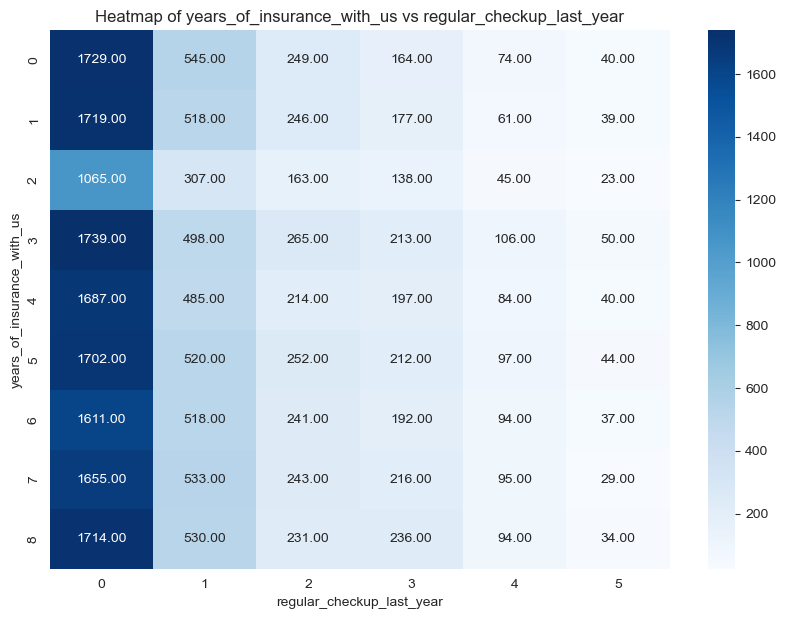

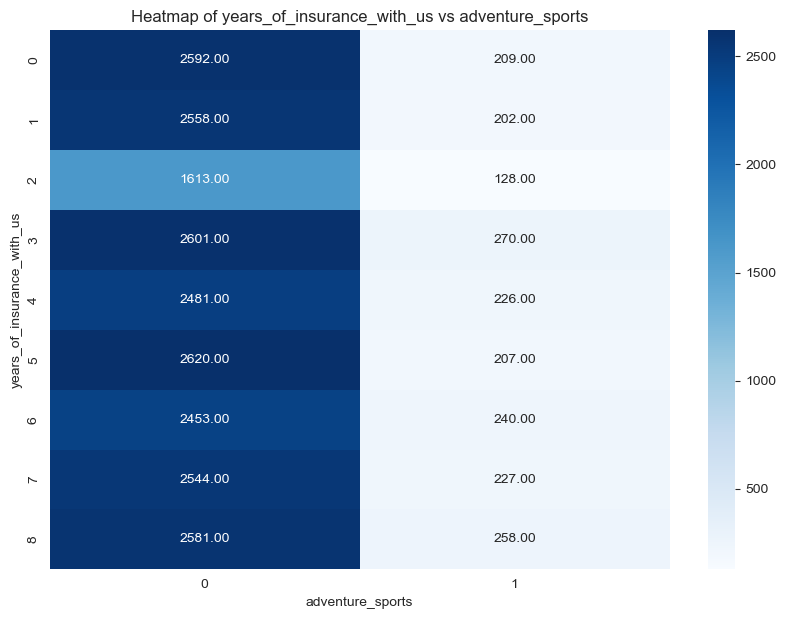

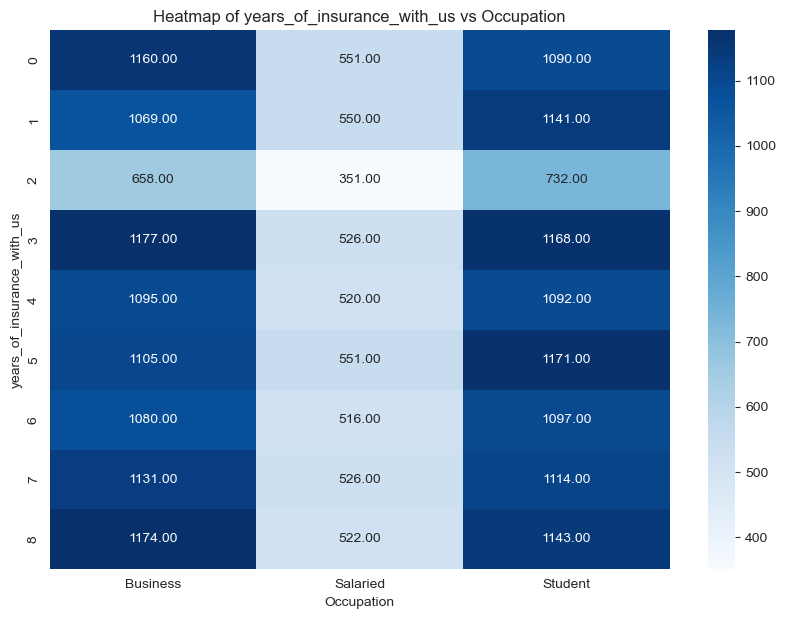

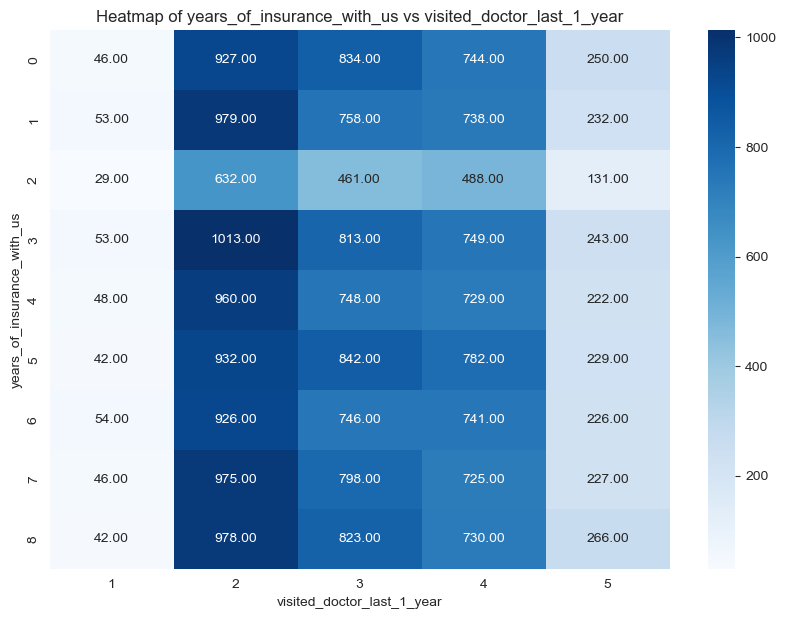

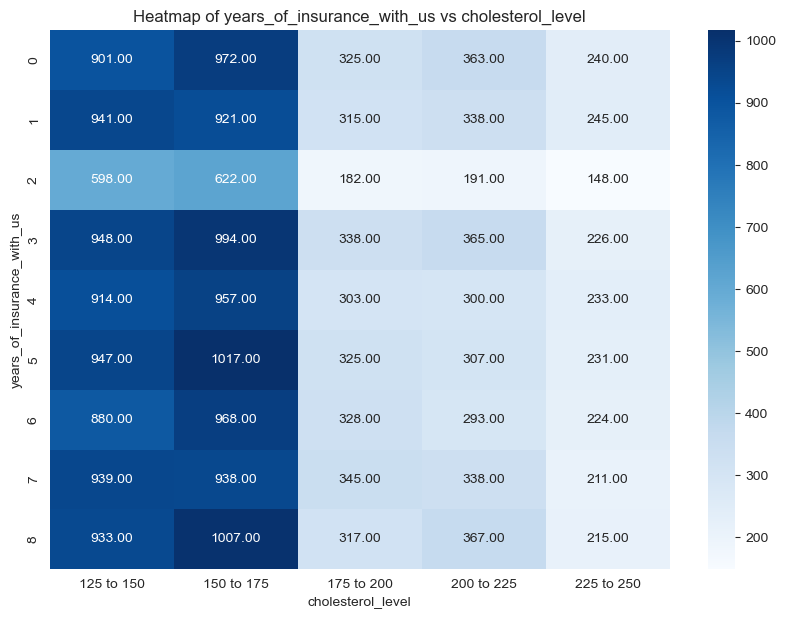

...

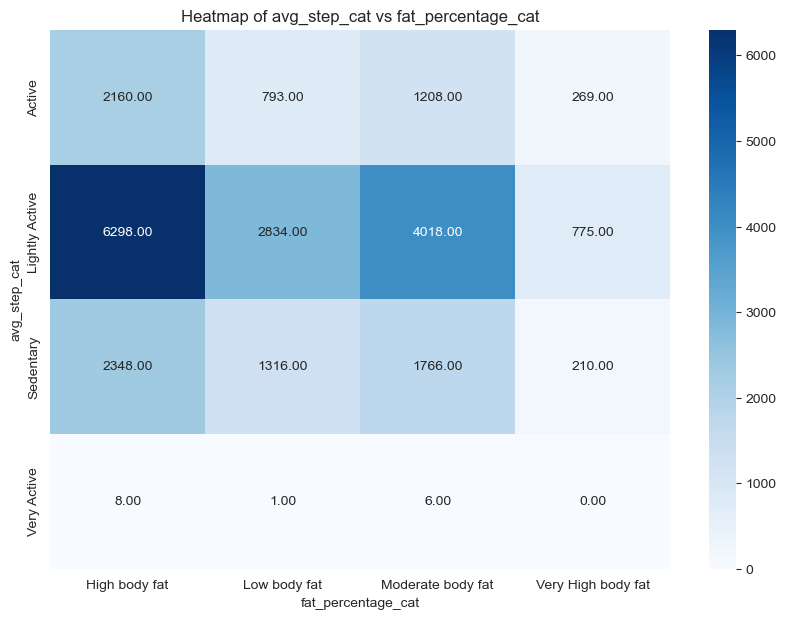

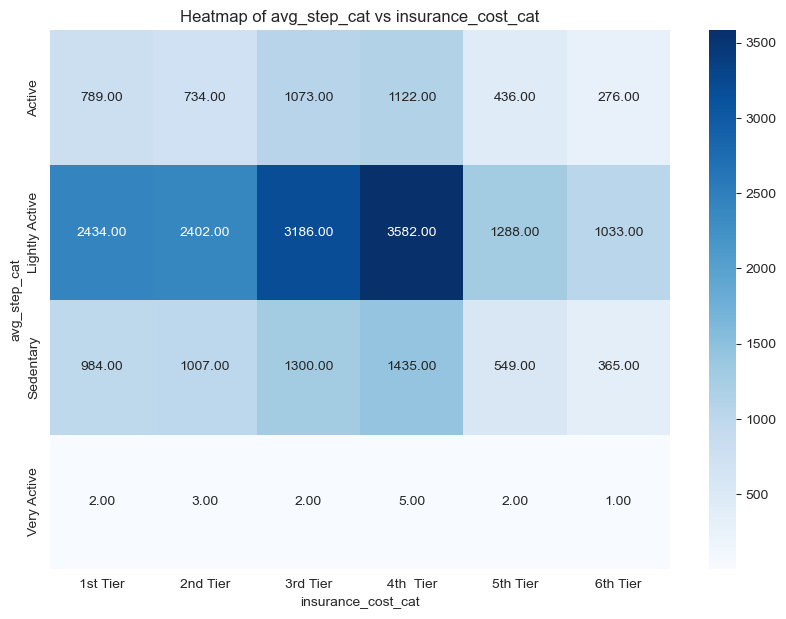

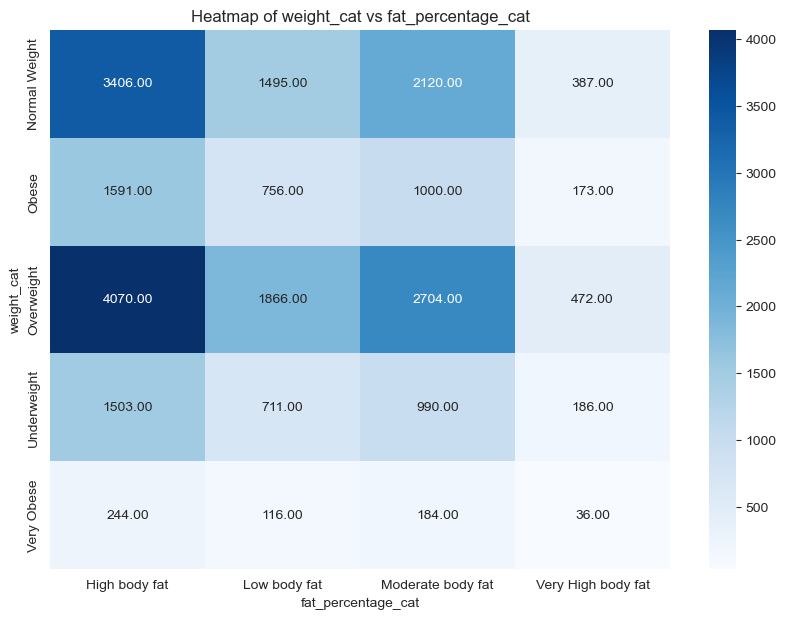

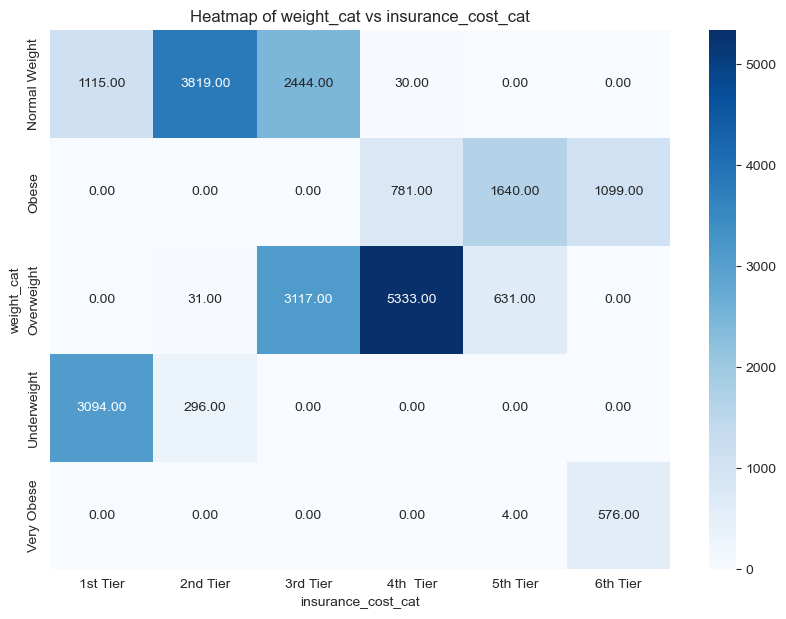

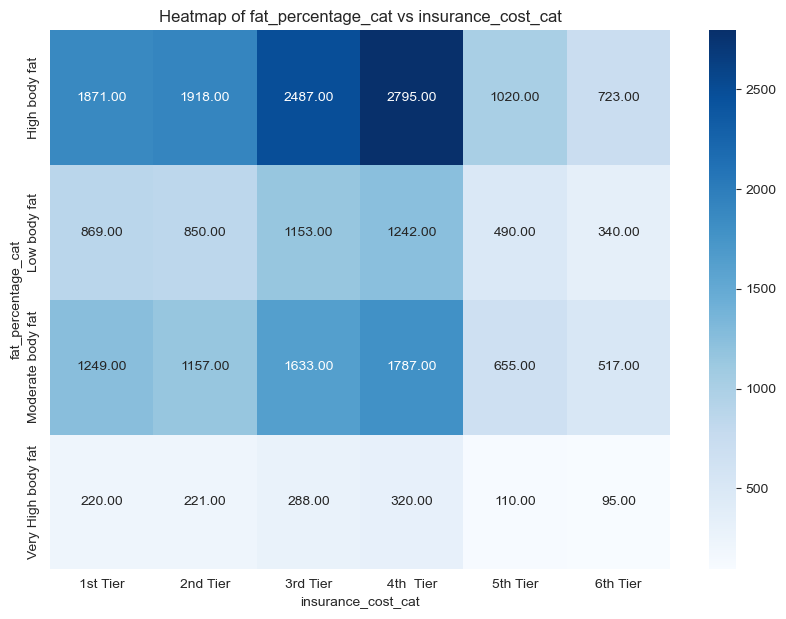

In [404]:
for i,j in cat_pairs:
    ct=pd.crosstab(index=inscost_ieda[i],columns=inscost_ieda[j])
    plt.figure(figsize=(10,7))
    sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')
    plt.title('Heatmap of {} vs {}'.format(i,j))
    plt.xlabel(j)
    plt.ylabel(i)
    plt.show();

Observations:
Heatmaps were plotted for a combination of each categorical variable with another. The following are the observations:
- The countplot patterns continue for each category
- 2801 people have less than 0 years insurance with us and are not being covered by any other company, which means they are new to the health insurance field.
- Around 13469 people have not had a regular checkup last year and are not into adventure sports. This is more than half the dataset size
- Students and Business people are more likely to have had 0 regular checkups last year
- Around 1/5th of the population have visited the doctor last year and have not had any regular checkups
- Most of the people who have not had regular checkup last year have a cholestrol level below 175
- More than half the population size have no major disease or heart disease and have not had regular checkup- these might be at risk of unknown medical issues. This might be a potential  risk.
- Around 10242 people have not had regular checkup and are not covered by any other company
- 1/3rd of the people have reported rare intake of alcohol, but have not had regular checkup
- Around 6000 people have reported a weight change of 3-4 and have not had regular checkup
- 5851 people are overweight, and have not had regular checkup. This might be a potential risk
- 6562 people have high body fat and have not had regular checkup
- No student has a cholestrol level over 175
- Business people are prone to high cholestrol levels 150-225
- Business people have reported the highest number of heart diseases, followed by students
- 5471 students have a high body fat
- Most of the people who visited the doctor last year 2-4 times have a cholestro; level below 175
- People with very High body fat,ie. fat_percentage from have cholestrol level greater than 200
- Almost half  of the females have reported an Unknown smoking status

<AxesSubplot:xlabel='cholesterol_level', ylabel='fat_percentage'>

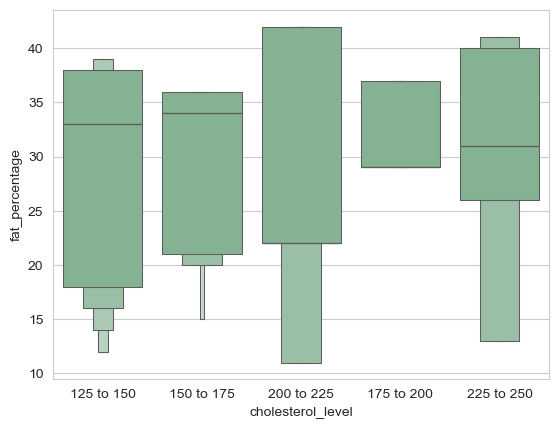

In [416]:
sns.boxenplot(data=inscost_ieda,x='cholesterol_level',y='fat_percentage')

### Multivariate Analysis

In [351]:
num_predictors=['daily_avg_steps',
 'age',
 'avg_glucose_level',
 'weight',
 'fat_percentage']

In [418]:
num_predictors_pairs=list(itertools.combinations(num_predictors,2))

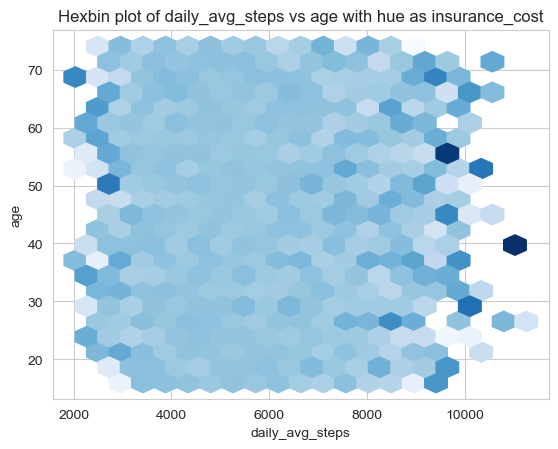

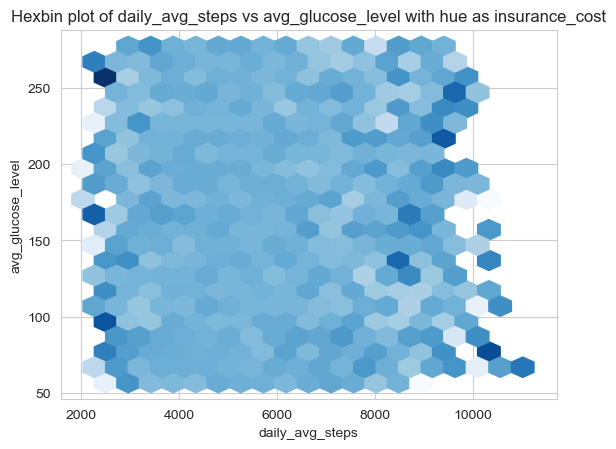

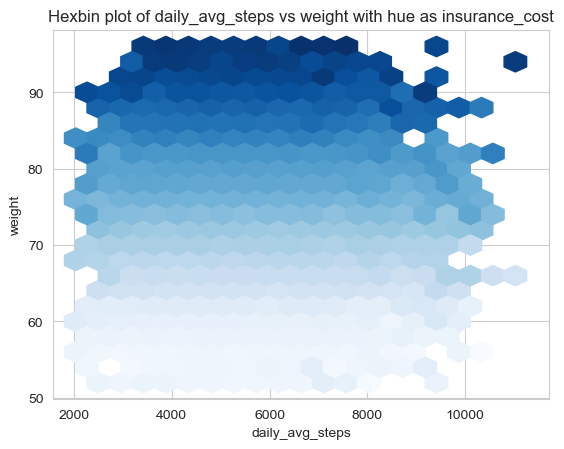

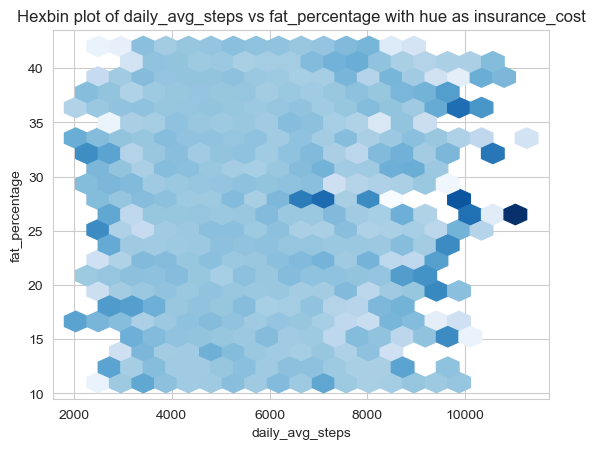

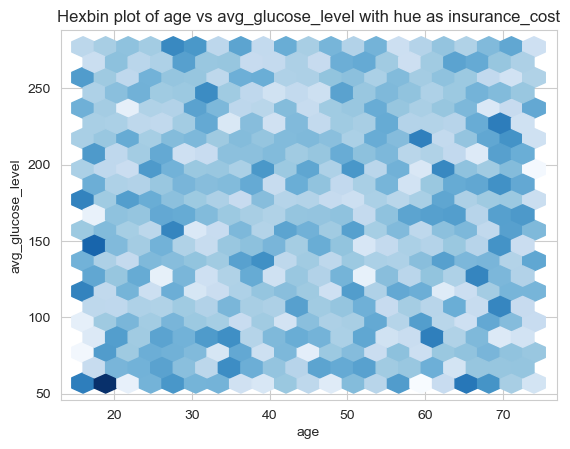

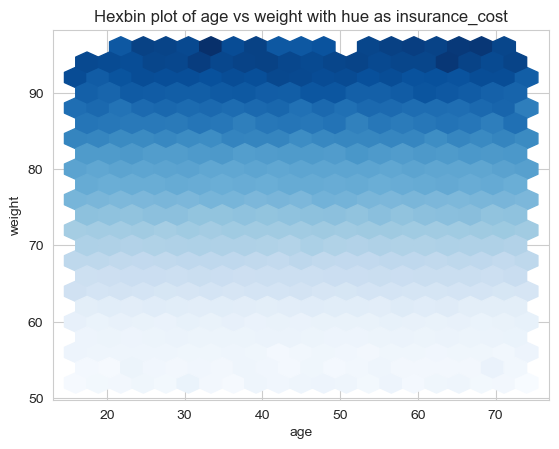

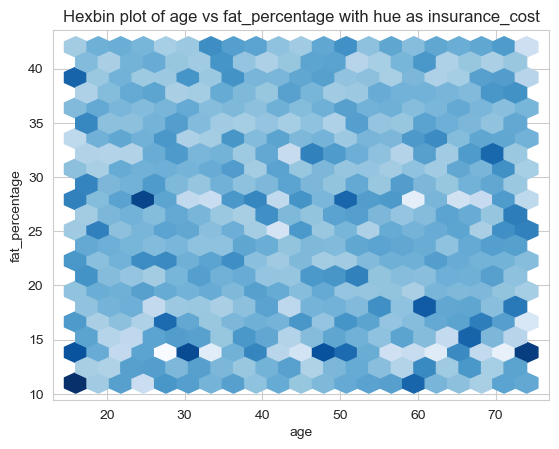

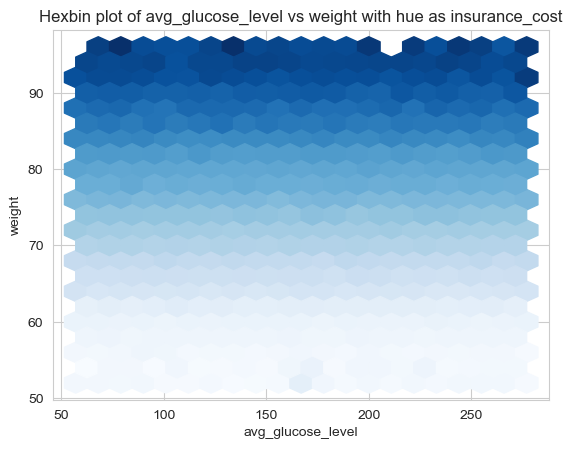

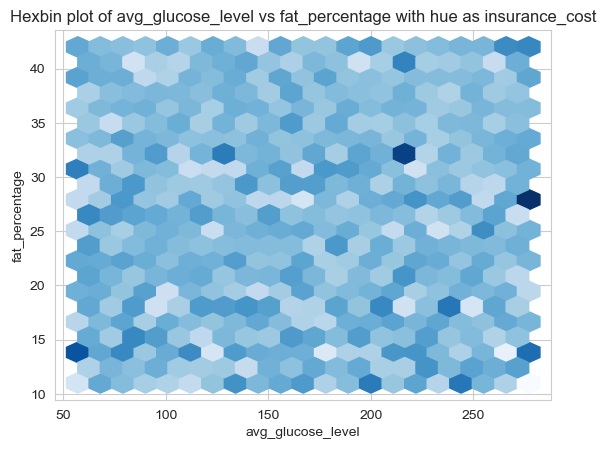

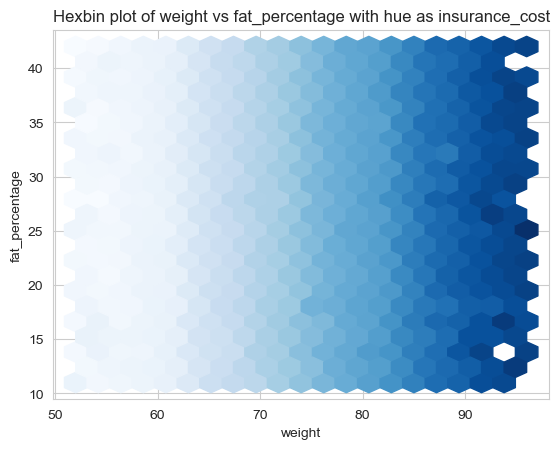

In [420]:
for i,j in num_predictors_pairs:
            plt.hexbin(inscost_ieda[i],inscost_ieda[j],gridsize=20,cmap='Blues',C=inscost_ieda['insurance_cost'])
            plt.title('Hexbin plot of {} vs {} with hue as insurance_cost'.format(i,j))
            plt.xlabel(i)
            plt.ylabel(j)
            plt.show();

Observations:
- Weight clearly seems to have a positive corrleation with insurance cost
- Other than this, the numerical variables do not seem to be correlated

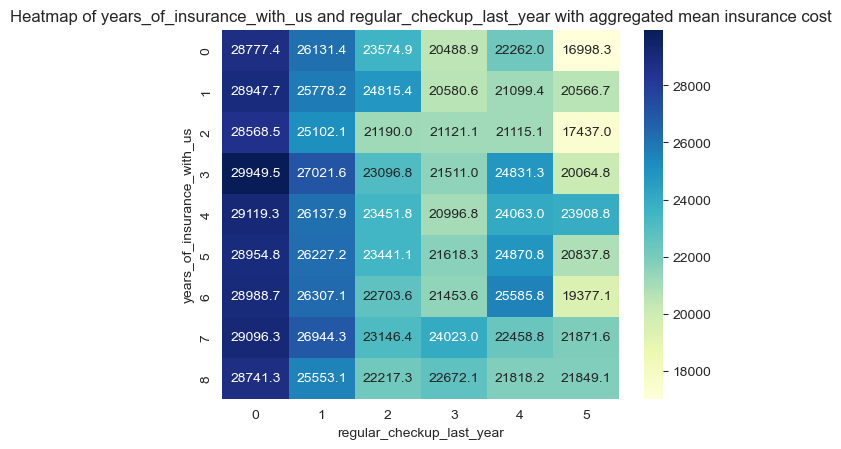

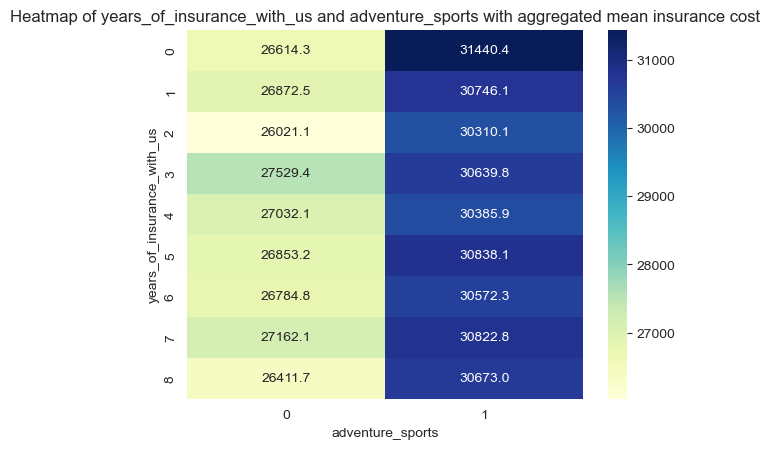

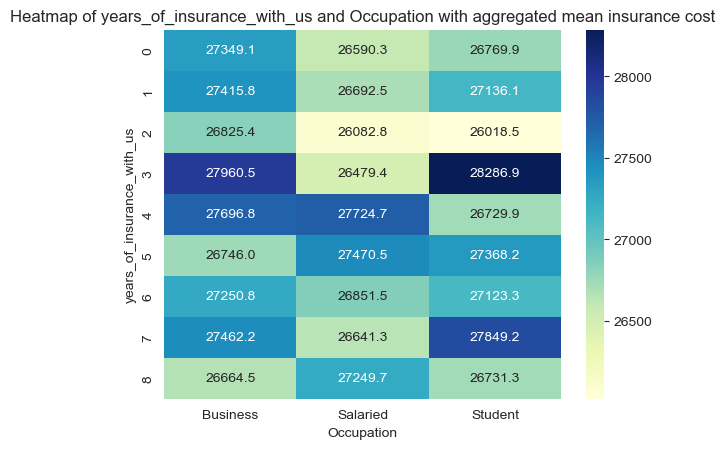

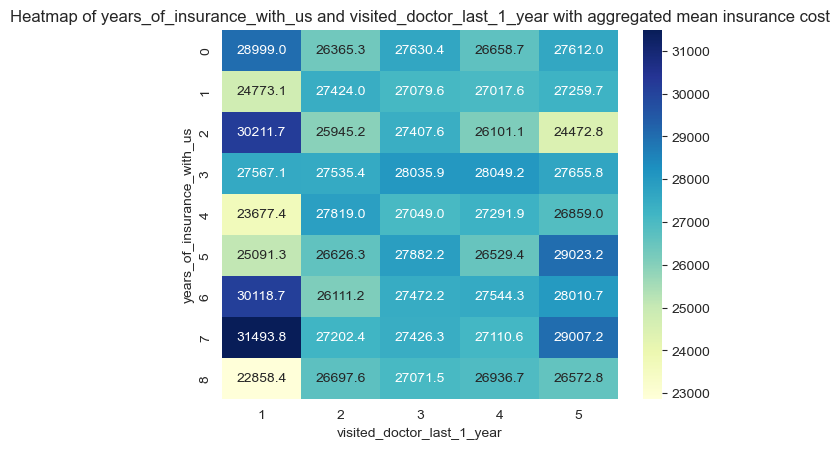

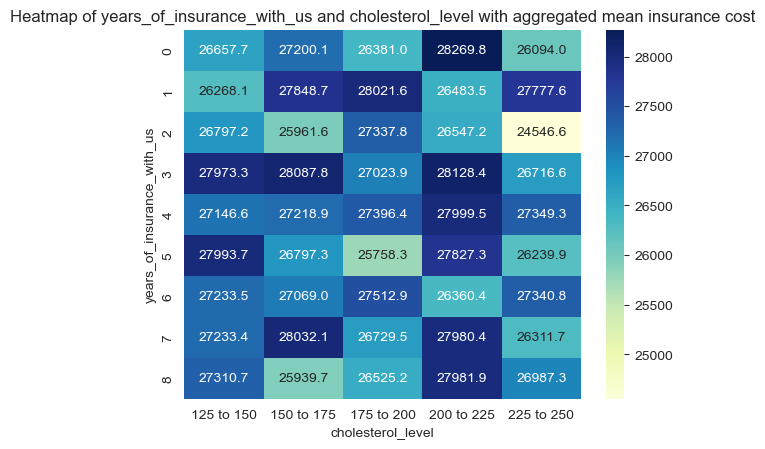

...

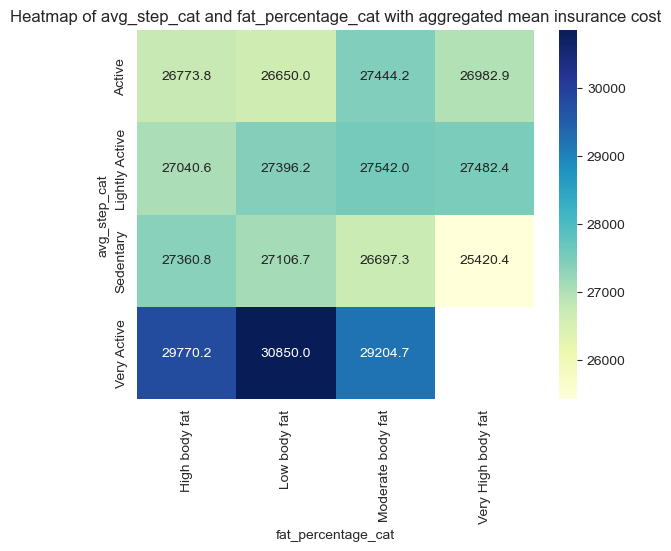

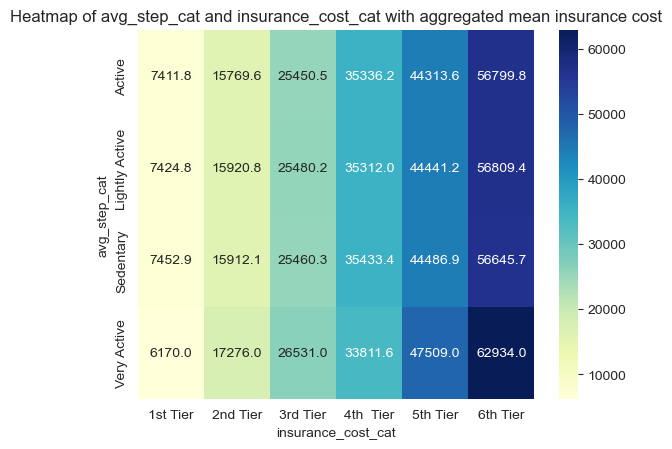

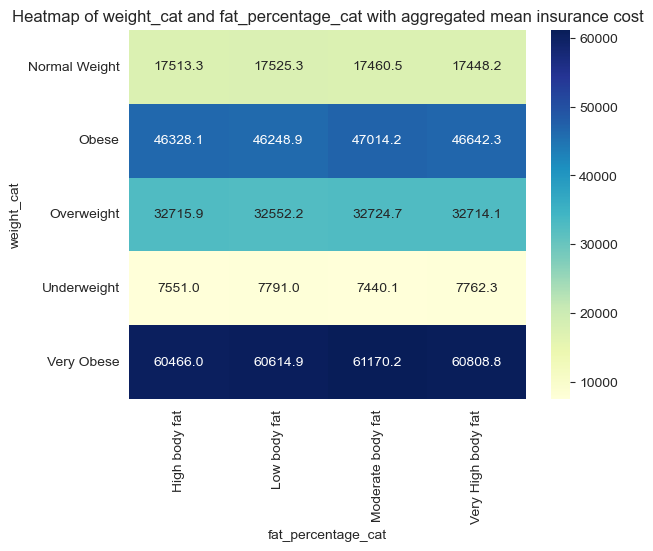

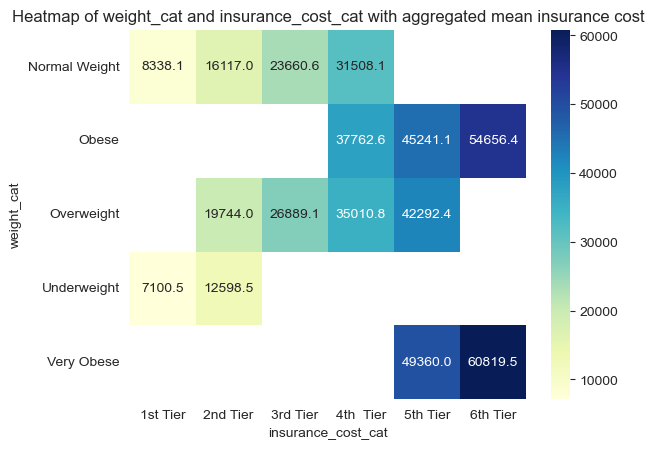

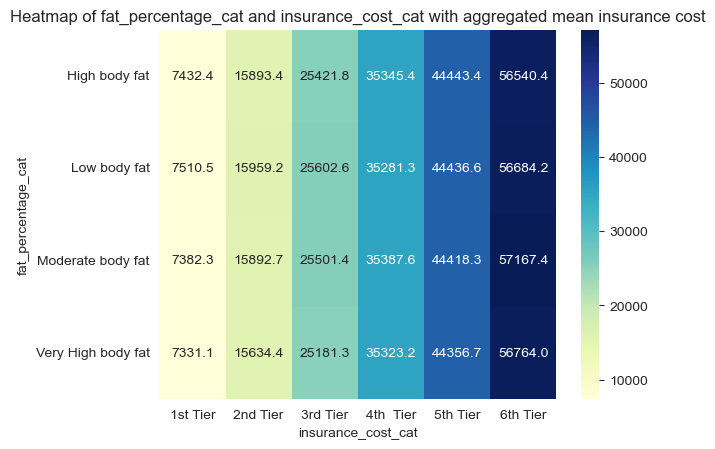

In [427]:
for i,j in cat_pairs:
            pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=i,columns=j,aggfunc='mean')
            sns.heatmap(pvt,cmap='YlGnBu',annot=True,fmt='.1f')
            plt.title('Heatmap of {} and {} with aggregated mean insurance cost'.format(i,j))
            plt.show();

Observations:
- People who have had 2 years insurance with us and have had 5 or more regular checkups habe low insurance cost
- People who have had 2 years insurance and are into adventure sports have the highest median insurance cost
- People who are covered by other insurance companies, ad have less number of years of insurance with us tend to have higher insurance costs
- People who are into adventure sports and have no regular checkups have high insurance cost
- People who have not had regular checkups, but have visited doctor for 5 times have the highest insurance mean
- People who have heart and other diseases, by have 5 or more regular checkups have low insurance cost
- People who do not consume alcohol, and have regular checkups have low insurance cost
- People who engage in adventure sporats and who have visited doctor more than 2 times have high insurance cost
- Business people with Very active walking habits havehigh insurance cost
- People who have a cholestertol level of 225-250 and have had heart disease hame higher insurance cost
- People who have a very active lifestyle based on the daily average steps, and have cholesterol ranging from 150-175 have a high mean insurance cost
- People who have a habit of daily alcohol consumption and have a very active lifestyle have a higher insurance cost
- Whne people belong to the very obese weight category, the insurance cost tier is 5 or above
- When they are underweight, their insurance tier is 2 or below

In [423]:
binry_pairs=list(itertools.combinations(binry,2))

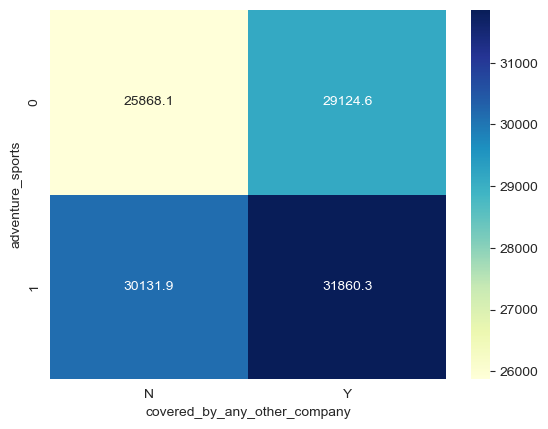

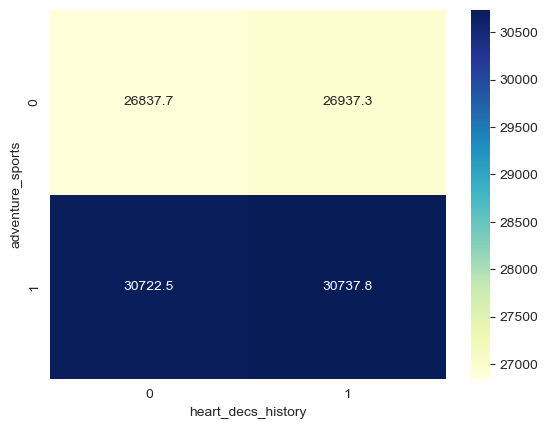

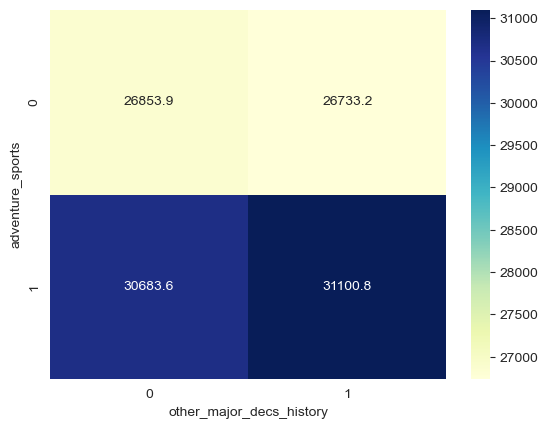

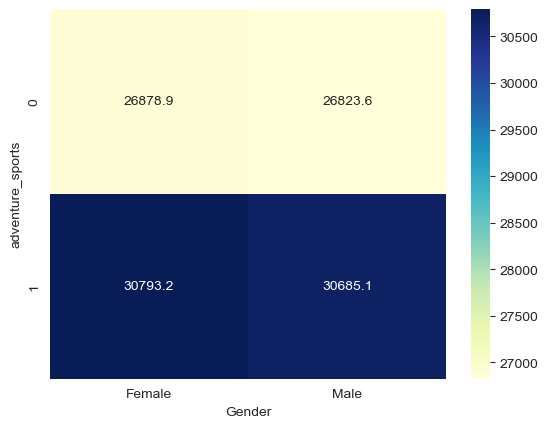

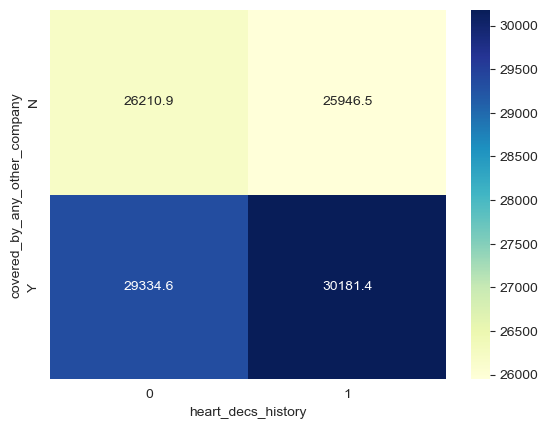

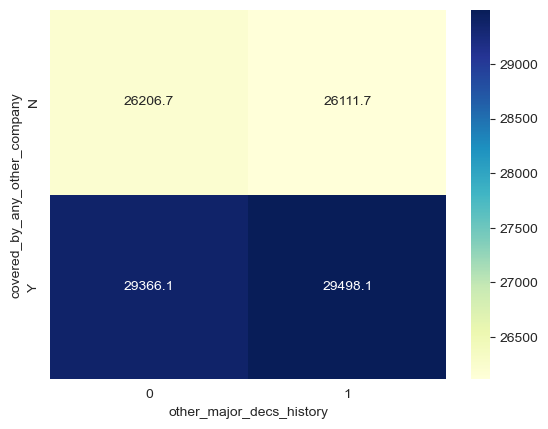

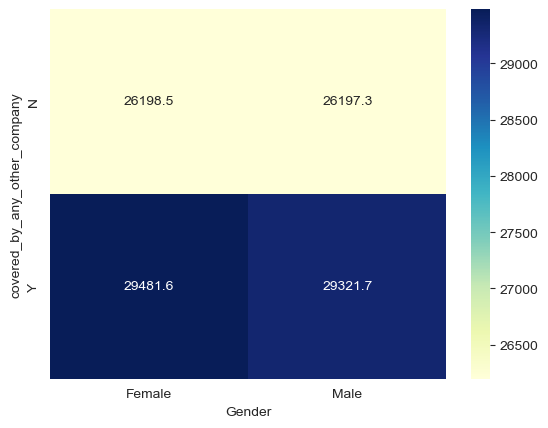

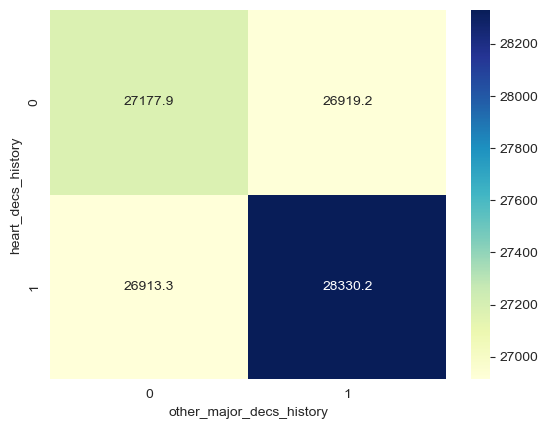

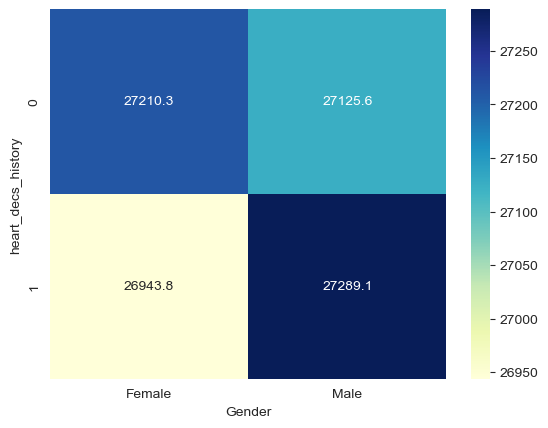

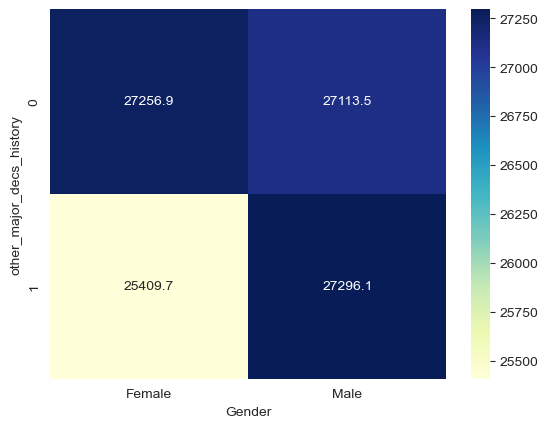

In [425]:
for i,j in binry_pairs:
            pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=i,columns=j,aggfunc='mean')
            sns.heatmap(pvt,cmap='YlGnBu',annot=True,fmt='.1f')
            plt.show();

Observations:

From the heatmaps generated by pivoting the binary categorical variables against one another  , and using mean as the aggreagte measuree observe that people who have a history of both heart disease and other major disease have a higher mean insurance cost

<AxesSubplot:xlabel='exercise-fat_percentage_cat', ylabel='Gender-smoking_status'>

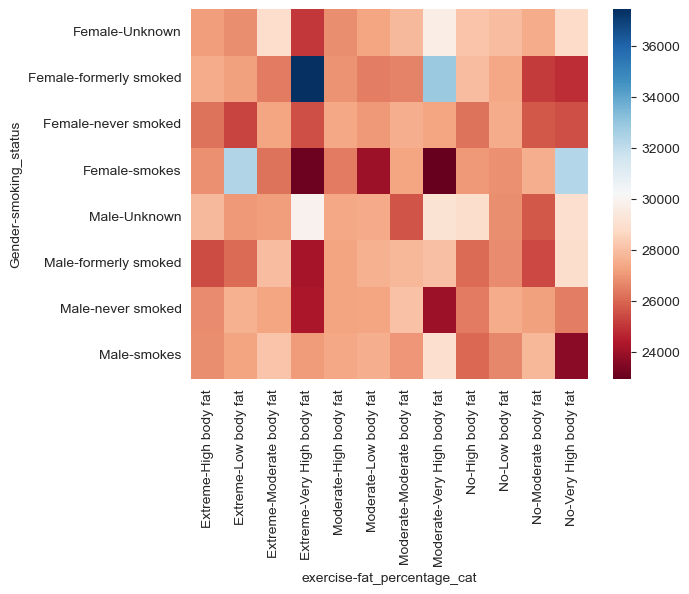

In [75]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['Gender','smoking_status'],columns=['exercise','fat_percentage_cat'])
sns.heatmap(pvt,cmap='RdBu')

<AxesSubplot:xlabel='exercise-fat_percentage_cat', ylabel='smoking_status'>

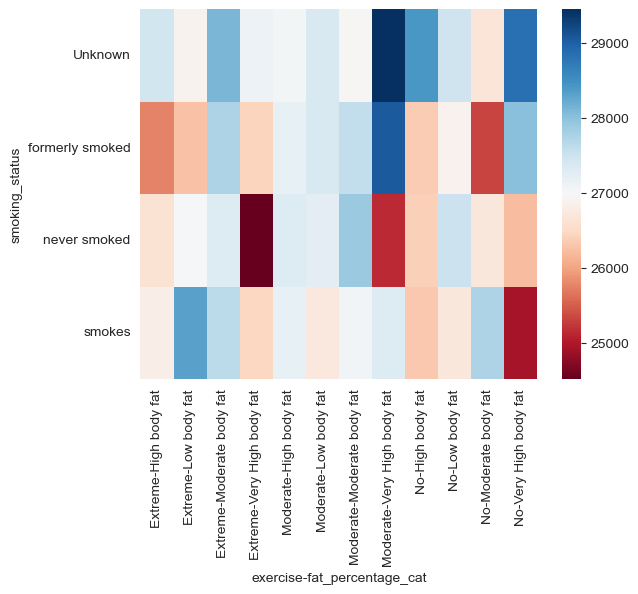

In [76]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['smoking_status'],columns=['exercise','fat_percentage_cat'])
sns.heatmap(pvt,cmap='RdBu')

<AxesSubplot:xlabel='exercise', ylabel='smoking_status'>

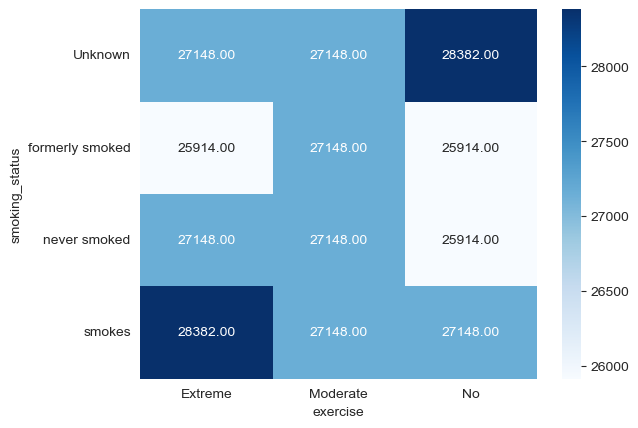

In [77]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['smoking_status'],columns=['exercise'],aggfunc='median')
sns.heatmap(pvt,cmap='Blues',annot=True,fmt='.2f')

<AxesSubplot:xlabel='Gender', ylabel='smoking_status'>

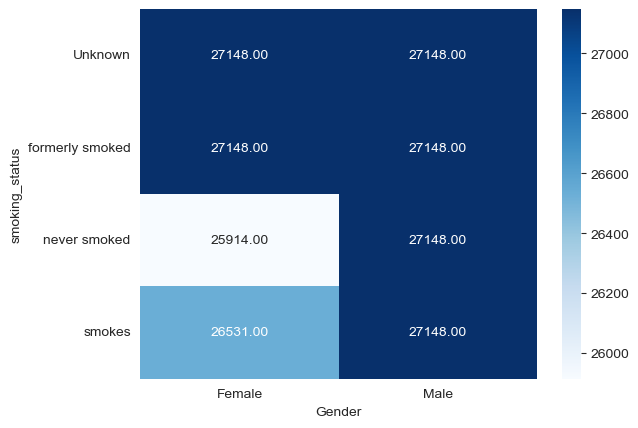

In [78]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['smoking_status'],columns=['Gender'],aggfunc='median')
sns.heatmap(pvt,cmap='Blues',annot=True,fmt='.2f')

<AxesSubplot:xlabel='smoking_status', ylabel='Gender'>

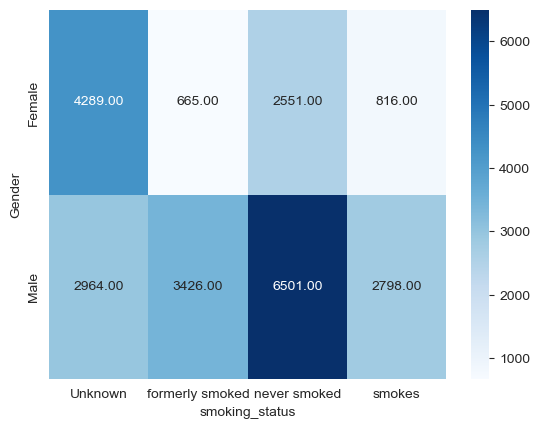

In [80]:
ct=pd.crosstab(index=inscost_ieda['Gender'],columns=inscost_ieda['smoking_status'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='weight_cat', ylabel='Gender'>

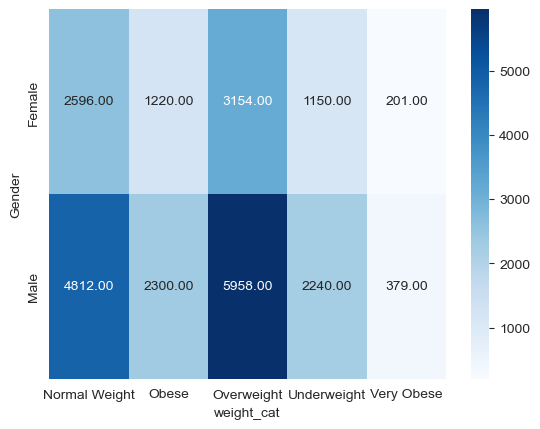

In [81]:
ct=pd.crosstab(index=inscost_ieda['Gender'],columns=inscost_ieda['weight_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='insurance_cost_cat', ylabel='Gender'>

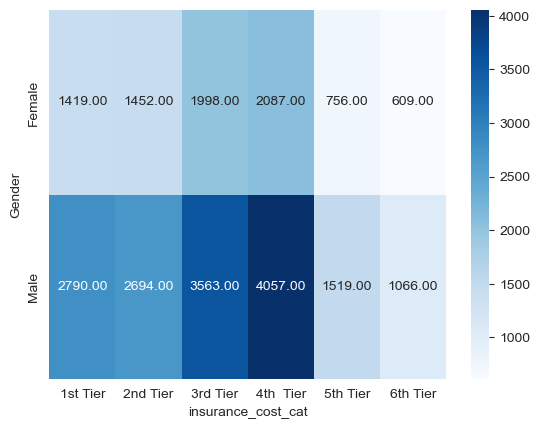

In [82]:
ct=pd.crosstab(index=inscost_ieda['Gender'],columns=inscost_ieda['insurance_cost_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='insurance_cost_cat', ylabel='weight_cat'>

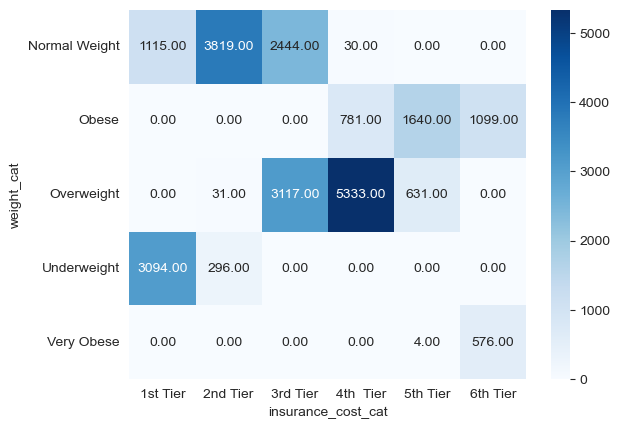

In [83]:
ct=pd.crosstab(index=inscost_ieda['weight_cat'],columns=inscost_ieda['insurance_cost_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='insurance_cost_cat', ylabel='covered_by_any_other_company'>

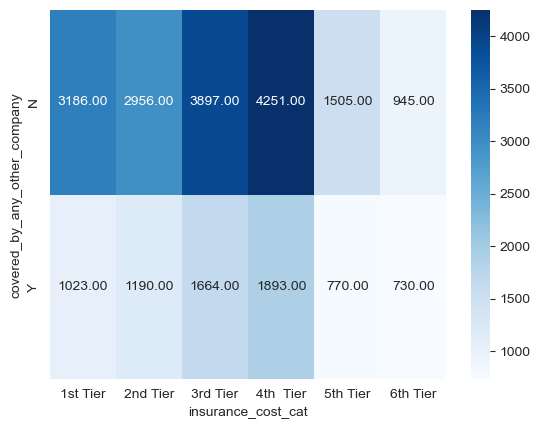

In [84]:
ct=pd.crosstab(index=inscost_ieda['covered_by_any_other_company'],columns=inscost_ieda['insurance_cost_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

## Scaling

In [85]:
inscost_i[num_cols].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,24010.0,5215.86,1053.56,2034.0,4543.0,5089.0,5730.75,11255.0
age,24010.0,44.92,16.09,16.0,31.0,45.0,59.00,74.0
avg_glucose_level,24010.0,167.53,62.73,57.0,113.0,168.0,222.00,277.0
weight,24010.0,71.62,9.33,52.0,64.0,72.0,78.00,96.0
fat_percentage,24010.0,28.82,8.63,11.0,21.0,31.0,36.00,42.0
insurance_cost,24010.0,27160.64,14332.04,2468.0,16042.0,27148.0,37020.00,67870.0


In [86]:
cols_to_scale=['daily_avg_steps',
 'age',
 'avg_glucose_level',
 'weight',
 'fat_percentage']

In [87]:
inscost_scaled=inscost_i[cols_to_scale]

In [88]:
from sklearn.preprocessing import StandardScaler

In [89]:
scaler=StandardScaler()

In [90]:
inscost_scaled=scaler.fit_transform(inscost_scaled)

In [91]:
inscost_scaled=pd.DataFrame(inscost_scaled,columns=cols_to_scale)

In [92]:
inscost_scaled

,daily_avg_steps,age,avg_glucose_level,weight,fat_percentage
0,-0.332085,-1.051680,-1.124469,-0.494891,-0.442882
1,1.134407,0.315844,0.708871,-1.459130,-0.211244
2,-0.670945,1.434727,-0.024465,0.147936,0.367853
3,0.947417,0.378004,-0.933164,-0.066340,0.946949
4,-0.263744,-0.057117,-0.789685,0.255074,0.599491
...,...,...,...,...,...
24005,0.264003,-0.119277,-1.507079,-1.137717,0.831130
24006,0.377906,-1.424641,-0.359249,0.790762,1.294407
24007,-0.471616,0.813126,-0.534612,-0.602028,-0.095424
24008,5.278553,-1.113840,-1.618674,0.255074,1.294407


In [93]:
inscost_no_scale=pd.DataFrame(inscost_i.copy())

In [94]:
inscost_no_scale.drop(cols_to_scale,axis=1,inplace=True)

In [95]:
inscost_no_scale

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,heart_decs_history,other_major_decs_history,Gender,bmi,smoking_status,Location,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,insurance_cost
0,3,1,1,Salaried,2,125 to 150,1,0,Male,31.2,Unknown,Chennai,N,Rare,Moderate,1,20978
1,0,0,0,Student,4,150 to 175,0,0,Male,34.2,formerly smoked,Jaipur,N,Rare,Moderate,3,6170
2,1,0,0,Business,4,200 to 225,0,0,Female,40.4,formerly smoked,Jaipur,N,Daily,Extreme,0,28382
3,7,4,0,Business,2,175 to 200,0,0,Female,22.9,Unknown,Chennai,Y,Rare,No,3,27148
4,3,1,0,Student,2,150 to 175,0,1,Male,26.5,never smoked,Bangalore,N,No,Extreme,0,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,0,0,Female,27.4,Unknown,Mumbai,N,Rare,Moderate,5,13574
24995,3,0,0,Salaried,4,225 to 250,0,0,Male,36.1,smokes,Kanpur,Y,Rare,Moderate,4,39488
24996,6,0,0,Business,4,200 to 225,0,0,Male,31.3,never smoked,Kanpur,N,Rare,Moderate,2,14808
24998,1,0,0,Salaried,2,225 to 250,0,0,Male,26.6,Unknown,Surat,N,Rare,Moderate,0,30850


In [96]:
inscost_no_scale.columns

Index(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'heart_decs_history', 'other_major_decs_history',
       'Gender', 'bmi', 'smoking_status', 'Location',
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'insurance_cost'],
      dtype='object')

In [97]:
inscost_scaled.columns

Index(['daily_avg_steps', 'age', 'avg_glucose_level', 'weight',
       'fat_percentage'],
      dtype='object')

In [98]:
colms=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'heart_decs_history', 'other_major_decs_history',
       'Gender', 'bmi', 'smoking_status', 'Location',
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'insurance_cost','daily_avg_steps', 'age', 'avg_glucose_level', 'weight',
       'fat_percentage']

In [99]:
inscost_no_scale.reset_index(drop=True, inplace=True)
inscost_scaled.reset_index(drop=True, inplace=True)
inscost_is = pd.concat([inscost_no_scale, inscost_scaled], axis=1, ignore_index=True)

In [100]:
inscost_is.columns=colms

In [101]:
inscost_is

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,heart_decs_history,other_major_decs_history,Gender,bmi,smoking_status,Location,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,insurance_cost,daily_avg_steps,age,avg_glucose_level,weight,fat_percentage
0,3,1,1,Salaried,2,125 to 150,1,0,Male,31.2,Unknown,Chennai,N,Rare,Moderate,1,20978,-0.332085,-1.051680,-1.124469,-0.494891,-0.442882
1,0,0,0,Student,4,150 to 175,0,0,Male,34.2,formerly smoked,Jaipur,N,Rare,Moderate,3,6170,1.134407,0.315844,0.708871,-1.459130,-0.211244
2,1,0,0,Business,4,200 to 225,0,0,Female,40.4,formerly smoked,Jaipur,N,Daily,Extreme,0,28382,-0.670945,1.434727,-0.024465,0.147936,0.367853
3,7,4,0,Business,2,175 to 200,0,0,Female,22.9,Unknown,Chennai,Y,Rare,No,3,27148,0.947417,0.378004,-0.933164,-0.066340,0.946949
4,3,1,0,Student,2,150 to 175,0,1,Male,26.5,never smoked,Bangalore,N,No,Extreme,0,29616,-0.263744,-0.057117,-0.789685,0.255074,0.599491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,0,Business,3,150 to 175,0,0,Female,27.4,Unknown,Mumbai,N,Rare,Moderate,5,13574,0.264003,-0.119277,-1.507079,-1.137717,0.831130
24006,3,0,0,Salaried,4,225 to 250,0,0,Male,36.1,smokes,Kanpur,Y,Rare,Moderate,4,39488,0.377906,-1.424641,-0.359249,0.790762,1.294407
24007,6,0,0,Business,4,200 to 225,0,0,Male,31.3,never smoked,Kanpur,N,Rare,Moderate,2,14808,-0.471616,0.813126,-0.534612,-0.602028,-0.095424
24008,1,0,0,Salaried,2,225 to 250,0,0,Male,26.6,Unknown,Surat,N,Rare,Moderate,0,30850,5.278553,-1.113840,-1.618674,0.255074,1.294407


In [102]:
inscost_i

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,5494,43,0,0,Female,73,27.4,Unknown,Mumbai,61,N,Rare,Moderate,5,36,13574
24995,3,0,0,Salaried,4,225 to 250,5614,22,0,0,Male,145,36.1,smokes,Kanpur,79,Y,Rare,Moderate,4,40,39488
24996,6,0,0,Business,4,200 to 225,4719,58,0,0,Male,134,31.3,never smoked,Kanpur,66,N,Rare,Moderate,2,28,14808
24998,1,0,0,Salaried,2,225 to 250,10777,27,0,0,Male,66,26.6,Unknown,Surat,74,N,Rare,Moderate,0,40,30850


In [103]:
col_order=inscost_i.columns

In [104]:
inscost_is=inscost_is[col_order]

In [105]:
inscost_is.head()

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,-0.332085,-1.051680,1,0,Male,-1.124469,31.2,Unknown,Chennai,-0.494891,N,Rare,Moderate,1,-0.442882,20978
1,0,0,0,Student,4,150 to 175,1.134407,0.315844,0,0,Male,0.708871,34.2,formerly smoked,Jaipur,-1.459130,N,Rare,Moderate,3,-0.211244,6170
2,1,0,0,Business,4,200 to 225,-0.670945,1.434727,0,0,Female,-0.024465,40.4,formerly smoked,Jaipur,0.147936,N,Daily,Extreme,0,0.367853,28382
3,7,4,0,Business,2,175 to 200,0.947417,0.378004,0,0,Female,-0.933164,22.9,Unknown,Chennai,-0.066340,Y,Rare,No,3,0.946949,27148
4,3,1,0,Student,2,150 to 175,-0.263744,-0.057117,0,1,Male,-0.789685,26.5,never smoked,Bangalore,0.255074,N,No,Extreme,0,0.599491,29616


In [106]:
inscost.shape

(25000, 24)

In [107]:
inscost_is.shape

(24010, 22)

## Outlier Treatment

<AxesSubplot:>

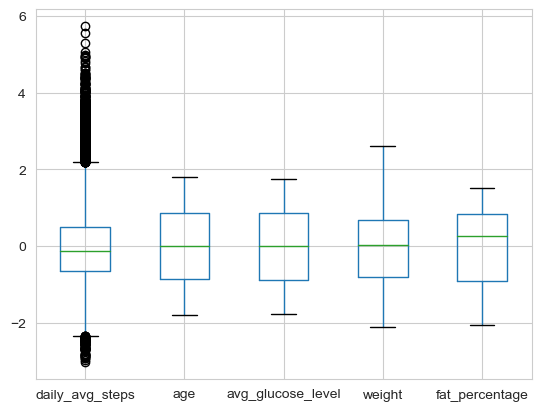

In [108]:
inscost_is[cols_to_scale].boxplot()

In [109]:
outlier_cols=['daily_avg_steps']

In [110]:
Q1 = inscost_is[num].quantile(0.25)
Q3 = inscost_is[num].quantile(0.75)
IQR = Q3 - Q1
UL = Q3 + 1.5*IQR
LL = Q1 - 1.5*IQR

In [111]:
((inscost_is[num]>UL)|(inscost_is[num]<LL)).sum()

daily_avg_steps      899
age                    0
avg_glucose_level      0
weight                 0
fat_percentage         0
insurance_cost         0
dtype: int64

In [112]:
899/24010

0.03744273219491878

In [113]:
def treat_outlier(x):
    q1=np.percentile(x,25)
    q3=np.percentile(x,75)
    IQR=q3-q1
    ll=q1-(1.5*IQR)
    ul=q3+(1.5*IQR)
    return x.apply(lambda y:ll if y<ll else y).apply(lambda y:ul if y>ul else y)

In [114]:
inscost_iso=pd.DataFrame(inscost_is.copy())

In [115]:
inscost_iso

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,-0.332085,-1.051680,1,0,Male,-1.124469,31.2,Unknown,Chennai,-0.494891,N,Rare,Moderate,1,-0.442882,20978
1,0,0,0,Student,4,150 to 175,1.134407,0.315844,0,0,Male,0.708871,34.2,formerly smoked,Jaipur,-1.459130,N,Rare,Moderate,3,-0.211244,6170
2,1,0,0,Business,4,200 to 225,-0.670945,1.434727,0,0,Female,-0.024465,40.4,formerly smoked,Jaipur,0.147936,N,Daily,Extreme,0,0.367853,28382
3,7,4,0,Business,2,175 to 200,0.947417,0.378004,0,0,Female,-0.933164,22.9,Unknown,Chennai,-0.066340,Y,Rare,No,3,0.946949,27148
4,3,1,0,Student,2,150 to 175,-0.263744,-0.057117,0,1,Male,-0.789685,26.5,never smoked,Bangalore,0.255074,N,No,Extreme,0,0.599491,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,0,Business,3,150 to 175,0.264003,-0.119277,0,0,Female,-1.507079,27.4,Unknown,Mumbai,-1.137717,N,Rare,Moderate,5,0.831130,13574
24006,3,0,0,Salaried,4,225 to 250,0.377906,-1.424641,0,0,Male,-0.359249,36.1,smokes,Kanpur,0.790762,Y,Rare,Moderate,4,1.294407,39488
24007,6,0,0,Business,4,200 to 225,-0.471616,0.813126,0,0,Male,-0.534612,31.3,never smoked,Kanpur,-0.602028,N,Rare,Moderate,2,-0.095424,14808
24008,1,0,0,Salaried,2,225 to 250,5.278553,-1.113840,0,0,Male,-1.618674,26.6,Unknown,Surat,0.255074,N,Rare,Moderate,0,1.294407,30850


In [116]:
inscost_iso['daily_avg_steps']=treat_outlier(inscost_iso['daily_avg_steps'])

<AxesSubplot:>

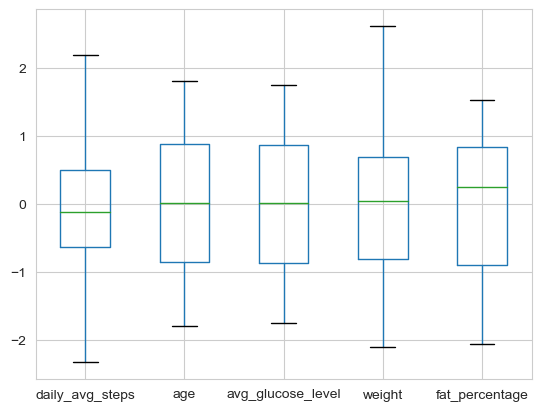

In [117]:
inscost_iso[cols_to_scale].boxplot()

In [430]:
inscost_iso.describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
years_of_insurance_with_us,24010.0,4.09,2.61,0.00,2.00,4.00,6.00,8.00
regular_checkup_last_year,24010.0,0.77,1.20,0.00,0.00,0.00,1.00,5.00
adventure_sports,24010.0,0.08,0.27,0.00,0.00,0.00,0.00,1.00
visited_doctor_last_1_year,24010.0,3.11,1.14,0.00,2.00,3.00,4.00,12.00
daily_avg_steps,24010.0,-0.03,0.92,-2.33,-0.64,-0.12,0.49,2.18
age,24010.0,-0.00,1.00,-1.80,-0.87,0.01,0.88,1.81
heart_decs_history,24010.0,0.05,0.22,0.00,0.00,0.00,0.00,1.00
other_major_decs_history,24010.0,0.09,0.29,0.00,0.00,0.00,0.00,1.00
avg_glucose_level,24010.0,-0.00,1.00,-1.76,-0.87,0.01,0.87,1.75
bmi,24010.0,31.39,7.88,12.30,26.10,30.50,35.60,100.60


## Encoding- Transformation

In [118]:
inscost_isoen=pd.DataFrame(inscost_iso.copy())

In [119]:
ohe_cols=['Occupation', 'cholesterol_level', 'Gender', 'smoking_status',
       'Location', 'covered_by_any_other_company', 'Alcohol', 'exercise']

In [120]:
nenc_cols=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports',  'visited_doctor_last_1_year',
        'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history',  'avg_glucose_level', 'bmi',
        'weight',  'weight_change_in_last_one_year',
       'fat_percentage', 'insurance_cost']

In [121]:
onehot_enc_cols=pd.get_dummies(inscost_isoen[ohe_cols],drop_first=True)

In [122]:
inscost_isoen=pd.concat([inscost_isoen[nenc_cols],onehot_enc_cols],axis=1)

In [123]:
column_order=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'visited_doctor_last_1_year', 'daily_avg_steps',
       'age', 'heart_decs_history', 'other_major_decs_history',
       'avg_glucose_level', 'bmi', 'weight', 'weight_change_in_last_one_year',
       'fat_percentage', 'Occupation_Salaried',
       'Occupation_Student', 'cholesterol_level_150 to 175',
       'cholesterol_level_175 to 200', 'cholesterol_level_200 to 225',
       'cholesterol_level_225 to 250', 'Gender_Male',
       'smoking_status_formerly smoked', 'smoking_status_never smoked',
       'smoking_status_smokes', 'Location_Bangalore', 'Location_Bhubaneswar',
       'Location_Chennai', 'Location_Delhi', 'Location_Guwahati',
       'Location_Jaipur', 'Location_Kanpur', 'Location_Kolkata',
       'Location_Lucknow', 'Location_Mangalore', 'Location_Mumbai',
       'Location_Nagpur', 'Location_Pune', 'Location_Surat',
       'covered_by_any_other_company_Y', 'Alcohol_No', 'Alcohol_Rare',
       'exercise_Moderate', 'exercise_No', 'insurance_cost']

In [124]:
inscost_isoen=inscost_isoen[column_order]

In [125]:
inscost_isoen

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,visited_doctor_last_1_year,daily_avg_steps,age,heart_decs_history,other_major_decs_history,avg_glucose_level,bmi,weight,weight_change_in_last_one_year,fat_percentage,Occupation_Salaried,Occupation_Student,cholesterol_level_150 to 175,cholesterol_level_175 to 200,cholesterol_level_200 to 225,cholesterol_level_225 to 250,Gender_Male,smoking_status_formerly smoked,smoking_status_never smoked,smoking_status_smokes,Location_Bangalore,Location_Bhubaneswar,Location_Chennai,Location_Delhi,Location_Guwahati,Location_Jaipur,Location_Kanpur,Location_Kolkata,Location_Lucknow,Location_Mangalore,Location_Mumbai,Location_Nagpur,Location_Pune,Location_Surat,covered_by_any_other_company_Y,Alcohol_No,Alcohol_Rare,exercise_Moderate,exercise_No,insurance_cost
0,3,1,1,2,-0.332085,-1.051680,1,0,-1.124469,31.2,-0.494891,1,-0.442882,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,20978
1,0,0,0,4,1.134407,0.315844,0,0,0.708871,34.2,-1.459130,3,-0.211244,0,1,1,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,6170
2,1,0,0,4,-0.670945,1.434727,0,0,-0.024465,40.4,0.147936,0,0.367853,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,28382
3,7,4,0,2,0.947417,0.378004,0,0,-0.933164,22.9,-0.066340,3,0.946949,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,27148
4,3,1,0,2,-0.263744,-0.057117,0,1,-0.789685,26.5,0.255074,0,0.599491,0,1,1,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,0,3,0.264003,-0.119277,0,0,-1.507079,27.4,-1.137717,5,0.831130,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,13574
24006,3,0,0,4,0.377906,-1.424641,0,0,-0.359249,36.1,0.790762,4,1.294407,1,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,1,0,39488
24007,6,0,0,4,-0.471616,0.813126,0,0,-0.534612,31.3,-0.602028,2,-0.095424,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,14808
24008,1,0,0,2,2.179817,-1.113840,0,0,-1.618674,26.6,0.255074,0,1.294407,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,30850


## Recursive Feature Elimination

In [168]:
from sklearn.feature_selection import RFE

In [169]:
inscost_isoenrfe=pd.DataFrame(inscost_isoen.copy())

In [250]:
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier

In [174]:
X_RFE=inscost_isoenrfe.drop('insurance_cost',axis=1)
Y_RFE=inscost_isoenrfe['insurance_cost']

In [251]:
rfr_rfe=RandomForestClassifier()

In [252]:
selector=RFE(estimator=rfr_rfe,n_features_to_select=12,step=1)

In [253]:
selector.fit(X_RFE,Y_RFE)

RFE(estimator=RandomForestClassifier(), n_features_to_select=12)

In [254]:
selector.n_features_

12

In [255]:
selector.ranking_

array([ 1,  1, 30,  1,  1,  1, 31, 11,  1,  1,  1,  1,  1, 10,  3,  5, 22,
       12, 29,  4,  9,  2,  8, 15, 16, 18, 20, 17, 14, 24, 26, 25, 13, 19,
       27, 21, 28, 23,  6,  1,  1,  7])

In [256]:
rfe_df=pd.DataFrame({'Features':X_RFE.columns,'Rank':selector.ranking_})
rfe_df

,Features,Rank
0,years_of_insurance_with_us,1
1,regular_checkup_last_year,1
2,adventure_sports,30
3,visited_doctor_last_1_year,1
4,daily_avg_steps,1
5,age,1
6,heart_decs_history,31
7,other_major_decs_history,11
8,avg_glucose_level,1
9,bmi,1


In [257]:
rfe_sel_df=rfe_df[rfe_df['Rank']==1]

In [258]:
rfe_sel_df

,Features,Rank
0,years_of_insurance_with_us,1
1,regular_checkup_last_year,1
3,visited_doctor_last_1_year,1
4,daily_avg_steps,1
5,age,1
8,avg_glucose_level,1
9,bmi,1
10,weight,1
11,weight_change_in_last_one_year,1
12,fat_percentage,1


In [259]:
selected_features=[]
selected_features=rfe_sel_df['Features'].values

In [260]:
selected_features

array(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'visited_doctor_last_1_year', 'daily_avg_steps', 'age',
       'avg_glucose_level', 'bmi', 'weight',
       'weight_change_in_last_one_year', 'fat_percentage', 'Alcohol_Rare',
       'exercise_Moderate'], dtype=object)

## Clustering

In [261]:
inscost_clip=pd.DataFrame(inscost_isoen[selected_features])

In [262]:
inscost_clip

,years_of_insurance_with_us,regular_checkup_last_year,visited_doctor_last_1_year,daily_avg_steps,age,avg_glucose_level,bmi,weight,weight_change_in_last_one_year,fat_percentage,Alcohol_Rare,exercise_Moderate
0,3,1,2,-0.332085,-1.051680,-1.124469,31.2,-0.494891,1,-0.442882,1,1
1,0,0,4,1.134407,0.315844,0.708871,34.2,-1.459130,3,-0.211244,1,1
2,1,0,4,-0.670945,1.434727,-0.024465,40.4,0.147936,0,0.367853,0,0
3,7,4,2,0.947417,0.378004,-0.933164,22.9,-0.066340,3,0.946949,1,0
4,3,1,2,-0.263744,-0.057117,-0.789685,26.5,0.255074,0,0.599491,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,3,0.264003,-0.119277,-1.507079,27.4,-1.137717,5,0.831130,1,1
24006,3,0,4,0.377906,-1.424641,-0.359249,36.1,0.790762,4,1.294407,1,1
24007,6,0,4,-0.471616,0.813126,-0.534612,31.3,-0.602028,2,-0.095424,1,1
24008,1,0,2,2.179817,-1.113840,-1.618674,26.6,0.255074,0,1.294407,1,1


In [263]:
from sklearn.cluster import KMeans

In [264]:
wss=[]
for i in range(1,11):
    KM=KMeans(n_clusters=i,random_state=40)
    KM.fit(inscost_clip)
    wss.append(KM.inertia_)

In [265]:
a=np.arange(1,11,1)
a

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])

<AxesSubplot:>

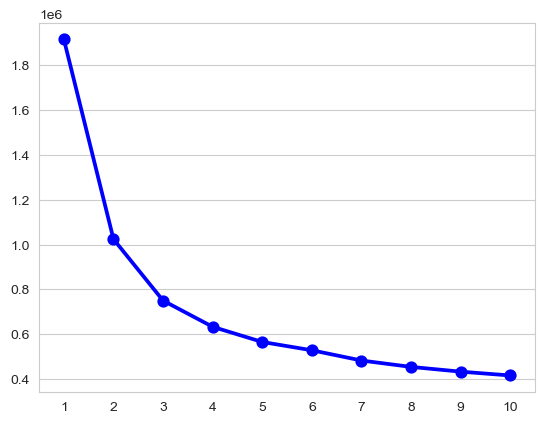

In [266]:
sns.pointplot(x=a,y=wss,color='blue')

In [267]:
from sklearn.metrics import silhouette_samples, silhouette_score

In [268]:
k_means1=KMeans(n_clusters=3,random_state=100)
k_means1.fit(inscost_clip)
labels1=k_means1.labels_

In [269]:
labels1

array([0, 0, 1, ..., 0, 2, 1])

In [270]:
print(silhouette_score(inscost_clip,labels1,random_state=100))

0.29967344819038316


In [271]:
k_means2=KMeans(n_clusters=4,random_state=100)
k_means2.fit(inscost_clip)
labels2=k_means2.labels_

In [272]:
print(silhouette_score(inscost_clip,labels2,random_state=100))

0.2480268845529709


In [273]:
k_means3=KMeans(n_clusters=2,random_state=100)
k_means3.fit(inscost_clip)
labels3=k_means3.labels_

In [274]:
print(silhouette_score(inscost_clip,labels3,random_state=100))

0.3894648923887689


In [275]:
inscost_clip['Cluster']=labels1

In [276]:
inscost_clip[inscost_clip['Cluster']==0].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
years_of_insurance_with_us,11235.0,4.05,2.63,0.00,2.00,4.00,6.00,8.00
regular_checkup_last_year,11235.0,0.78,1.21,0.00,0.00,0.00,1.00,5.00
visited_doctor_last_1_year,11235.0,3.10,1.14,0.00,2.00,3.00,4.00,10.00
daily_avg_steps,11235.0,-0.03,0.92,-2.33,-0.64,-0.12,0.49,2.18
age,11235.0,0.00,1.00,-1.80,-0.87,0.01,0.88,1.81
avg_glucose_level,11235.0,-0.02,1.00,-1.76,-0.89,-0.02,0.84,1.75
bmi,11235.0,32.90,2.82,28.50,30.50,32.60,35.10,38.80
weight,11235.0,-0.02,1.00,-2.10,-0.82,0.04,0.68,2.61
weight_change_in_last_one_year,11235.0,2.53,1.69,0.00,1.00,3.00,4.00,6.00
fat_percentage,11235.0,-0.01,1.00,-2.06,-0.91,0.02,0.83,1.53


In [277]:
inscost_clip[inscost_clip['Cluster']==1].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
years_of_insurance_with_us,3645.0,4.07,2.61,0.00,2.00,4.00,6.00,8.00
regular_checkup_last_year,3645.0,0.75,1.17,0.00,0.00,0.00,1.00,5.00
visited_doctor_last_1_year,3645.0,3.12,1.16,1.00,2.00,3.00,4.00,10.00
daily_avg_steps,3645.0,-0.03,0.92,-2.33,-0.63,-0.12,0.49,2.18
age,3645.0,-0.02,0.99,-1.80,-0.87,-0.06,0.81,1.81
avg_glucose_level,3645.0,-0.01,1.00,-1.76,-0.89,-0.02,0.85,1.75
bmi,3645.0,44.87,6.32,38.90,40.70,43.10,46.80,100.60
weight,3645.0,0.00,0.99,-2.10,-0.82,0.04,0.68,2.61
weight_change_in_last_one_year,3645.0,2.55,1.68,0.00,1.00,3.00,4.00,6.00
fat_percentage,3645.0,0.01,1.01,-2.06,-0.91,0.25,0.83,1.53


In [278]:
inscost_clip[inscost_clip['Cluster']==2].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
years_of_insurance_with_us,9130.0,4.13,2.58,0.00,2.00,4.00,6.00,8.00
regular_checkup_last_year,9130.0,0.78,1.20,0.00,0.00,0.00,1.00,5.00
visited_doctor_last_1_year,9130.0,3.11,1.14,1.00,2.00,3.00,4.00,12.00
daily_avg_steps,9130.0,-0.02,0.92,-2.33,-0.64,-0.12,0.49,2.18
age,9130.0,0.00,1.00,-1.80,-0.87,0.01,0.88,1.81
avg_glucose_level,9130.0,0.03,1.00,-1.76,-0.82,0.04,0.88,1.75
bmi,9130.0,24.16,3.12,12.30,22.00,24.70,26.80,28.50
weight,9130.0,0.02,1.00,-2.10,-0.82,0.04,0.79,2.61
weight_change_in_last_one_year,9130.0,2.49,1.69,0.00,1.00,3.00,4.00,6.00
fat_percentage,9130.0,0.01,1.00,-2.06,-0.79,0.25,0.83,1.53


In [279]:
inscost_clip.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
years_of_insurance_with_us,24010.0,4.09,2.61,0.00,2.00,4.00,6.00,8.00
regular_checkup_last_year,24010.0,0.77,1.20,0.00,0.00,0.00,1.00,5.00
visited_doctor_last_1_year,24010.0,3.11,1.14,0.00,2.00,3.00,4.00,12.00
daily_avg_steps,24010.0,-0.03,0.92,-2.33,-0.64,-0.12,0.49,2.18
age,24010.0,-0.00,1.00,-1.80,-0.87,0.01,0.88,1.81
avg_glucose_level,24010.0,-0.00,1.00,-1.76,-0.87,0.01,0.87,1.75
bmi,24010.0,31.39,7.88,12.30,26.10,30.50,35.60,100.60
weight,24010.0,0.00,1.00,-2.10,-0.82,0.04,0.68,2.61
weight_change_in_last_one_year,24010.0,2.52,1.69,0.00,1.00,3.00,4.00,6.00
fat_percentage,24010.0,0.00,1.00,-2.06,-0.91,0.25,0.83,1.53


In [280]:
inscost_cluster_eda=pd.DataFrame(inscost_ieda.copy())

In [284]:
inscost_cluster_eda['Cluster']=labels1

In [285]:
inscost_cluster_eda

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,avg_step_cat,weight_cat,fat_percentage_cat,insurance_cost_cat,insurance_cost,Cluster
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,Unknown,Chennai,67,N,Rare,Moderate,1,25,Lightly Active,Normal Weight,Moderate body fat,3rd Tier,20978,0
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,Active,Underweight,Moderate body fat,1st Tier,6170,0
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,Lightly Active,Overweight,High body fat,3rd Tier,28382,1
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,Unknown,Chennai,71,Y,Rare,No,3,37,Active,Overweight,High body fat,3rd Tier,27148,2
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,never smoked,Bangalore,74,N,No,Extreme,0,34,Lightly Active,Overweight,High body fat,3rd Tier,29616,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,5494,43,0,0,Female,73,Unknown,Mumbai,61,N,Rare,Moderate,5,36,Lightly Active,Normal Weight,High body fat,2nd Tier,13574,2
24995,3,0,0,Salaried,4,225 to 250,5614,22,0,0,Male,145,smokes,Kanpur,79,Y,Rare,Moderate,4,40,Lightly Active,Overweight,High body fat,4th Tier,39488,0
24996,6,0,0,Business,4,200 to 225,4719,58,0,0,Male,134,never smoked,Kanpur,66,N,Rare,Moderate,2,28,Lightly Active,Normal Weight,Moderate body fat,2nd Tier,14808,0
24998,1,0,0,Salaried,2,225 to 250,10777,27,0,0,Male,66,Unknown,Surat,74,N,Rare,Moderate,0,40,Very Active,Overweight,High body fat,4th Tier,30850,2


In [286]:
inscost_cluster_eda['Cluster'].value_counts()

0    11235
2     9130
1     3645
Name: Cluster, dtype: int64

In [287]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==0][num].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,11235.0,5211.28,1045.54,2034.0,4540.0,5090.0,5727.5,11063.0
age,11235.0,44.97,16.09,16.0,31.0,45.0,59.0,74.0
avg_glucose_level,11235.0,166.38,62.70,57.0,112.0,166.0,220.0,277.0
weight,11235.0,71.45,9.33,52.0,64.0,72.0,78.0,96.0
fat_percentage,11235.0,28.70,8.61,11.0,21.0,29.0,36.0,42.0
insurance_cost,11235.0,26921.85,14342.61,2468.0,14808.0,27148.0,37020.0,67870.0


In [288]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==1][num].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,3645.0,5211.81,1047.73,2400.0,4553.0,5092.0,5732.0,9968.0
age,3645.0,44.60,15.96,16.0,31.0,44.0,58.0,74.0
avg_glucose_level,3645.0,166.84,63.00,57.0,112.0,166.0,221.0,277.0
weight,3645.0,71.66,9.27,52.0,64.0,72.0,78.0,96.0
fat_percentage,3645.0,28.89,8.69,11.0,21.0,31.0,36.0,42.0
insurance_cost,3645.0,27176.10,14267.27,2468.0,16042.0,27148.0,37020.0,67870.0


In [289]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==2][num].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,9130.0,5223.12,1065.71,2138.0,4545.0,5086.0,5734.0,11255.0
age,9130.0,44.98,16.14,16.0,31.0,45.0,59.0,74.0
avg_glucose_level,9130.0,169.23,62.62,57.0,116.0,170.0,223.0,277.0
weight,9130.0,71.82,9.36,52.0,64.0,72.0,79.0,96.0
fat_percentage,9130.0,28.95,8.64,11.0,22.0,31.0,36.0,42.0
insurance_cost,9130.0,27448.32,14341.04,2468.0,16042.0,27148.0,37020.0,67870.0


In [290]:
inscost_cluster_eda[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']]=inscost_cluster_eda[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']].astype('object')

In [291]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==0].describe(include='object').T

,count,unique,top,freq
years_of_insurance_with_us,11235,9,0,1365
regular_checkup_last_year,11235,6,0,6876
adventure_sports,11235,2,0,10332
Occupation,11235,3,Student,4601
visited_doctor_last_1_year,11235,5,2,3887
cholesterol_level,11235,5,150 to 175,3959
heart_decs_history,11235,2,0,10429
other_major_decs_history,11235,2,0,9940
Gender,11235,2,Male,8824
smoking_status,11235,4,never smoked,4650


In [292]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==1].describe(include='object').T

,count,unique,top,freq
years_of_insurance_with_us,3645,9,3,453
regular_checkup_last_year,3645,6,0,2224
adventure_sports,3645,2,0,3338
Occupation,3645,3,Student,1509
visited_doctor_last_1_year,3645,5,2,1257
cholesterol_level,3645,5,125 to 150,1265
heart_decs_history,3645,2,0,3499
other_major_decs_history,3645,2,0,3072
Gender,3645,2,Male,2882
smoking_status,3645,4,never smoked,1535


In [293]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==2].describe(include='object').T

,count,unique,top,freq
years_of_insurance_with_us,9130,9,3,1102
regular_checkup_last_year,9130,6,0,5521
adventure_sports,9130,2,0,8373
Occupation,9130,3,Business,3748
visited_doctor_last_1_year,9130,5,2,3178
cholesterol_level,9130,5,150 to 175,3211
heart_decs_history,9130,2,0,8876
other_major_decs_history,9130,2,0,8776
Gender,9130,2,Female,5147
smoking_status,9130,4,Unknown,4172


## Advanced EDA based on clusters

In [294]:
inscost_cluster_eda.columns

Index(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history', 'Gender', 'avg_glucose_level',
       'smoking_status', 'Location', 'weight', 'covered_by_any_other_company',
       'Alcohol', 'exercise', 'weight_change_in_last_one_year',
       'fat_percentage', 'avg_step_cat', 'weight_cat', 'fat_percentage_cat',
       'insurance_cost_cat', 'insurance_cost', 'Cluster'],
      dtype='object')

<AxesSubplot:xlabel='Cluster', ylabel='insurance_cost'>

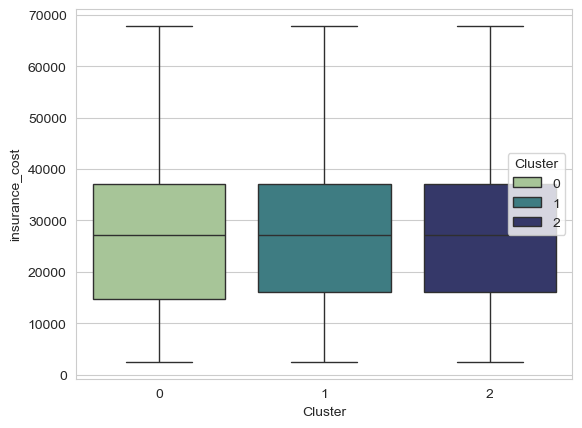

In [298]:
sns.boxplot(x=inscost_cluster_eda['Cluster'],y=inscost_cluster_eda['insurance_cost'],hue=inscost_cluster_eda['Cluster'],palette='crest')

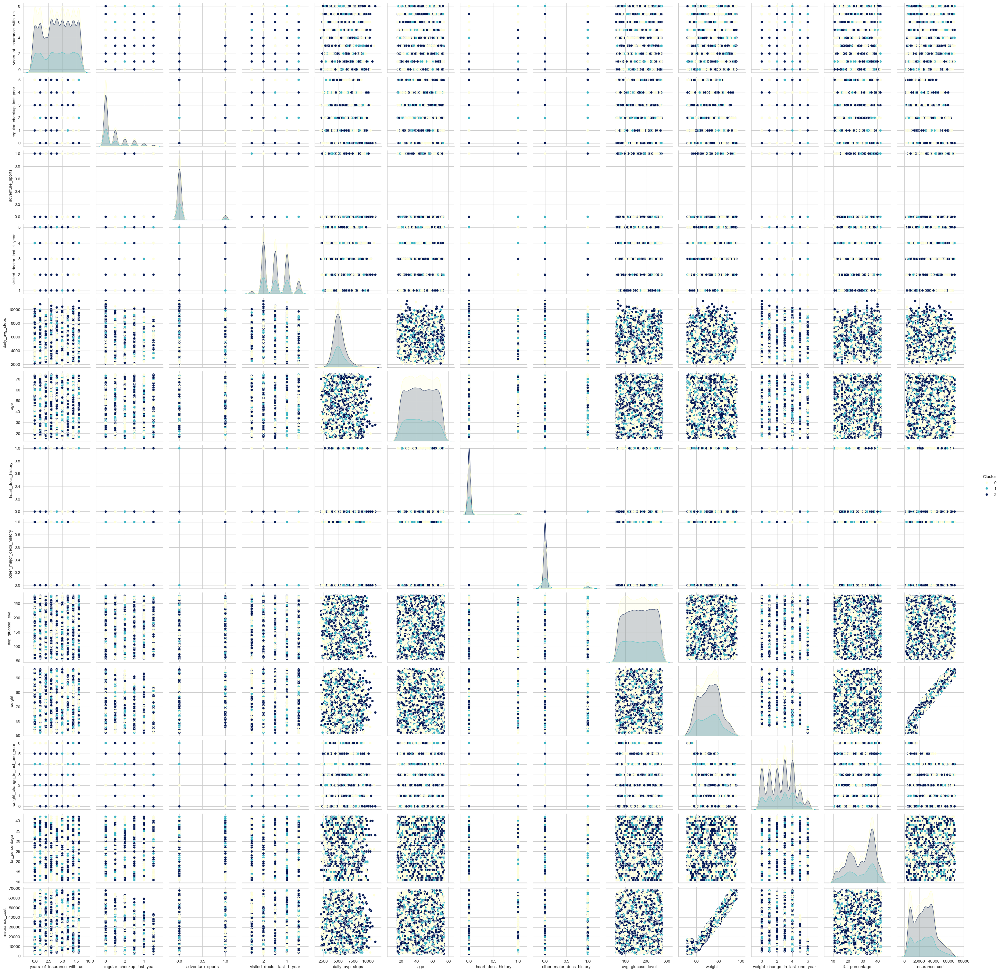

In [300]:
sns.pairplot(data=inscost_cluster_eda,hue='Cluster',palette='YlGnBu')

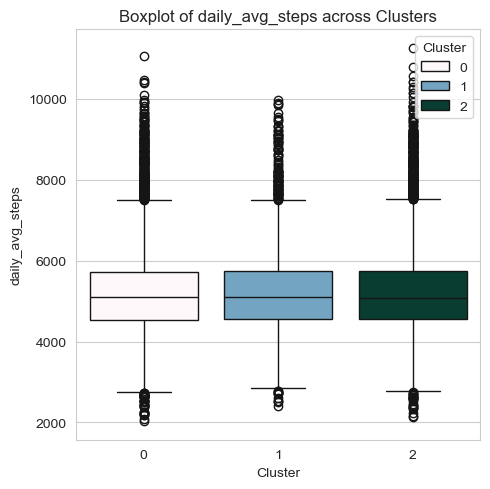

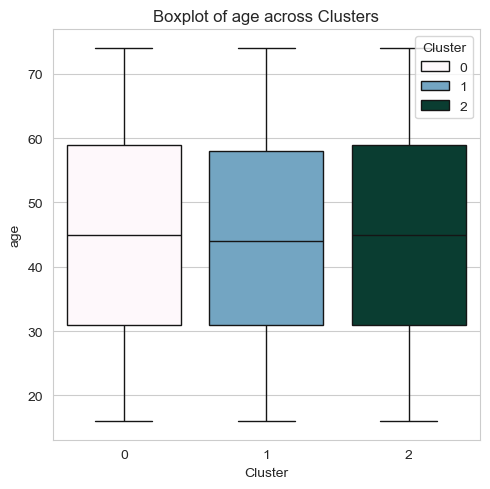

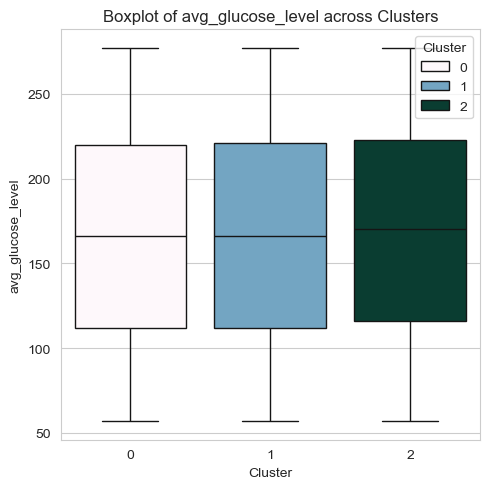

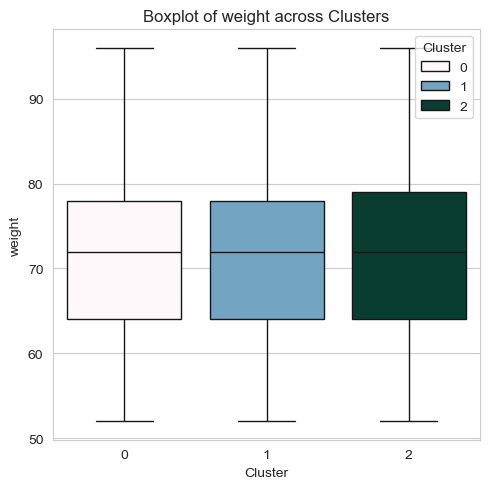

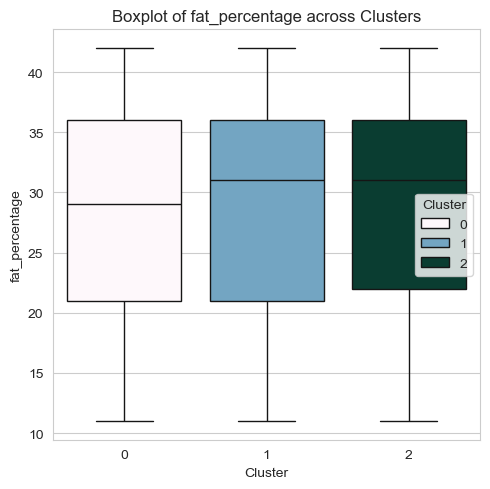

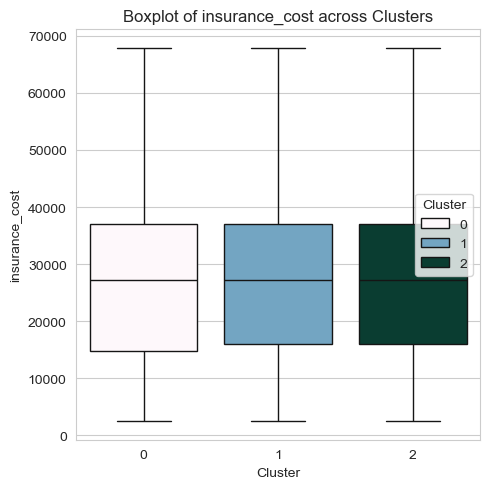

In [321]:
for i in inscost_cluster_eda[num]:
    plt.figure(figsize=(5,5)) 
    sns.boxplot(data=inscost_cluster_eda, x='Cluster', y=i, hue='Cluster', palette='PuBuGn')
    plt.title(f'Boxplot of {i} across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(i)
    plt.tight_layout()

# Show the plots
plt.show()

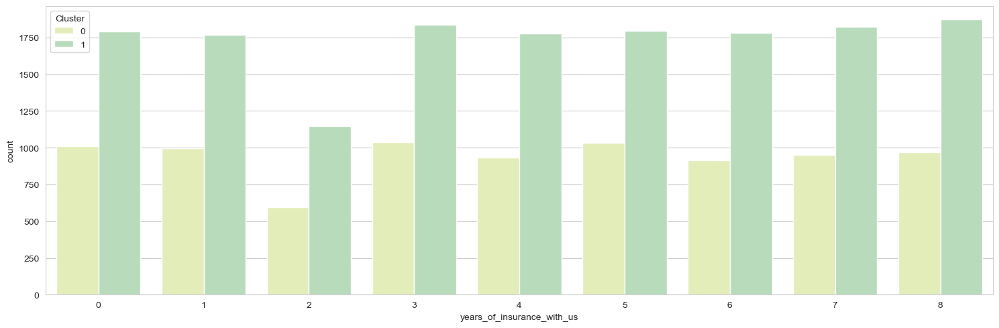

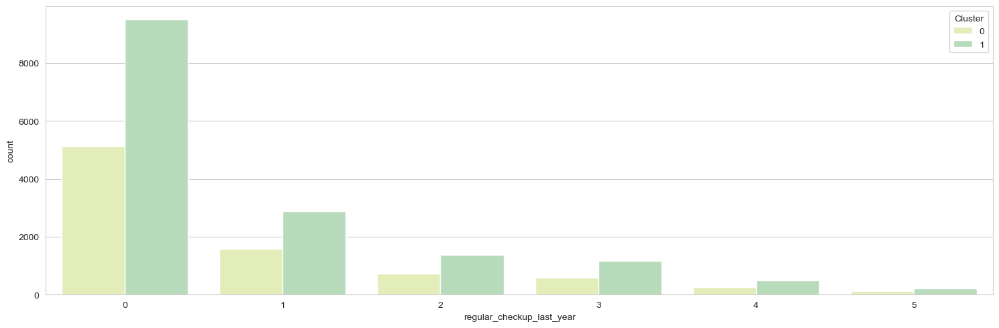

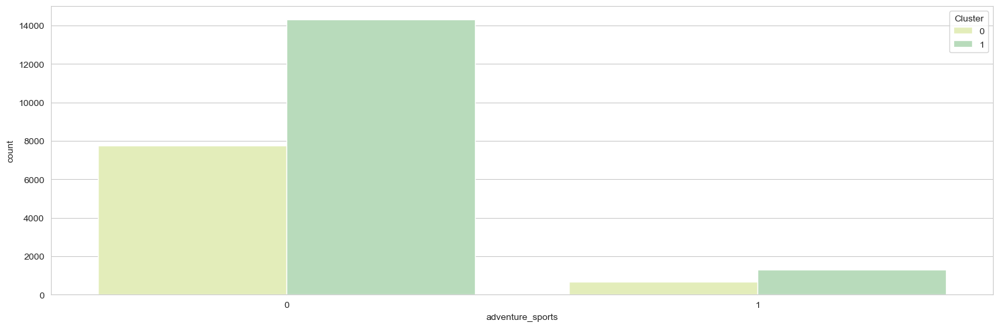

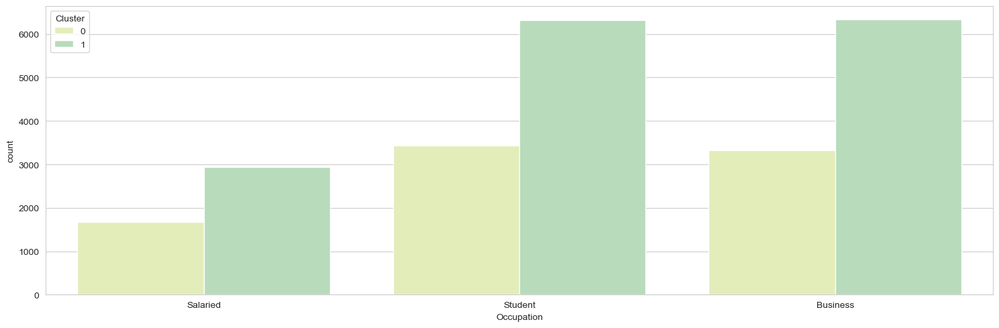

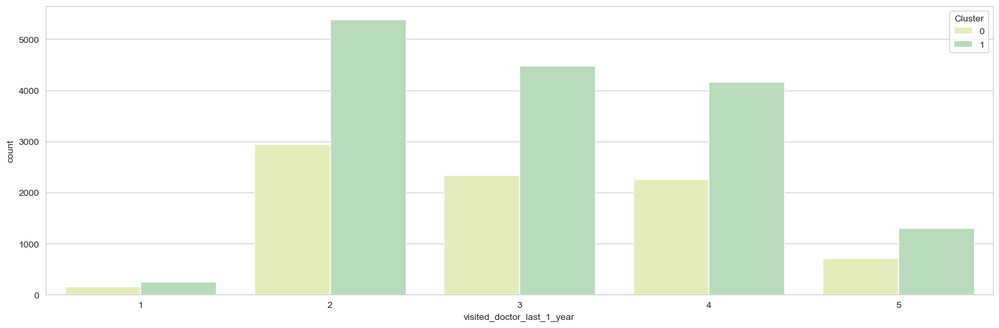

...

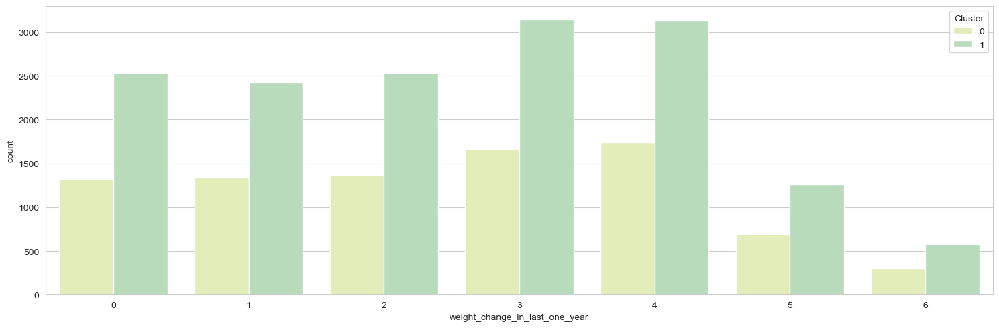

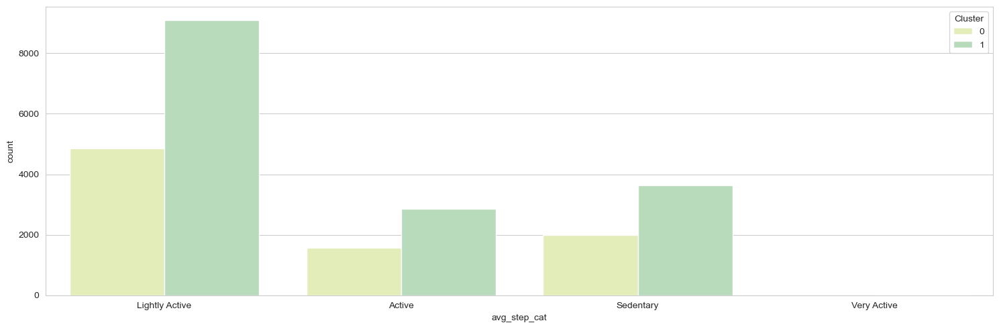

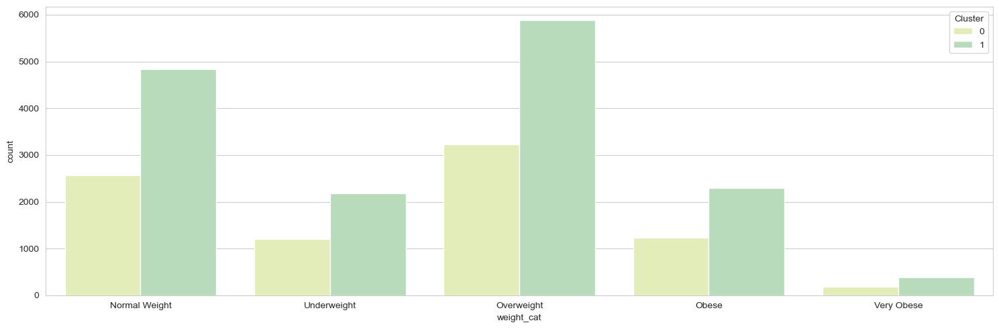

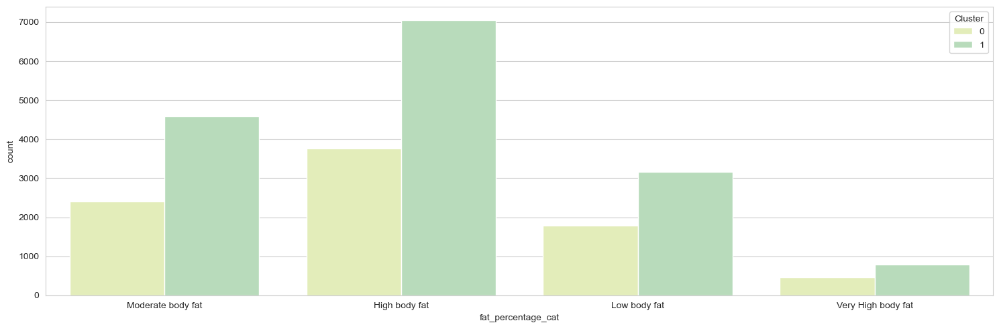

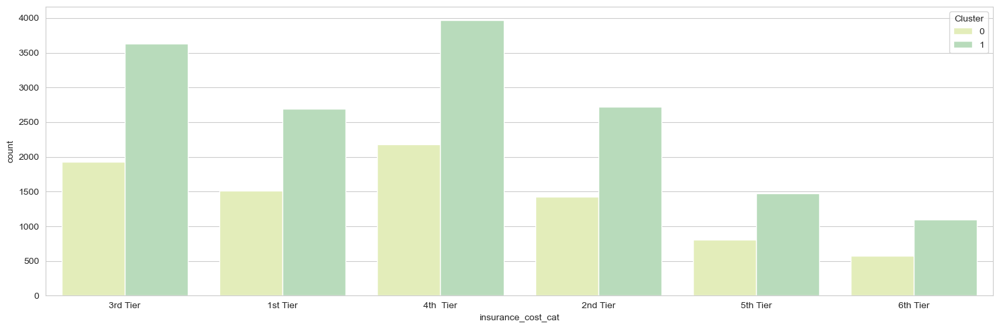

In [158]:
for i in inscost_cluster_eda[cat]:
    plt.figure(figsize=(15,5))
    sns.countplot(x=inscost_cluster_eda[i],hue=inscost_cluster_eda['Cluster'])
    plt.tight_layout();

In [159]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==0][num].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,8427.0,5214.89,1049.22,2034.0,4542.0,5098.0,5732.0,11063.0
age,8427.0,44.61,16.09,16.0,31.0,44.0,58.0,74.0
avg_glucose_level,8427.0,165.70,63.27,57.0,110.0,164.0,221.0,277.0
weight,8427.0,71.59,9.32,52.0,64.0,72.0,78.0,96.0
fat_percentage,8427.0,28.79,8.66,11.0,21.0,31.0,36.0,42.0
insurance_cost,8427.0,27115.05,14338.64,2468.0,16042.0,27148.0,37020.0,67870.0


In [160]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==1][num].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,15583.0,5216.39,1055.93,2091.0,4544.0,5086.0,5729.0,11255.0
age,15583.0,45.08,16.09,16.0,31.0,45.0,59.0,74.0
avg_glucose_level,15583.0,168.53,62.41,57.0,115.0,169.0,222.0,277.0
weight,15583.0,71.63,9.34,52.0,64.0,72.0,78.0,96.0
fat_percentage,15583.0,28.84,8.62,11.0,22.0,31.0,36.0,42.0
insurance_cost,15583.0,27185.30,14328.87,2468.0,16042.0,27148.0,37020.0,67870.0


In [161]:
inscost_cluster_eda[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']]=inscost_cluster_eda[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']].astype('object')

In [162]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==0].describe(include='object').T

,count,unique,top,freq
years_of_insurance_with_us,8427,9,3,1037
regular_checkup_last_year,8427,6,0,5133
adventure_sports,8427,2,0,7747
Occupation,8427,3,Student,3434
visited_doctor_last_1_year,8427,5,2,2943
cholesterol_level,8427,5,150 to 175,2908
heart_decs_history,8427,2,0,7924
other_major_decs_history,8427,2,0,7196
Gender,8427,2,Male,6755
smoking_status,8427,4,never smoked,3460


In [163]:
inscost_cluster_eda[inscost_cluster_eda['Cluster']==1].describe(include='object').T

,count,unique,top,freq
years_of_insurance_with_us,15583,9,8,1870
regular_checkup_last_year,15583,6,0,9488
adventure_sports,15583,2,0,14296
Occupation,15583,3,Business,6328
visited_doctor_last_1_year,15583,5,2,5379
cholesterol_level,15583,5,150 to 175,5488
heart_decs_history,15583,2,0,14880
other_major_decs_history,15583,2,0,14592
Gender,15583,2,Male,8934
smoking_status,15583,4,never smoked,5592


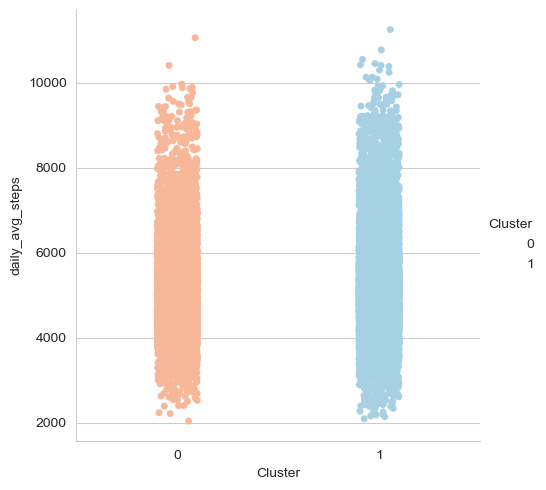

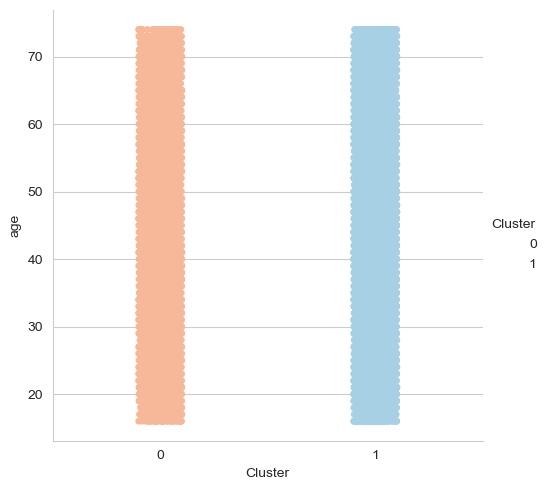

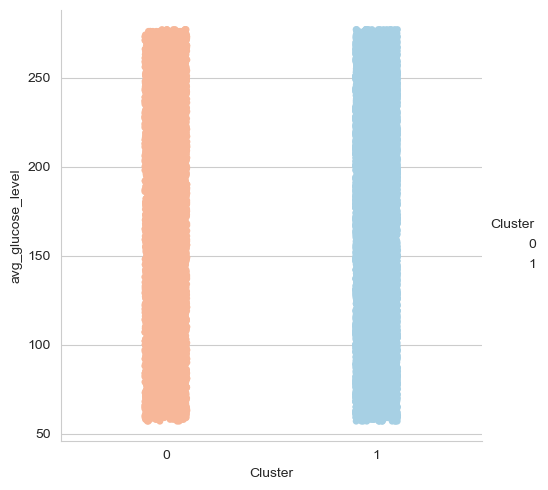

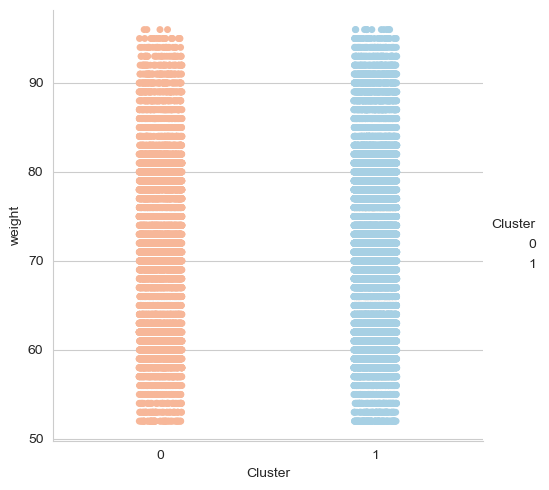

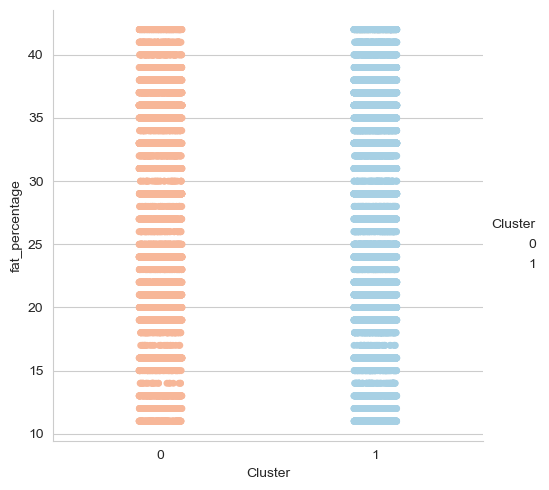

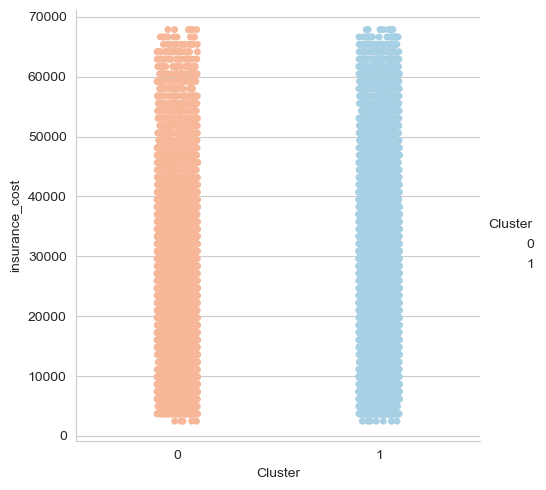

In [166]:
for i in inscost_cluster_eda[num]:
    sns.catplot(data=inscost_cluster_eda,x='Cluster',y=i,palette='RdBu')
    plt.show();

In [ ]:
for i in inscost_cluster_eda[num]:
    sns.swarmplot(data=inscost_cluster_eda,x='Cluster',y=i,palette='RdBu')
    plt.show();